In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
import numpy as np
import seaborn as sns
from scipy import stats
import pathlib, os
from math import isnan
from functools import partial
from scipy.stats import rankdata
import warnings
warnings.filterwarnings('ignore')

# Read in survey data and summarize

In [2]:
# Read in anonymized survey data
survey = pd.read_csv('./data/survey.csv', index_col='Participant_ID')

# total number of people in the study
all_n = len(survey)

print('Number of participants:\t\t', all_n)
print('Number who provided a resume:\t', sum(survey.resume))
print('Number who provided a LinkedIn:\t', sum(survey.linkedin))
print('Number who provided a Twitter:\t', sum(survey.twitter))


# print gender summary
gen = survey['gender'].value_counts(dropna=False, normalize=False)
gen_df = pd.DataFrame({'group':gen.index, 
                       'n':gen,
                       'percent':round(100*(gen/all_n))})
display(gen_df)

# print race summary
race = survey['race'].value_counts(dropna=False, normalize=False)
race_df = pd.DataFrame({'group':race.index, 
                       'n':race,
                       'percent':round(100*(race/all_n))})
display(race_df)

# print birth country summary
country = survey['birth_country'].value_counts(dropna=False, normalize=False)
country_df = pd.DataFrame({'group':country.index, 
                       'n':country,
                       'percent':round(100*(country/all_n))})
display(country_df)

# print primary language summary
lang = survey['primary_language'].value_counts(dropna=False, normalize=False)
lang_df = pd.DataFrame({'group':lang.index, 
                       'n':lang,
                       'percent':round(100*(lang/all_n))})
display(lang_df)

Number of participants:		 94
Number who provided a resume:	 89
Number who provided a LinkedIn:	 92
Number who provided a Twitter:	 32


,group,n,percent
Male,Male,56,60.0
Female,Female,36,38.0
Other Gender,Other Gender,2,2.0


,group,n,percent
Asian,Asian,57,61.0
White,White,24,26.0
Other Race,Other Race,12,13.0
NaN,NaN,1,1.0


,group,n,percent
India,India,34,36.0
USA,USA,28,30.0
Other Country,Other Country,18,19.0
China,China,12,13.0
NaN,NaN,2,2.0


,group,n,percent
English,English,60,64.0
Other Language,Other Language,34,36.0


# Read in Humantic and Crystal data and count each the inputs and outputs for each run

In [3]:
# Map unique run codes to descriptive names
hum_run_dict = {'HRo1': 'Original Resume', 
                'HRi1': 'De-Identified Resume', 
                'HRi2': 'De-Identified Resume', 
                'HRi3': 'De-Identified REsume', 
                'HRd1': 'DOCX Resume', 
                'HRu1': 'URL-Embedded Resume', 
                'HL1': 'LinkedIn', 
                'HL2': 'LinkedIn', 
                'HT1': 'Twitter', 
                'HT2': 'Twitter'}
crystal_run_dict = {'CRr1': 'Raw Text Resume',
                    'CRr2': 'Raw Text Resume',
                    'CRr3': 'Raw Text Resume',
                    'CRp1': 'PDF Resume',
                    'CL1': 'LinkedIn',
                    'CL2': 'LinkedIn'}

# combine into single dictionary for both tools
run_dict = {**hum_run_dict, **crystal_run_dict}

# Save lists of run codes
hum_run_names = list(hum_run_dict.keys())
crystal_run_names = list(crystal_run_dict.keys())

# Initialize dictionary to hold all Crystal and Humantic data
data = {}

# Read in Humantic and Crystal score data
for name in hum_run_names + crystal_run_names:
    
    # Read from CSV in data folder
    run_scores = pd.read_csv('./data/{}.csv'.format(name), index_col='Participant_ID')
    
    # Print number of inputs submitted and number of outputs produced for each run
    print('{}\tinput: {}\toutput: {}'.format(name, len(run_scores), sum(run_scores['output_success'])))
    # Add space to separate Humantic and Crystal runs
    if name == hum_run_names[-1]:
        print('\n')
        
    # Save the rows with successful output
    data[name] = run_scores[run_scores.output_success]


HRo1	input: 89	output: 88
HRi1	input: 89	output: 89
HRi2	input: 89	output: 89
HRi3	input: 89	output: 89
HRd1	input: 89	output: 89
HRu1	input: 86	output: 86
HL1	input: 92	output: 88
HL2	input: 92	output: 91
HT1	input: 32	output: 21
HT2	input: 32	output: 21


CRr1	input: 89	output: 89
CRr2	input: 89	output: 89
CRr3	input: 89	output: 89
CRp1	input: 89	output: 89
CL1	input: 92	output: 91
CL2	input: 89	output: 89


# Calculate Stability Metrics and Produce Scatterplots

In [4]:
# List of demographic columns
dem_cols = ['gender', 'primary_language']

# List of Humantic AI's "General Traits"
gen_traits = ['Attitude and Outlook', 'Need for Autonomy', 'Teamwork Skills', 
              'General Behavior', 'Action Orientedness', 
              'Stability Potential', 'Learning Ability']

# List of Big Five traits (also called OCEAN for its acronym)
ocean_traits = ['Openness', 'Big Five Conscientiousness', 
                'Extraversion', 'Agreeableness', 'Emotional Stability']

# Lists of DiSC traits ('C' named differently for the different tools)
disc_traits_humantic = ['Dominance', 'Influence', 'Steadiness', 'DiSC Calculativeness']
disc_traits_crystal = ['Dominance', 'Influence', 'Steadiness', 'Conscientiousness']
disc_traits = [disc_traits_humantic, disc_traits_crystal]

# Confidence Score column
conf = ['Confidence Score']

# List of "score" columns from Humantic
score_cols = conf + ['Match Score']

# List of lists of all Humantic traits, by group
humantic_all_traits = [disc_traits_humantic, ocean_traits]#, gen_traits, conf]

# 1-D list of all Humantic traits
humantic_all_traits_simple = [item for sublist in humantic_all_traits for item in sublist]

# List of list of all Crystal traits, by (singular) group
crystal_all_traits = [disc_traits_crystal]

# 1-D list of all Crystal traits
crystal_all_traits_simple = [item for sublist in crystal_all_traits for item in sublist]

In [5]:
def stability_analysis(treat_code, ctrl_code, treat_label=None, ctrl_label=None):
    '''
    This function prints takes in the codes for a single stability experiment,
    plots correlations for each predicted personality trait, and 
    returns nested dictory of stability metric.
    
    Arguments
    
        treat_code (str)     :  Code of "treatment" run (e.g., "CL1" or "HRi3").
                                Will be used to look up treatment run scores in data.
                                
        ctrl_code (str)      :  Code of "control" run (e.g., "CL1" or "HRi3").
                                Will be used to look up control run scores in data.
                                
        treat_label (str)    :  Name of "treatment" trial (e.g., "De-Identified Resume" or "LinkedIn later").
                                By default will use treat_code to look up label in run_dict.
                                
        ctrl_label (str)     :  Name of "control" trial (e.g., "De-Identified Resume" or "LinkedIn later").
                                By default will use ctrl_code to look up label in run_dict.

    '''
    
    # set tool based on first letter of treat and control codes
    if treat_code[0]=='C':
        # All codes for Crystal runs begin with "C"
        tool='crystal'
        assert ctrl_code[0]=='C', 'Treatment and control must be from the same system'

        # Get list of Crystal personality traits
        all_traits = crystal_all_traits
        all_traits_simple = crystal_all_traits_simple
        
        # Set max score (for L1 constant)
        score_max = 50 # necessary to get normalizing constant of 1/200 for Crystal DiSC
        
    elif treat_code[0]=='H':
        # All codes for Humantic runs begin with "H"
        tool='humantic'
        assert ctrl_code[0]=='H', 'Treatment and control must be from the same system'
        
        # Get list of Humantic personality traits
        all_traits = humantic_all_traits
        all_traits_simple = humantic_all_traits_simple
        
        # Set max score (for L1 constant)
        score_max = 10 # Humantic DiSC and Big Five both on a scale of 0-10
    else:
        raise ValueError('Invalid run code.')
        
    # Set treatment and control dataframes
    treat_df = data[treat_code]
    ctrl_df = data[ctrl_code]
    
    # Set run labels if not explicitly passed as arguments
    if type(treat_label)==type(None):
        treat_label = run_dict[treat_code]
    if type(ctrl_label)==type(None):
        ctrl_label = run_dict[ctrl_code]

    # Limit rows to the Participant IDs found in both runs
    exp_ids = set(treat_df.index) & set(ctrl_df.index)
    treat_df = treat_df.loc[exp_ids]
    ctrl_df = ctrl_df.loc[exp_ids]
    
    # Merge in survey data
    treat_df = treat_df.merge(survey, how='left', left_index=True, right_index=True)
    ctrl_df = ctrl_df.merge(survey, how='left', left_index=True, right_index=True)

    # Initialize dictionary to hold results
    results = {}
    
    # Save number of participants in experiment
    results['N'] = len(exp_ids)
    
    # Save treatment and control labels
    results['treatment_run'] = treat_label
    results['control_run'] = ctrl_label
        
    # Save overall medians for treatment/control for each trait
    results['median_control'] = list(ctrl_df[all_traits_simple].median().values)
    results['median_treatment'] = list(treat_df[all_traits_simple].median().values)
    
    # Save subgroup medians
    for dem in dem_cols: # Loop through demographic categories (gender, primary language)
        for dem_group in treat_df[dem].unique(): # Loop through values of category (e.g. Male, Female)
            if type(dem_group)==type(np.nan):
                # Skip those who did not provide answer
                continue
            if dem_group == "Other Gender": 
                # Skip NB gender (only 2 respondents in this group)
                continue
                
            # subgroup specific treatment & control dataframes
            ctrl_dem = ctrl_df[ctrl_df[dem]==dem_group]
            treat_dem = treat_df[treat_df[dem]==dem_group]
            
            # get subgroup medians
            results['median_control_'+dem_group] = list(ctrl_dem[all_traits_simple].median().values)
            results['median_treatment_'+dem_group] = list(treat_dem[all_traits_simple].median().values)

    # Keep demographic variables for subgroup L1 plotting outside of this function
    results['gender'] = treat_df.gender.values
    results['lang'] = treat_df.primary_language.values

    # Initialize lists to hold overall stability metrics
    results['W'] = []
    results['p'] = []
    results['L1'] = []
    results['corr'] = []
    
    # Initialize lists to hold subgroup correlations
    for dem in dem_cols: # Loop through demographic categories (gender, primary language)
        for dem_group in treat_df[dem].unique(): # Loop through values of category (e.g. Male, Female)
            if type(dem_group)==type(np.nan):
                # Skip those who did not provide answer
                continue
            if dem_group == "Other Gender": 
                # Skip NB gender (only 2 respondents in this group)
                continue
            results['corr_'+dem_group] = []
            results['W_'+dem_group] = []
            results['p_'+dem_group] = []
    
    # Plot settings
    ctrl_color = 'royalblue'
    treat_color = 'darkorange'
    change_color = 'green'
    bar_color = 'mediumseagreen'
    facecolor='white'
    alpha = 0.3
    bins = int(len(treat_df)/4)

    # Loop through trait groups (eg. DISC or Big Five)
    for group in all_traits:
        
        # Initialize participant L1 distances for given trait group at 0
        L1 = np.zeros(len(treat_df))
        
        # Set figure size and background color for correlation scatter plots
        if group in disc_traits:
            plt.figure(figsize=(12,12), facecolor=facecolor, dpi=300)
        else:
            plt.figure(figsize=(18,18), facecolor=facecolor, dpi=300)
            
        # Use Times New Roman font in plot
        plt.rc('font', family='Times New Roman')

        # Loop through traits in group (eg. D, I, S, and C)
        for i, trait in enumerate(group):

            # Set subplot
            if group in disc_traits:
                plt.subplot(2,2, i+1)
            else:
                plt.subplot(3,3, i+1)
                
            # Set axis limits based on tool output scale
            if tool=='humantic':
                plt.xlim(0,10.1)
                plt.ylim(0,10.1)
                plt.plot(np.linspace(0, 10.1, 10), 
                         np.linspace(0, 10.1, 10), 
                      color = 'red', alpha=0.5, label='Y=X')

            elif tool=='crystal':
                # Set axis limits
                plt.xlim(-0.1,100.1)
                plt.ylim(-0.1,100.1)

                # Plot Y=X line for reference
                plt.plot(np.linspace(-0.1, 100.1, 10), 
                         np.linspace(-0.1, 100.1, 10), 
                      color = 'red', alpha=0.5, label='Y=X')
                
            # Calculate absolute value of change across facet
            diff = np.abs(treat_df[trait]-ctrl_df[trait])
            
            # Add absolute changes to L1 distance
            L1 = L1 + diff/score_max
            
            # Wilcoxon hypothesis testing
            if(all(np.isclose(diff,0))):
                # Cannot perform Wilcoxon test if treatment and control are uniformly identical
                print("All differences are 0 for {}. Did not perform Wilcoxon signed rank test.".format(trait))
                results['W'].append(np.nan)
                results['p'].append(np.nan)
            else:
                # Two sided test Wilcoxon signed rank test
                # Look at paired differences between treatment and control
                # Test whether median difference is significantly different than zero
                W, p = stats.wilcoxon(x=ctrl_df[trait], y=treat_df[trait])
                results['W'].append(W)
                results['p'].append(p)

            # Calculate Spearman's correlation coefficient and save to results
            r = stats.spearmanr(treat_df[trait], ctrl_df[trait])[0]
            results['corr'].append(r)

            # Demographic subgroup results
            for dem in dem_cols: # Loop through demographic categories (race, gender, etc.)
                for dem_group in treat_df[dem].unique(): # Loop through values of category (e.g. Male, Female)
                    if type(dem_group)==type(np.nan):
                        # Skip those who did not provide answer
                        continue
                    if dem_group == "Other Gender": 
                        # Skip NB gender (only 2 respondents in this group)
                        continue
                        
                    # Create demographic subsets of treatment and control run dataframes
                    treat_dem = treat_df[treat_df[dem]==dem_group]
                    ctrl_dem = ctrl_df[ctrl_df[dem]==dem_group]
                    
                    # Calculate and save correlation within subgroup
                    r_dem = stats.spearmanr(treat_dem[trait], ctrl_dem[trait])[0]
                    results['corr_'+dem_group].append(r_dem)
                    
                    # Wilcoxon hypothesis testing for subgroup
                    if(all(np.isclose(np.abs(treat_dem[trait]-ctrl_dem[trait]),0))):
                        # Cannot perform Wilcoxon test if treatment and control are uniformly identical
                        print("All differences are 0 for {} within {}. Did not perform Wilcoxon signed rank test."\
                              .format(trait, dem_group))
                        results['W_'+dem_group].append(np.nan)
                        results['p_'+dem_group].append(np.nan)
                    else:
                        W_dem, p_dem = stats.wilcoxon(x=ctrl_dem[trait], y=treat_dem[trait])
                        results['W_'+dem_group].append(W_dem)
                        results['p_'+dem_group].append(p_dem)
            
            # Scatterplot of individuals' scores, use correlation as label
            plt.scatter(x=ctrl_df[trait], y=treat_df[trait], 
                        color=change_color, s=8, alpha=0.75, 
                        label='{} participants\n(r = {:.4f})'\
                        .format(len(treat_df[trait]), r))
                    
            # Add title, label axes, and add legend for each trait
            plt.title(trait, fontsize=18)
            plt.xlabel(ctrl_label, fontsize=16)
            plt.ylabel(treat_label, fontsize=16, labelpad=0)
            plt.legend(frameon = True, fontsize=14, framealpha = 0.75, markerscale=3)
            plt.tick_params(axis='both', labelsize=14)
                
        # Save L1 distances for group of traits (divide by number of traits in group)
        results['L1'].append(L1/len(group))
            
        # Add space between subplots
        plt.subplots_adjust(hspace=0.33)
        plt.subplots_adjust(wspace=0.33)
            
        plt.show()
    
    return results

In [6]:
# Initialize dictionaries to hold all results
h_results = {}
c_results = {}

## File Format Experiments

### Crystal: Raw Text Resume vs. PDF Resume

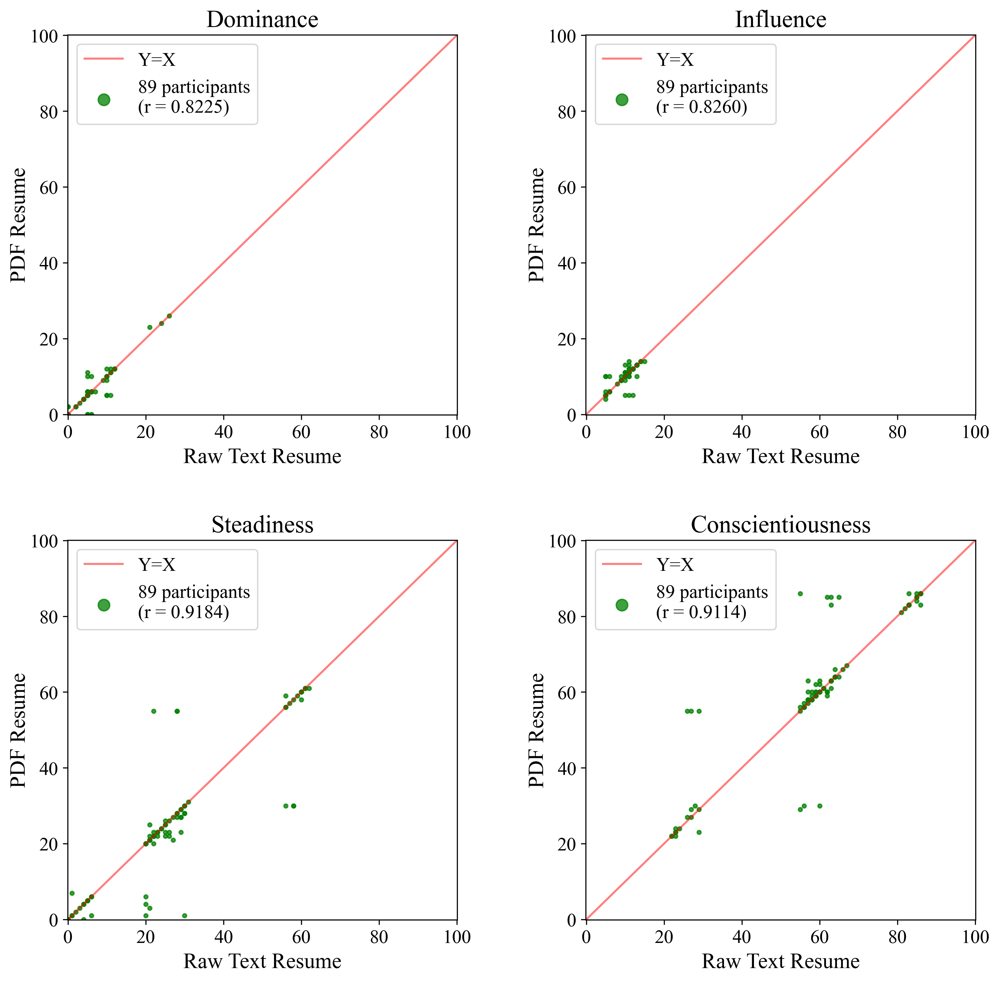

In [7]:
exp_name = 'File Format: Raw Text Resume vs. PDF Resume'
c_results[exp_name] = stability_analysis(treat_code = 'CRp1', ctrl_code = 'CRr1')

### Humantic: De-Identified Resume vs. DOCX Resume

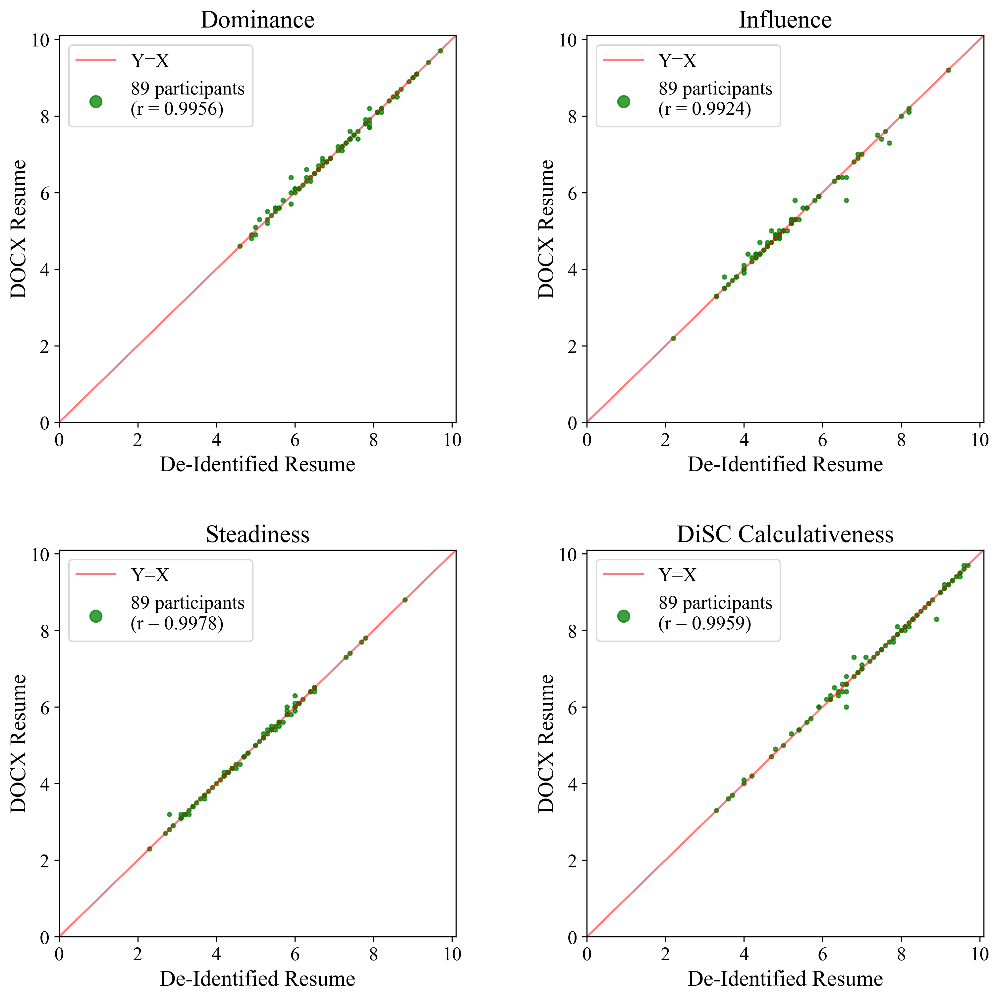

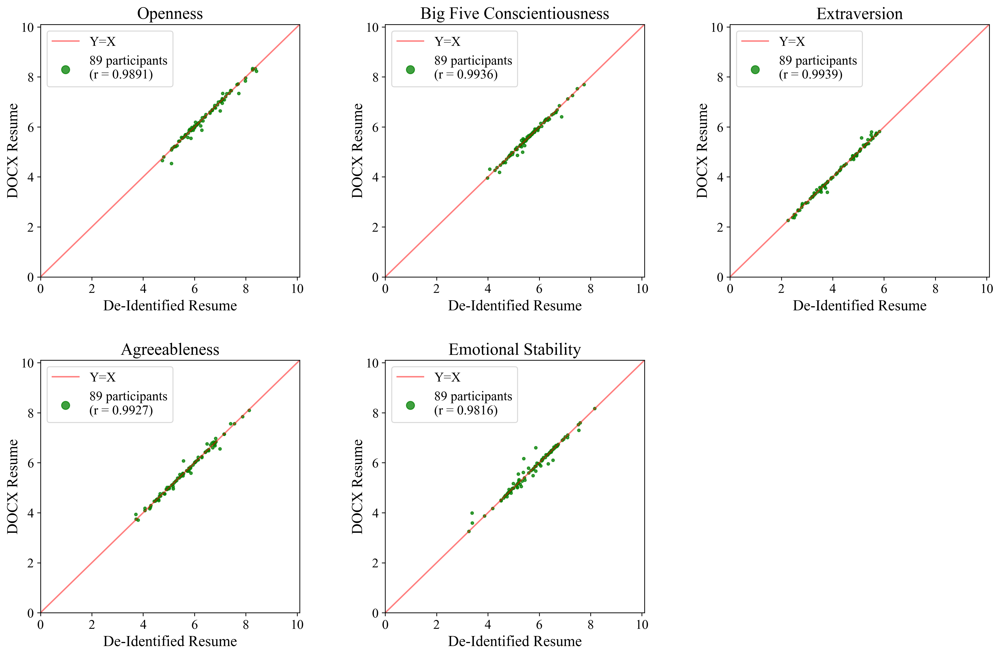

In [8]:
exp_name = 'File Format: De-Identified Resume vs. DOCX Resume'
h_results[exp_name] = stability_analysis(treat_code = 'HRd1', ctrl_code = 'HRi1')

## URL-Embedding Experiment

### Humantic: De-Identified Resume vs. URL-Embedded Resume

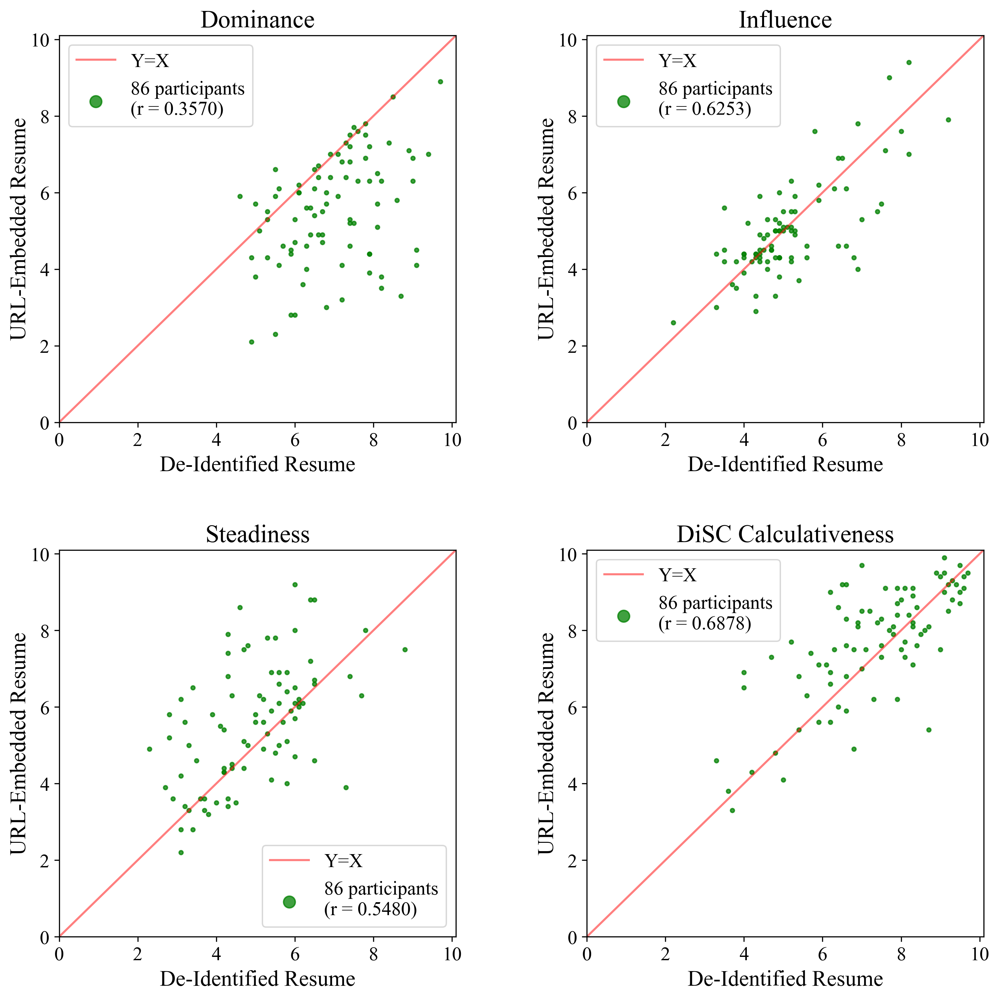

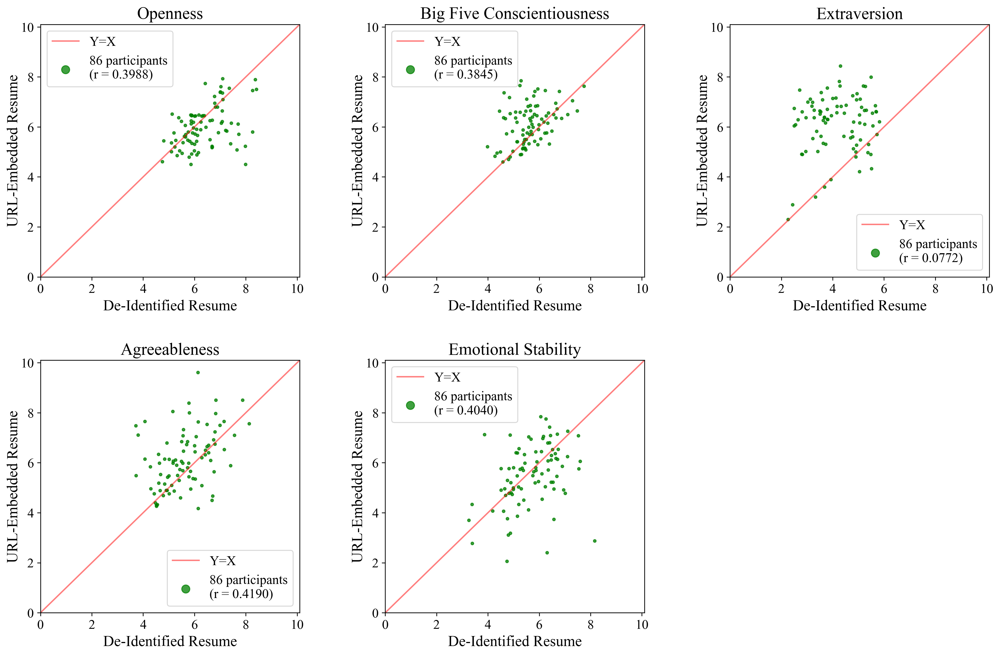

In [9]:
exp_name = 'URL Embedding: URL-Embedded Resume vs. De-Identified Resume'
h_results[exp_name] = stability_analysis(treat_code = 'HRu1', ctrl_code = 'HRi1')

### Humantic: URL-Embedded Resume vs. LinkedIn

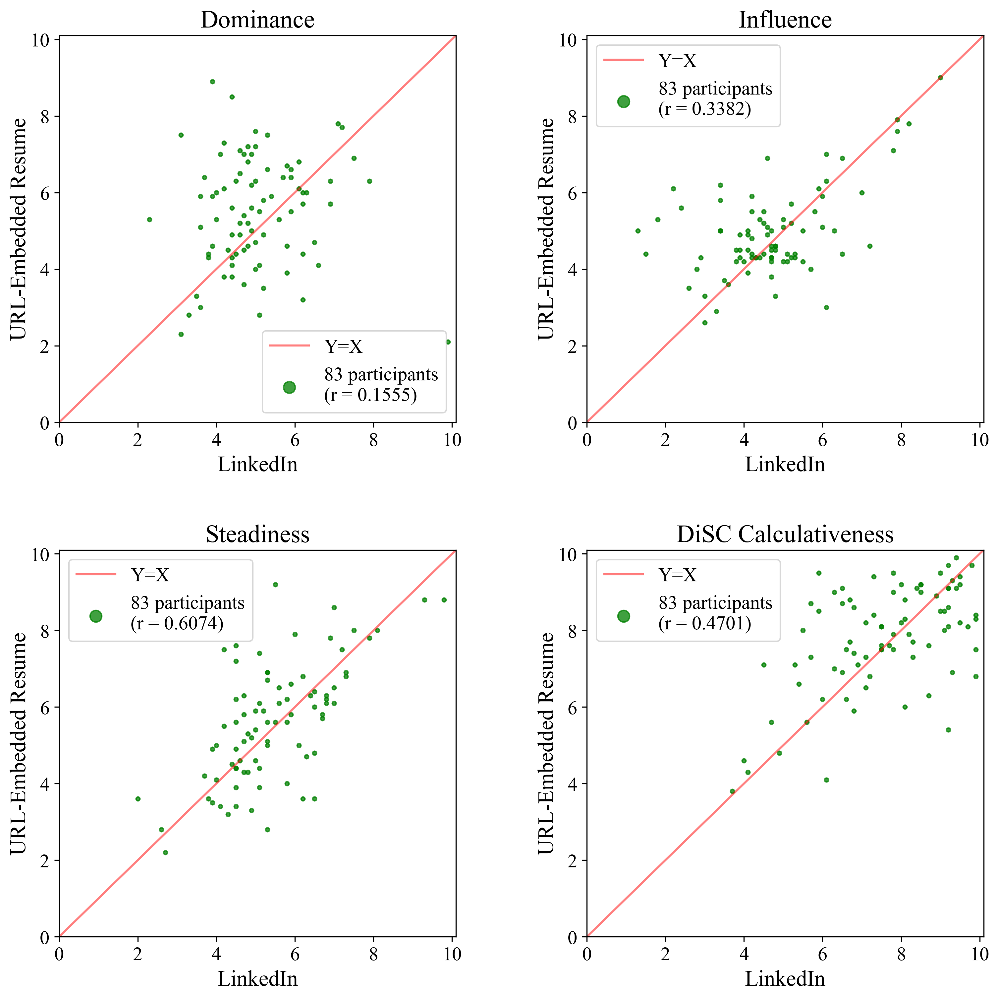

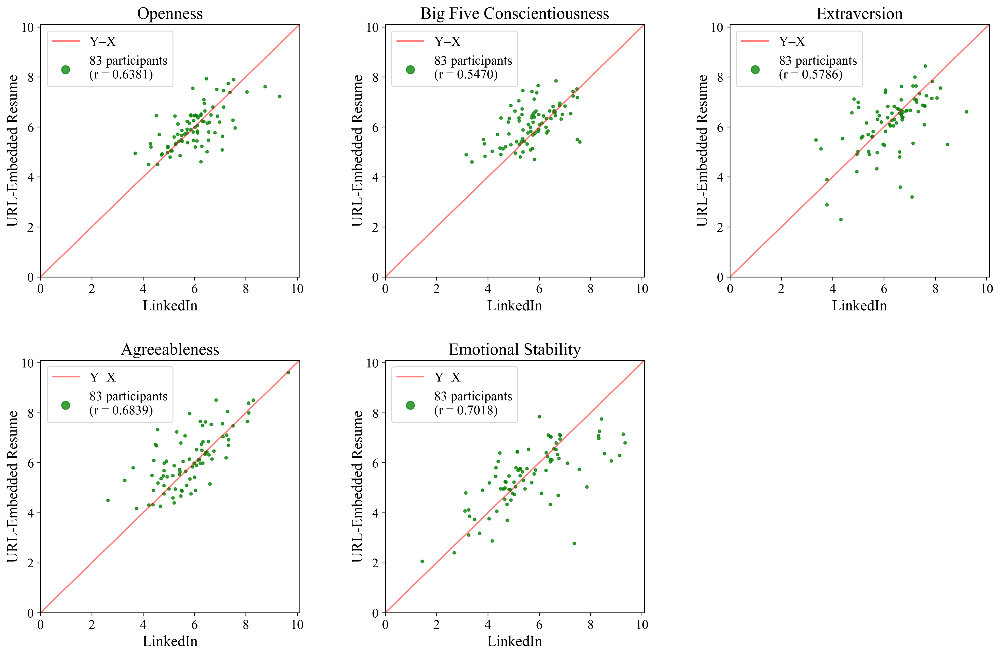

In [10]:
exp_name = 'URL-Embedding: URL-Embedded Resume vs. LinkedIn'
h_results[exp_name] = stability_analysis(treat_code = 'HRu1', ctrl_code = 'HL1')

## Source Context Experiments

### Crystal: PDF Resume vs. LinkedIn URL

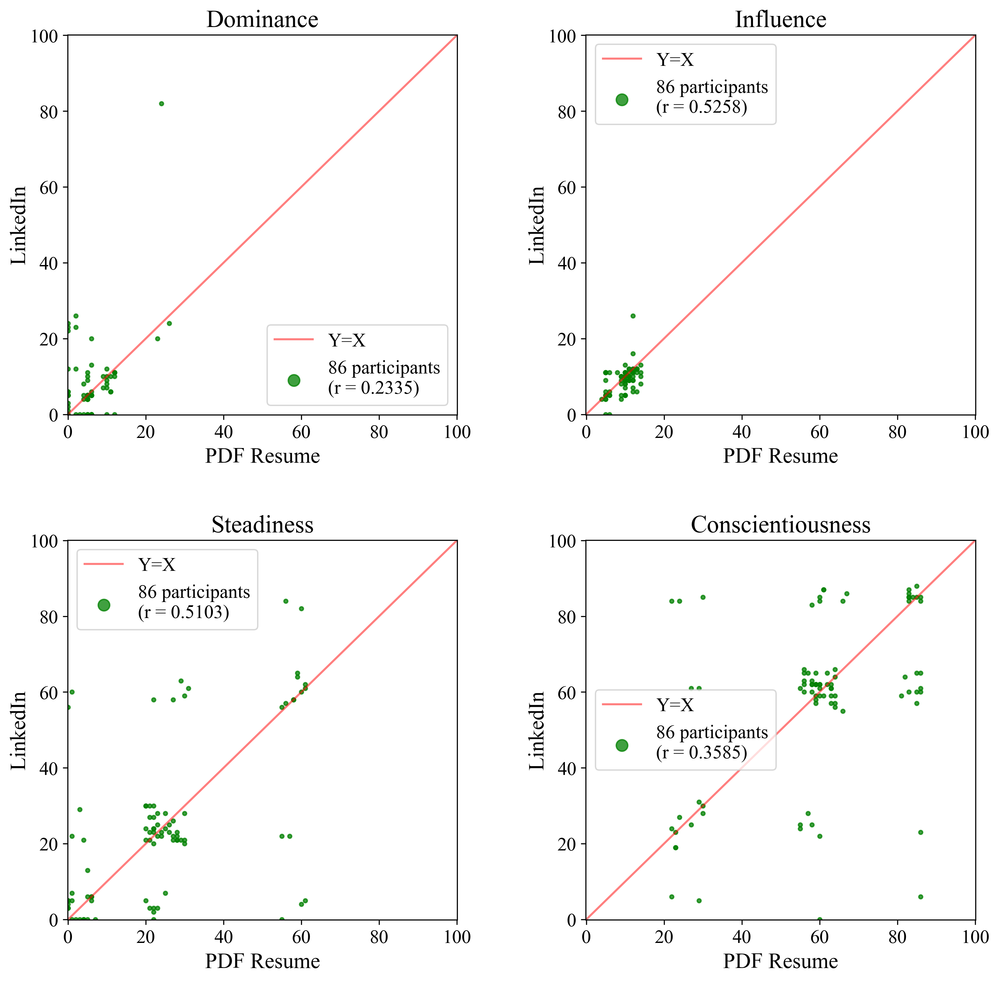

In [11]:
exp_name = 'Source Context: PDF Resume vs. LinkedIn'
c_results[exp_name] = stability_analysis(treat_code = 'CL1', ctrl_code = 'CRp1')

### Humantic: De-Identified Resume vs. LinkedIn

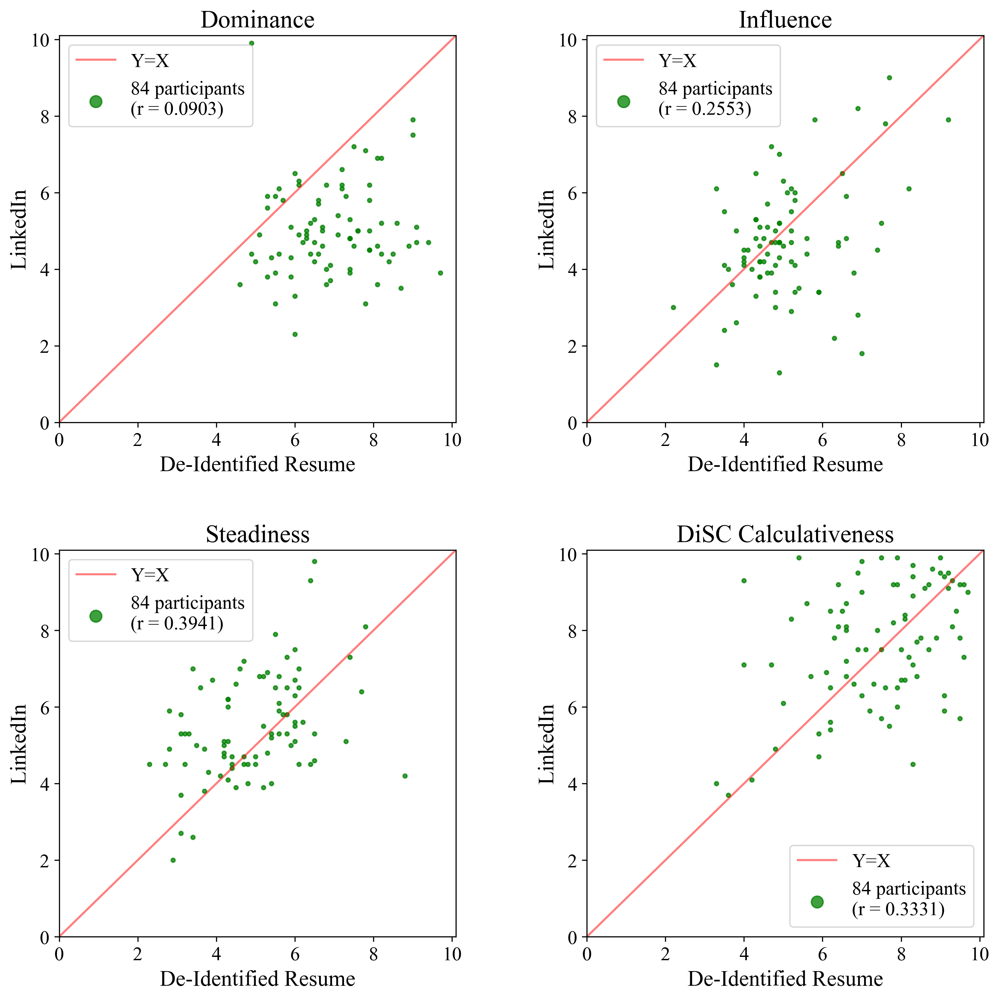

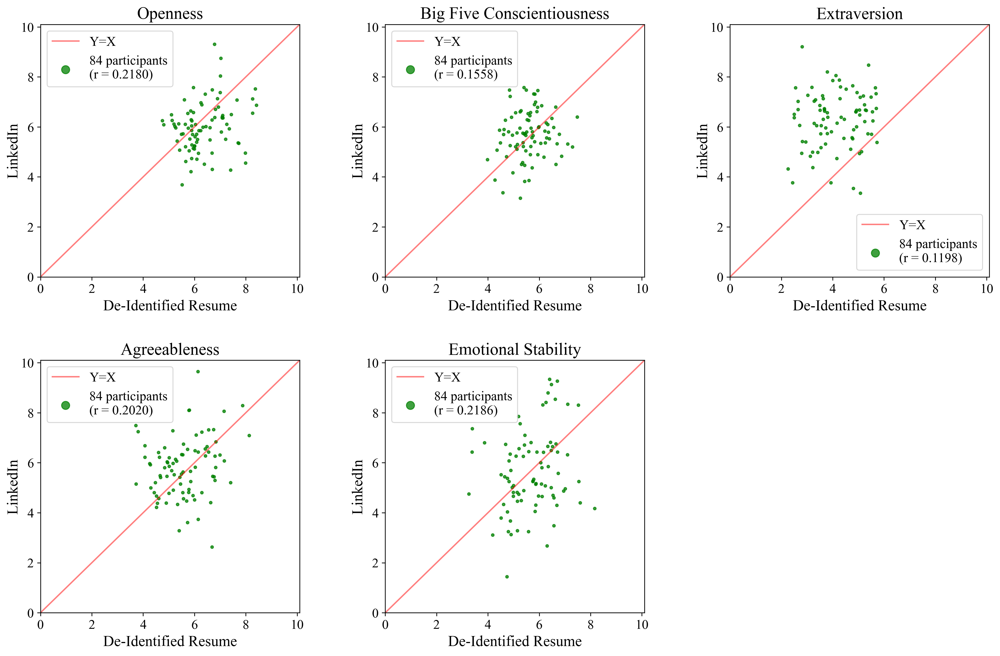

In [12]:
exp_name = 'Source Context: De-Identified Resume vs. LinkedIn'
h_results[exp_name] = stability_analysis(treat_code = 'HL1', ctrl_code = 'HRi1')

### Humantic: Original Resume vs. LinkedIn (All Participants)

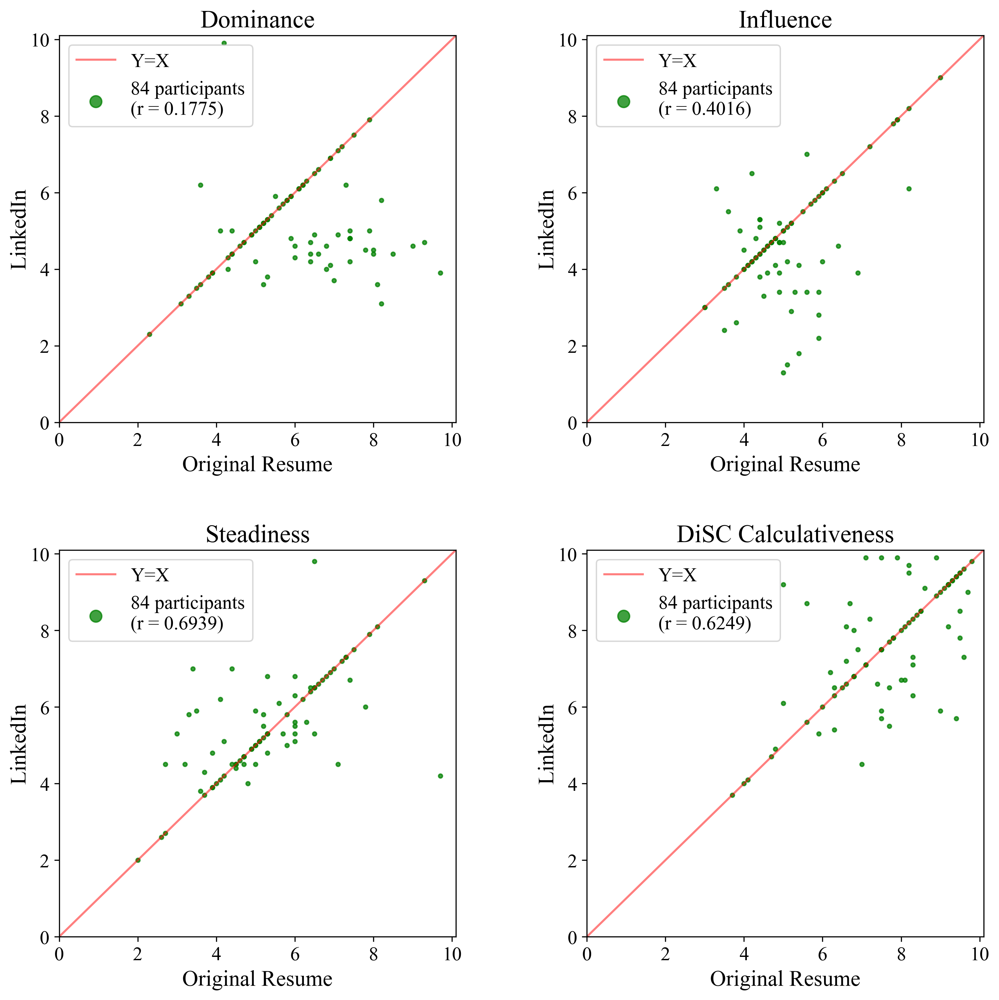

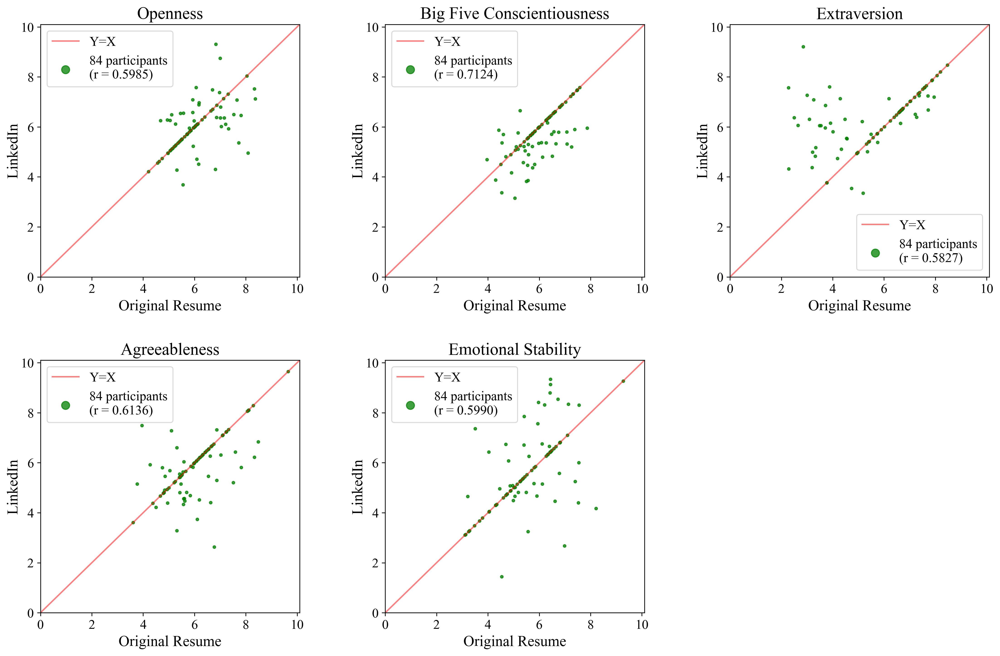

In [13]:
exp_name = 'Source Context: Original Resume vs. LinkedIn'
h_results[exp_name] = stability_analysis(treat_code = 'HL1', ctrl_code = 'HRo1')

### Humantic: Original Resume vs. LinkedIn URL (Limit to Participants with LI Embedded in Resume)

In [14]:
# Get IDs of participants who submitted resume with embedded LI URL
orig_embed_ids = survey[survey.linkedin_in_orig_resume==True].index

# Get subset of HRo1 (Original Resumes) who submitted resume with embedded LI URL
orig_embed = data['HRo1'].loc[set(orig_embed_ids) & set(data['HRo1'].index)]
print('Number of original resumes which contained an embedded LinkedIn URL: ', len(orig_embed))

# Get IDs of participants who submitted LI as well as original resume with embedded URL (excluding thin profiles)
exp_ids_embed = set(orig_embed.index) & set (data['HL1'].index)
print('Size of embedded cohort (Group A) of Original Resume vs. LinkedIn experiment: ', len(exp_ids_embed), '\n')

# Subset HRo1 and HL1 dataframes to select embedded cohort
orig_embed = orig_embed.loc[exp_ids_embed]
li_embed = data['HL1'].loc[exp_ids_embed]

# Print Spearman's correlation for each trait within embedded cohort
for trait in humantic_all_traits_simple:
    r = stats.spearmanr(orig_embed[trait], li_embed[trait])[0]
    print('{}: {:.4f}'.format(trait, r))
    
# How many people with embedded resumes had ANY change?
orig_v_li_disc_l1_arr = h_results['Source Context: Original Resume vs. LinkedIn']['L1'][0].values
orig_v_li_big5_l1_arr = h_results['Source Context: Original Resume vs. LinkedIn']['L1'][1].values
orig_v_li_ind = h_results['Source Context: Original Resume vs. LinkedIn']['L1'][0].index
orig_v_li_l1 = pd.DataFrame({'DiSC':orig_v_li_disc_l1_arr, 'Big Five': orig_v_li_big5_l1_arr}, index=orig_v_li_ind)
orig_v_li_l1_embed = orig_v_li_l1.loc[exp_ids_embed]
print('\nHow many people in Group A had ANY change from original resume to LinkedIn?', 
      len(orig_v_li_l1_embed[np.isclose(orig_v_li_l1_embed.sum(axis=1), 0)==True]))
print('How many people in Group A had NO change from original resume to LinkedIn?', 
      len(orig_v_li_l1_embed[np.isclose(orig_v_li_l1_embed.sum(axis=1), 0)==False]))

Number of original resumes which contained an embedded LinkedIn URL:  57
Size of embedded cohort (Group A) of Original Resume vs. LinkedIn experiment:  57 

Dominance: 0.6276
Influence: 0.6649
Steadiness: 0.8484
DiSC Calculativeness: 0.7380
Openness: 0.8125
Big Five Conscientiousness: 0.8303
Extraversion: 0.8120
Agreeableness: 0.7983
Emotional Stability: 0.8531

How many people in Group A had ANY change from original resume to LinkedIn? 43
How many people in Group A had NO change from original resume to LinkedIn? 14


### Humantic: Original Resume vs. LinkedIn URL (Limit to Participants without LI Embedded in Resume)

In [15]:
# Get IDs of participants who submitted resume with no embedded LI URL
orig_nonembed_ids = survey[survey.linkedin_in_orig_resume==False].index

# Get subset of HRo1 (Original Resumes) who submitted resume with no embedded LI URL
orig_nonembed = data['HRo1'].loc[set(orig_nonembed_ids) & set(data['HRo1'].index)]
print('Number of original resumes which did not contain an embedded LinkedIn URL: ', len(orig_nonembed))

# Get IDs of participants who submitted LI as well as original resume without embedded URL (excluding thin profiles)
exp_ids_nonembed = set(orig_nonembed.index) & set (data['HL1'].index)
print('Size of non-embedded cohort (Group B) of Original Resume vs. LinkedIn experiment: ',len(exp_ids_nonembed),'\n')

# Subset HRo1 and HL1 dataframes to select non-embedded cohort
orig_nonembed = orig_nonembed.loc[exp_ids_nonembed]
li_nonembed = data['HL1'].loc[exp_ids_nonembed]

# Print Spearman's correlation for each trait within non-embedded cohort
for trait in humantic_all_traits_simple:
    r = stats.spearmanr(orig_nonembed[trait], li_nonembed[trait])[0]
    print('{}: {:.4f}'.format(trait, r))

Number of original resumes which did not contain an embedded LinkedIn URL:  31
Size of non-embedded cohort (Group B) of Original Resume vs. LinkedIn experiment:  27 

Dominance: 0.0793
Influence: -0.3097
Steadiness: 0.1846
DiSC Calculativeness: 0.2966
Openness: -0.0974
Big Five Conscientiousness: 0.2055
Extraversion: -0.2751
Agreeableness: -0.0980
Emotional Stability: 0.1178


### Humantic: Original Resume vs. Twitter

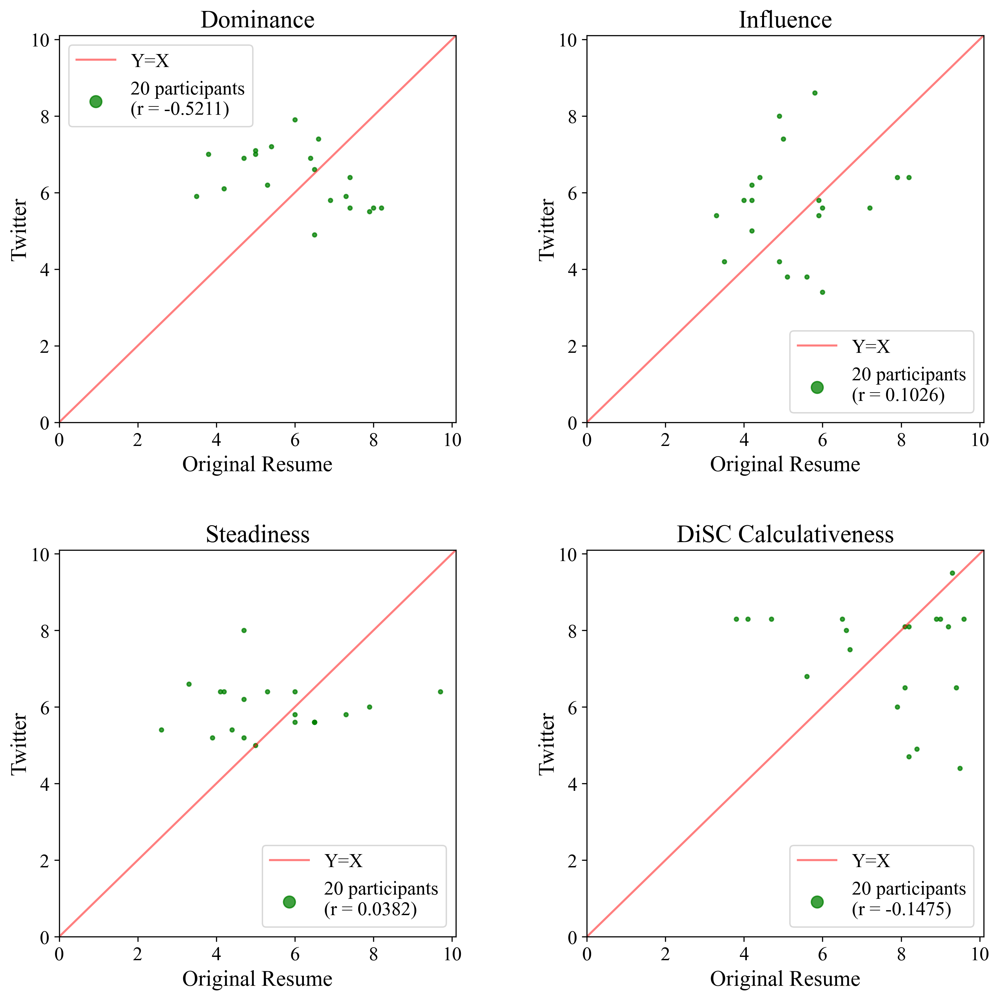

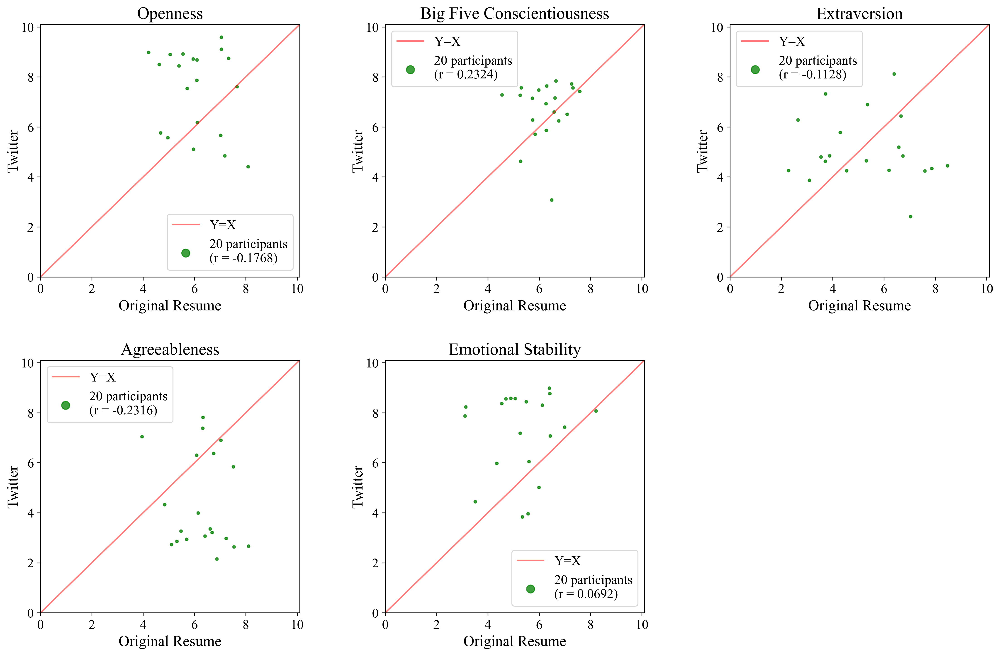

In [16]:
exp_name = 'Source Context: Original Resume vs. Twitter'
h_results[exp_name] = stability_analysis(treat_code = 'HT1', ctrl_code = 'HRo1')

### Humantic: LinkedIn vs. Twitter

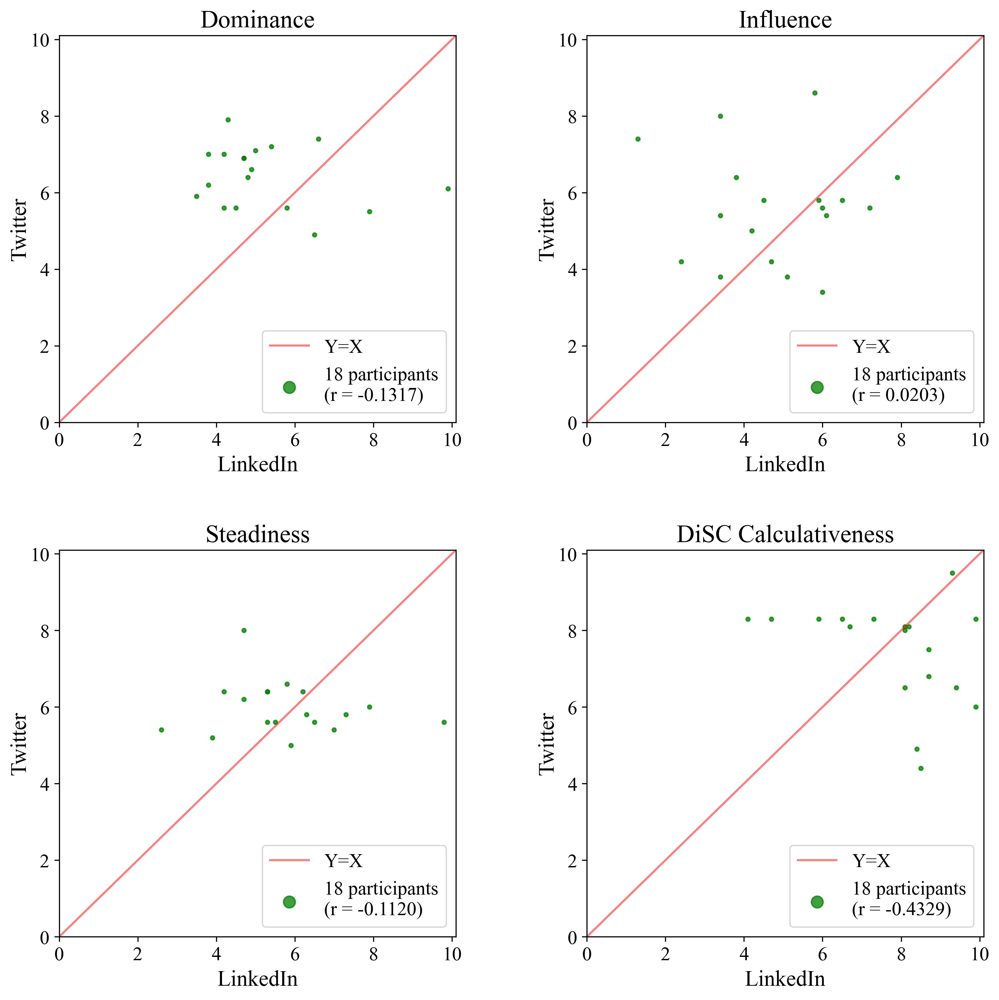

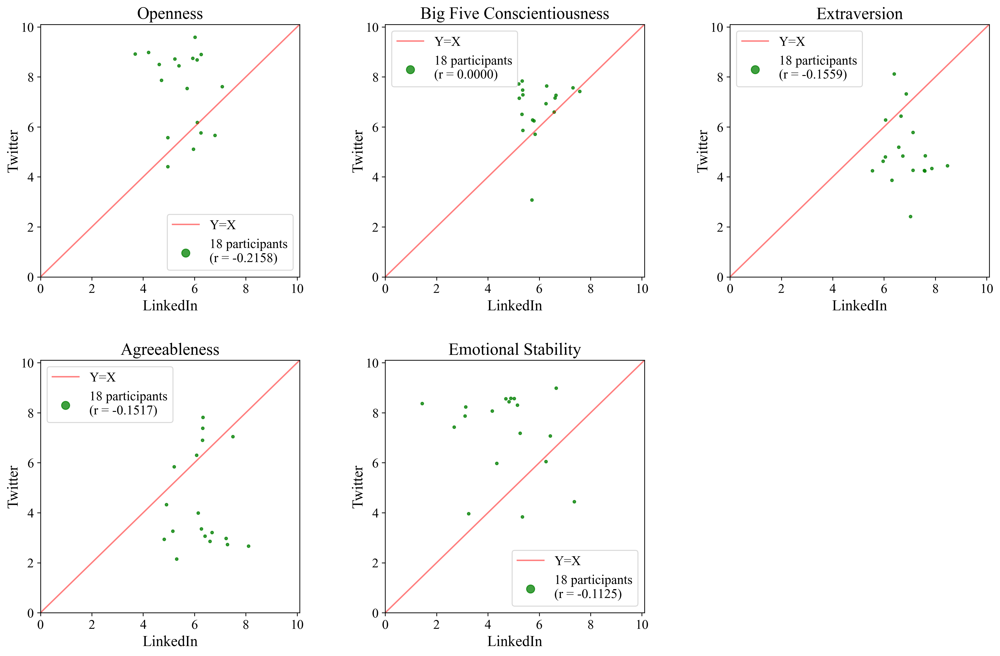

In [17]:
exp_name = 'Source Context: LinkedIn vs. Twitter'
h_results[exp_name] = stability_analysis(treat_code = 'HT1', ctrl_code = 'HL1')

# Algorithm-Time Experiments

### Crystal: Raw Text Resume back-to-back (immediate reproducibility)

All differences are 0 for Dominance. Did not perform Wilcoxon signed rank test.
All differences are 0 for Dominance within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Dominance within Female. Did not perform Wilcoxon signed rank test.
All differences are 0 for Dominance within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Dominance within English. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence within Female. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence within English. Did not perform Wilcoxon signed rank test.
All differences are 0 for Steadiness. Did not perform Wilcoxon signed rank

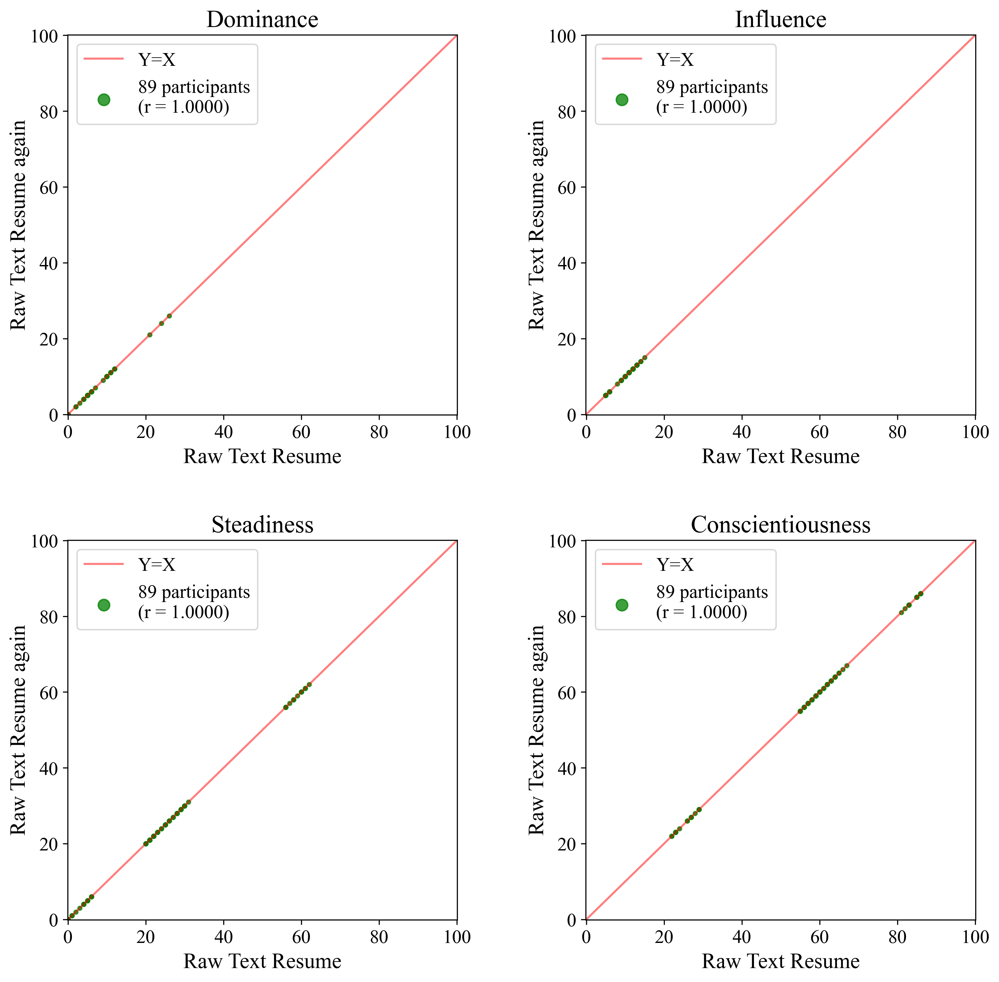

In [18]:
exp_name = 'Immediate Reproducibility: Raw Text Resume back-to-back'
c_results[exp_name] = stability_analysis(treat_code = 'CRr3', ctrl_code = 'CRr2', 
                                         treat_label='Raw Text Resume again')   

### Crystal: Raw Text Resume 31 days apart

All differences are 0 for Dominance. Did not perform Wilcoxon signed rank test.
All differences are 0 for Dominance within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Dominance within Female. Did not perform Wilcoxon signed rank test.
All differences are 0 for Dominance within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Dominance within English. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence within Female. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence within English. Did not perform Wilcoxon signed rank test.
All differences are 0 for Steadiness. Did not perform Wilcoxon signed rank

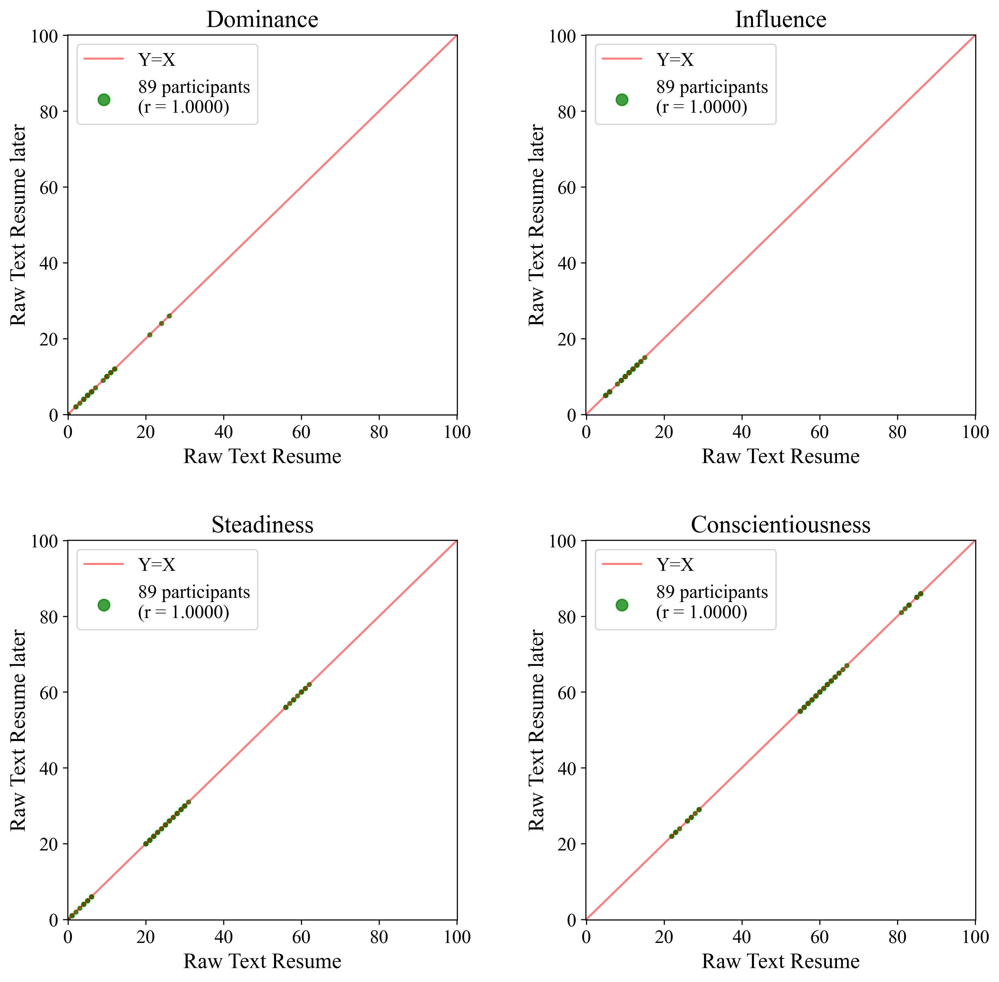

In [19]:
exp_name = 'Algorithm-Time: Raw Text Resume 31 days apart'
c_results[exp_name] = stability_analysis(treat_code = 'CRr2', ctrl_code = 'CRr1',
                                         treat_label='Raw Text Resume later')

### Humantic: De-Identified Resume back-to-back (immediate reproducibility)

All differences are 0 for Dominance within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Dominance within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Steadiness. Did not perform Wilcoxon signed rank test.
All differences are 0 for Steadiness within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Steadiness within Female. Did not perform Wilcoxon signed rank test.
All differences are 0 for Steadiness within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Steadiness within English. Did not perform Wilcoxon signed rank test.
All differences are 0 for DiSC Calculativeness. Did not perform Wilcoxon signed rank test.
All differences are 0 for DiSC Calculativeness within

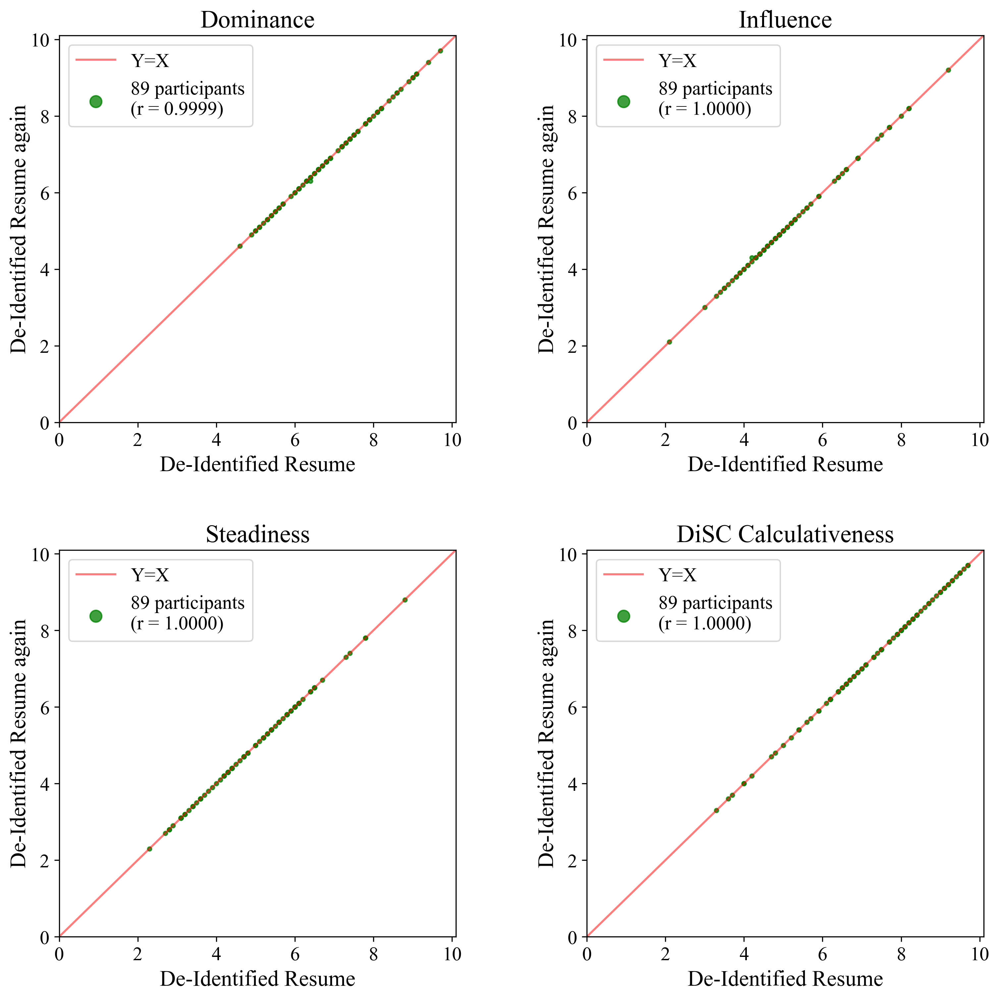

All differences are 0 for Openness within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Openness within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Big Five Conscientiousness within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Big Five Conscientiousness within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Extraversion within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Extraversion within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Agreeableness within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Agreeableness within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Emotional Stability within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Emotional Stability within Other Language. Did not

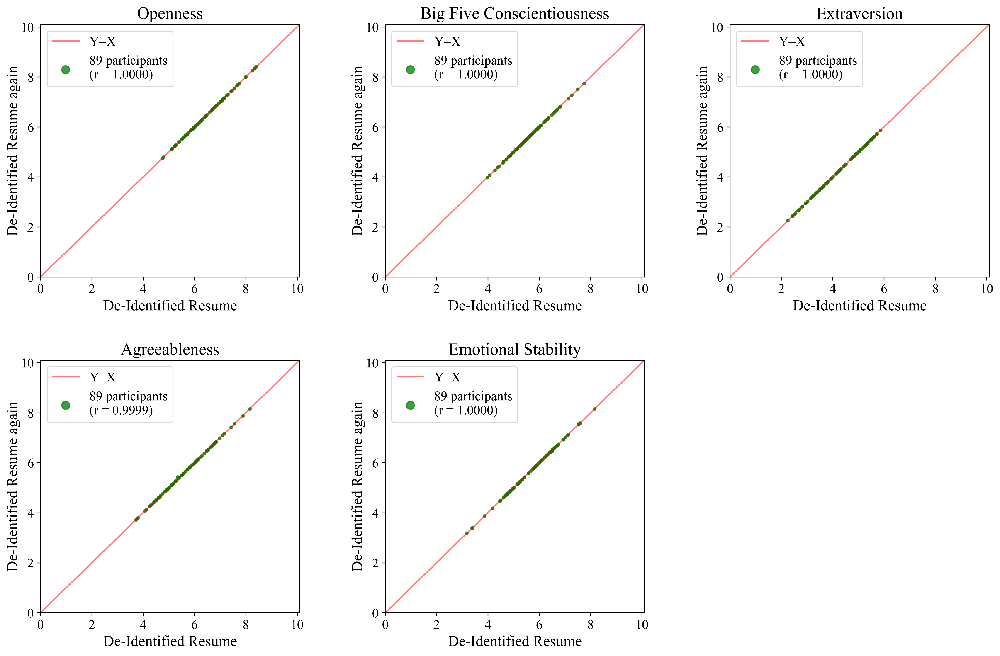

In [20]:
exp_name = 'Immediate Reproducibility: De-Identified Resume back-to-back'
h_results[exp_name] = stability_analysis(treat_code = 'HRi3', ctrl_code = 'HRi2', 
                                         treat_label='De-Identified Resume again')

### Humantic: De-Identified Resume 31 days apart

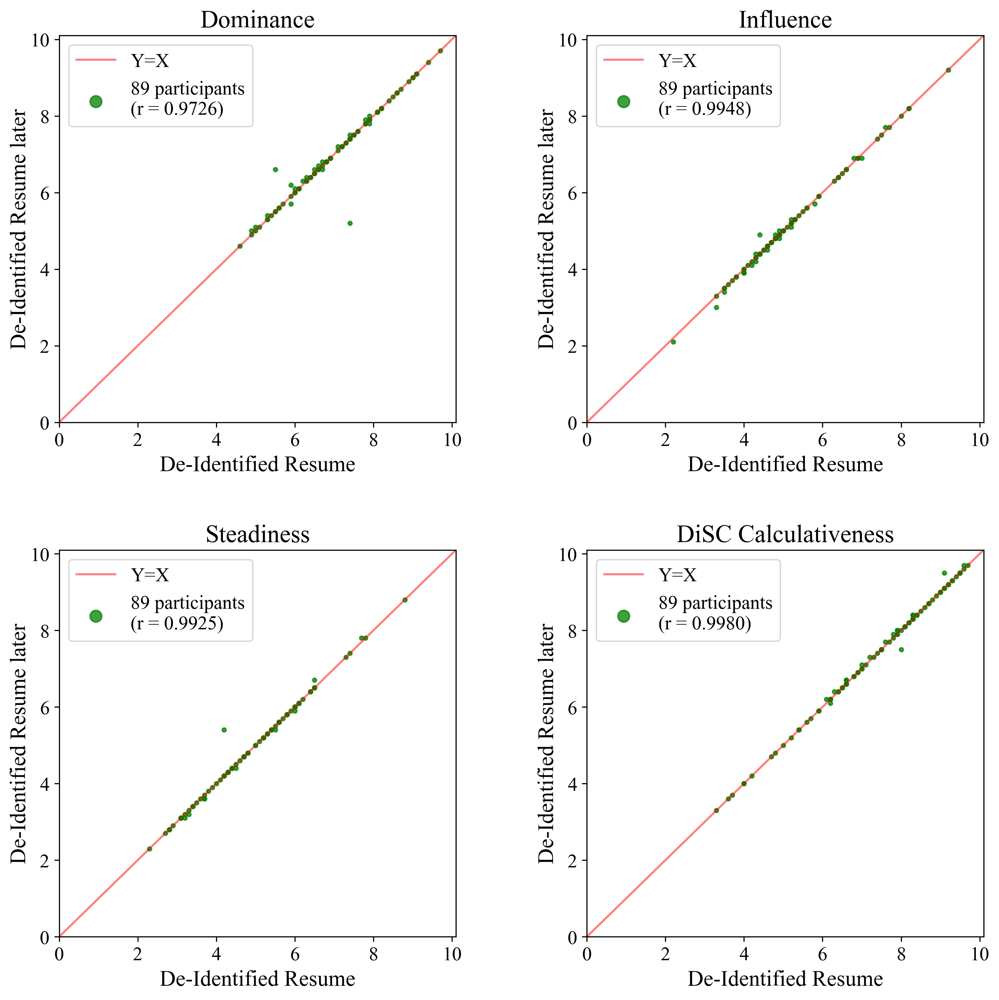

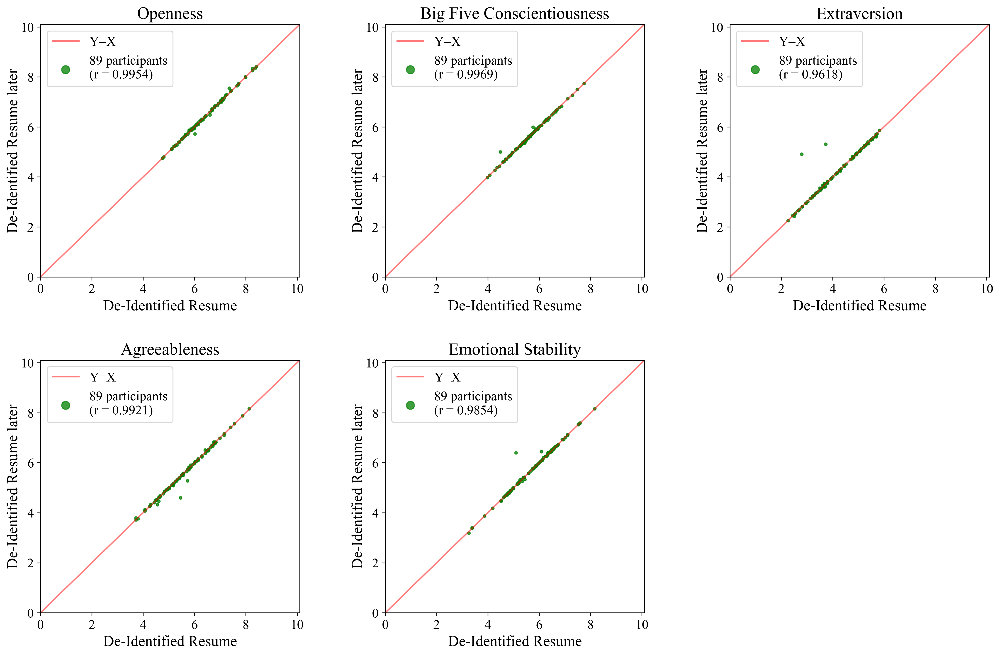

In [21]:
exp_name = 'Algorithm-Time: De-Identified Resume 31 days apart'
h_results[exp_name] = stability_analysis(treat_code = 'HRi2', ctrl_code = 'HRi1',
                                         treat_label='De-Identified Resume later')

## Participant-Time Experiments

### Crystal: LinkedIn 8-10 months apart

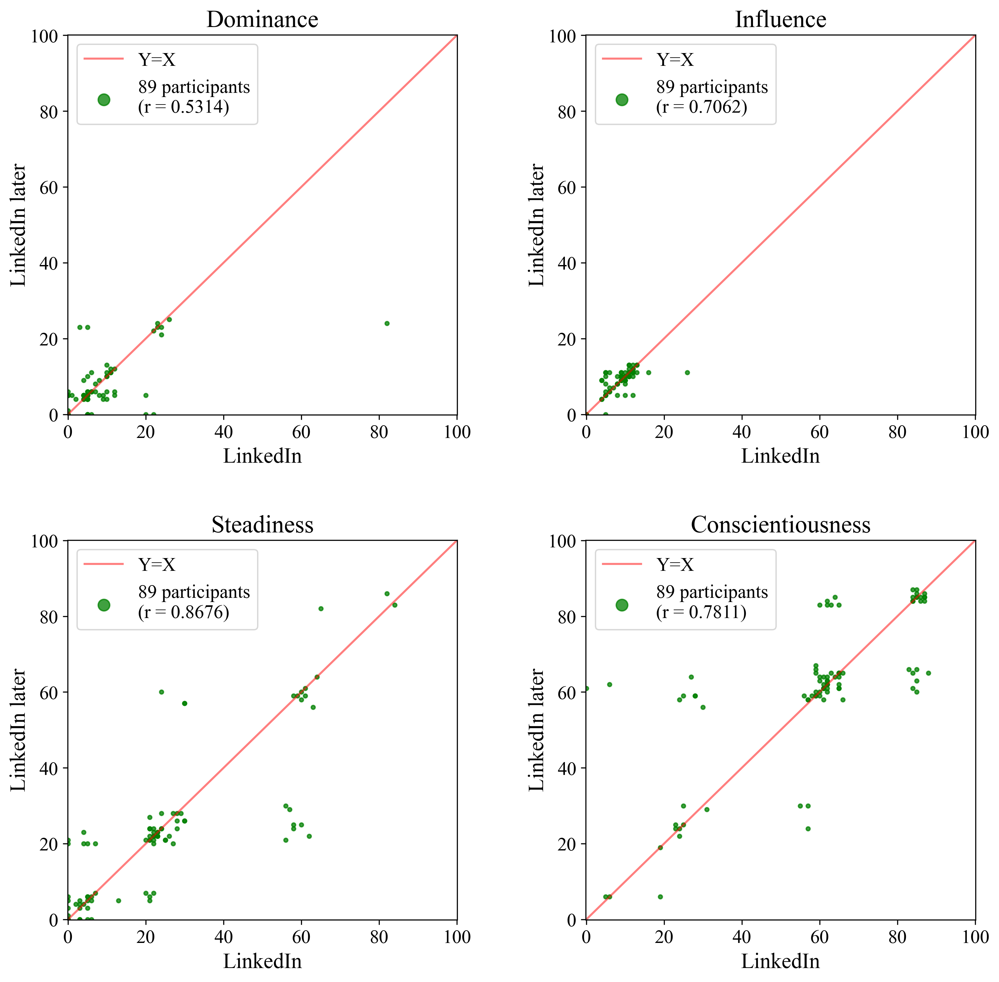

In [22]:
exp_name = 'Participant-Time: LinkedIn 8-10 months apart'
c_results[exp_name] = stability_analysis(treat_code = 'CL2', ctrl_code = 'CL1',
                                         treat_label='LinkedIn later')

### Humantic: LinkedIn 7-9 months apart

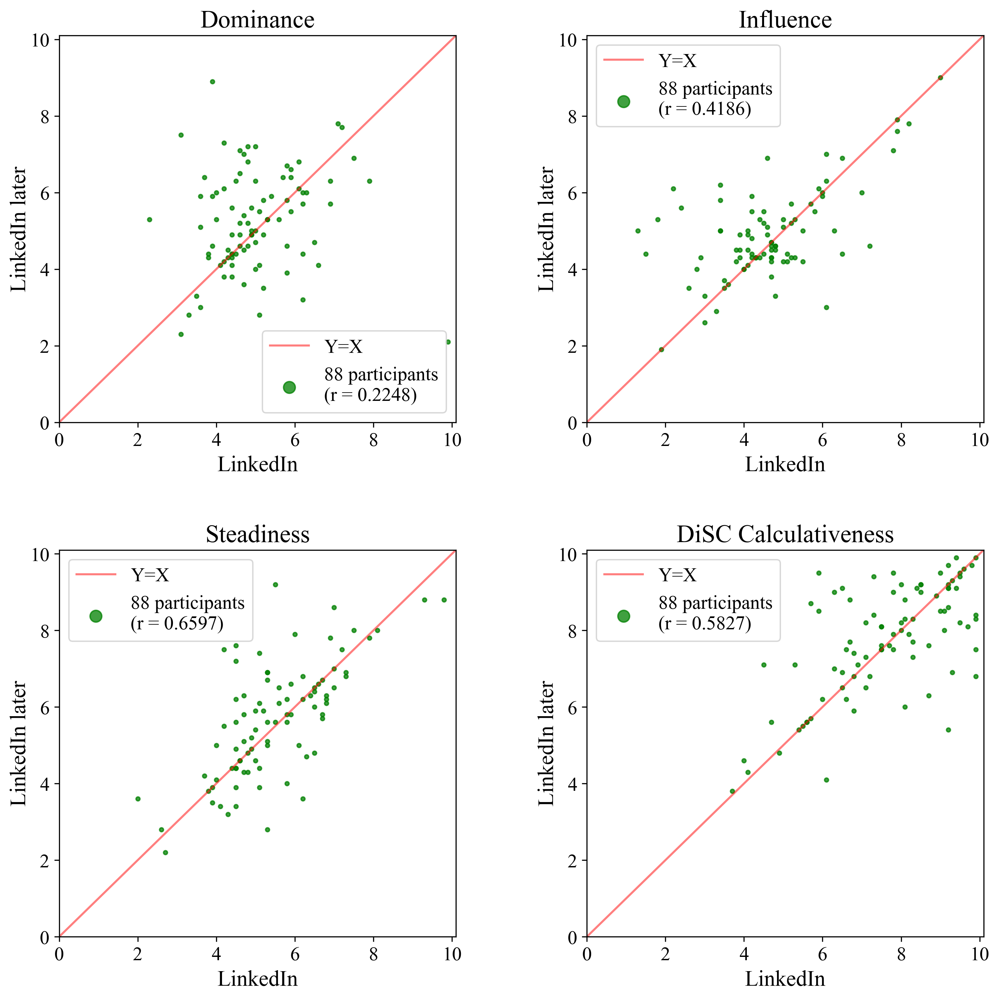

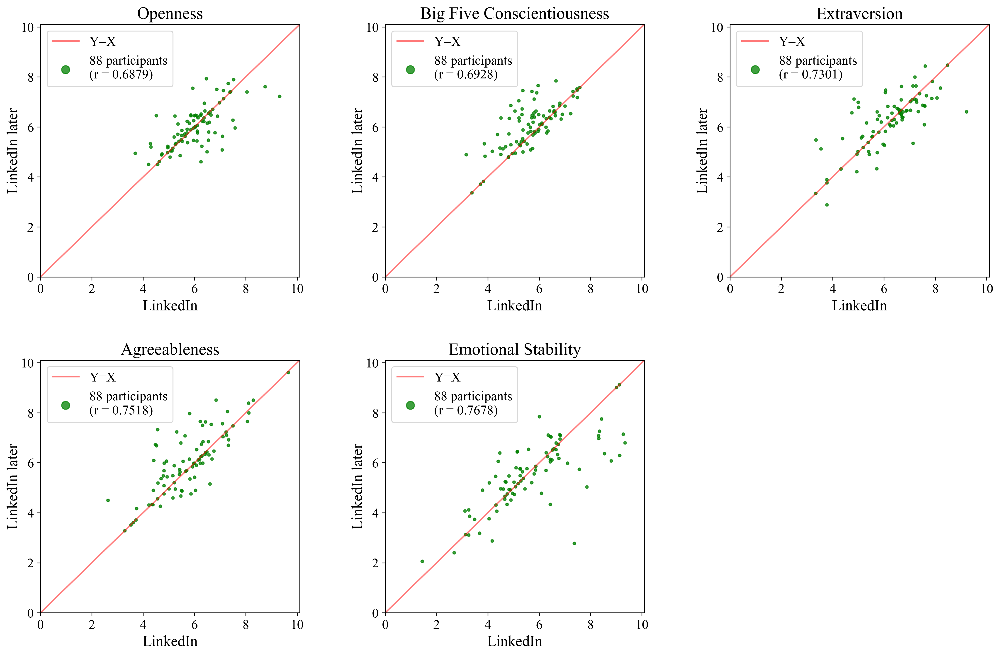

In [23]:
exp_name = 'Participant-Time: LinkedIn 7-9 months apart'
h_results[exp_name] = stability_analysis(treat_code = 'HL2', ctrl_code = 'HL1',
                                         treat_label='LinkedIn later')

### Humantic: Twitter 7-9 months apart

All differences are 0 for Dominance. Did not perform Wilcoxon signed rank test.
All differences are 0 for Dominance within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Dominance within Female. Did not perform Wilcoxon signed rank test.
All differences are 0 for Dominance within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Dominance within English. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence within Female. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Influence within English. Did not perform Wilcoxon signed rank test.
All differences are 0 for Steadiness. Did not perform Wilcoxon signed rank

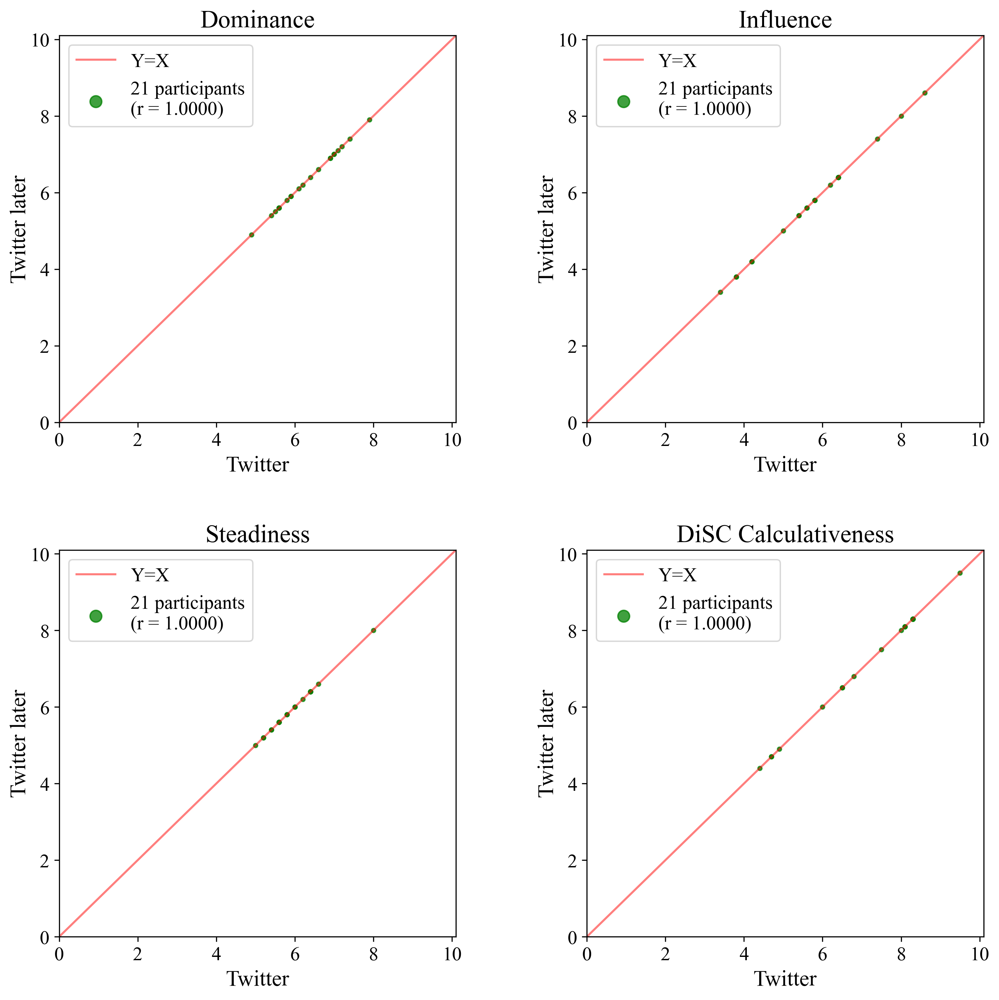

All differences are 0 for Openness. Did not perform Wilcoxon signed rank test.
All differences are 0 for Openness within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Openness within Female. Did not perform Wilcoxon signed rank test.
All differences are 0 for Openness within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Openness within English. Did not perform Wilcoxon signed rank test.
All differences are 0 for Big Five Conscientiousness. Did not perform Wilcoxon signed rank test.
All differences are 0 for Big Five Conscientiousness within Male. Did not perform Wilcoxon signed rank test.
All differences are 0 for Big Five Conscientiousness within Female. Did not perform Wilcoxon signed rank test.
All differences are 0 for Big Five Conscientiousness within Other Language. Did not perform Wilcoxon signed rank test.
All differences are 0 for Big Five Conscientiousness within English. Did not perform Wilcoxon signed rank 

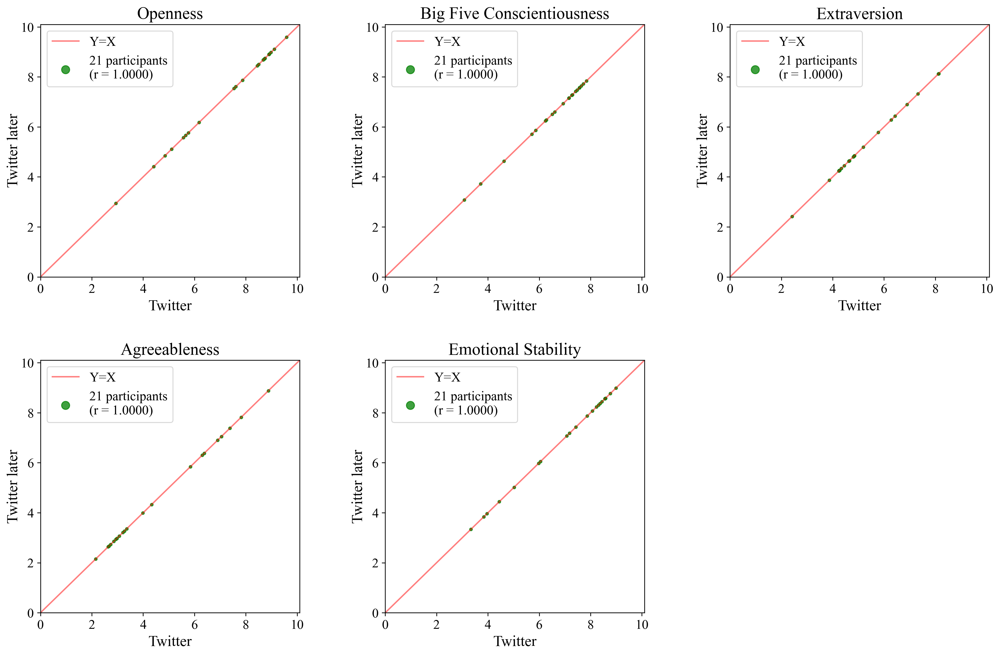

In [24]:
exp_name = 'Participant-Time: Twitter 7-9 months apart'
h_results[exp_name] = stability_analysis(treat_code = 'HT2', ctrl_code = 'HT1',
                                         treat_label='Twitter later')

# Create and Save Metric-Specific Tables

In [25]:
def save_results_tables(tool):
    
    '''
    Takes in a tool name (string; must be either "crystal" or "humantic"),
    converts nested results dictionaries into tuple of metric-specific tables:
        Correlation table, Wilcoxon table, L1 table, and median table
    Saves tables in the results directory, and returns tuple of dataframes.
    '''
    
    if tool=='humantic':
        l1_cols = ['DISC (4 scores, 0-10)', 'Big Five (5 scores, 0-10)']
        results = h_results
        all_traits_simple = humantic_all_traits_simple
    elif tool=='crystal':
        l1_cols = ['DISC (4 scores, 0-100, sum to 100)']
        results = c_results
        all_traits_simple = crystal_all_traits_simple
    else:
        raise ValueError('tool must be either humantic or crystal')
    
    # Correlation Table
    corr_rows = [[exp['N']]+exp['corr'] for exp in results.values()]
    corr_df = pd.DataFrame(corr_rows, columns = ['N'] + all_traits_simple, 
                           index=results.keys())
    corr_df.to_csv('./results/{}_correlations.csv'.format(tool), index_label="Experiment")
    
    #Wilcoxon Table
    wc_iters = [results.keys(), ['W', 'p']]
    wc_ind = pd.MultiIndex.from_product(wc_iters, names=["Experiment", "Two-tailed Wilcoxon"])
    wc_rows = []
    for exp in results.values():
        row = [[exp['N']] + exp['W']]
        row = row + [[exp['N']] + exp['p']]
        wc_rows = wc_rows+row
    wc_df = pd.DataFrame(wc_rows, columns = ['N'] + all_traits_simple, index=wc_ind)
    wc_df.to_csv('./results/{}_wilcoxon.csv'.format(tool))
    
    # L1 Norm Table
    l1_iters = [results.keys(), ['mean', 'stdev']]
    l1_ind = pd.MultiIndex.from_product(l1_iters, names=["Experiment", "L1 Distance"])
    l1_rows = []
    for exp in results.values():
        l1_arr = np.array(exp['L1'])
        row =  [l1_arr.mean(axis=1)] + [l1_arr.std(axis=1)]
        l1_rows = l1_rows+row
    l1_df = pd.DataFrame(l1_rows, index=l1_ind, columns = l1_cols)
    l1_df.to_csv('./results/{}_L1.csv'.format(tool))
    
    # Median table
    avg_iters = [results.keys(), ['control', 'treatment']]
    avg_ind = pd.MultiIndex.from_product(avg_iters, names=["Experiment", "Run Median"])
    avg_rows = []
    for exp in results.values():
        row = [[exp['control_run']] + [exp['N']]+ exp['median_control']]
        row = row + [[exp['treatment_run']] + [exp['N']] + exp['median_treatment']]
        avg_rows = avg_rows+row
    avg_df = pd.DataFrame(avg_rows, index=avg_ind, 
                          columns=['Run', 'N']+all_traits_simple)
    avg_df.to_csv('./results/{}_medians.csv'.format(tool))
    
    return(corr_df, wc_df, l1_df, avg_df)

In [26]:
# Crystal Results
c_corr_df, c_wc_df, c_l1_df, c_avg_df = save_results_tables(tool='crystal')

# Humantic Results
h_corr_df, h_wc_df, h_l1_df, h_avg_df = save_results_tables(tool='humantic')

## Create demographic subgroup tables

In [27]:
genders = ['Male', 'Female']
langs = ['English', 'Other Language']
attrs={'gender':genders, 'lang':langs}

def subgroup_results(results, all_traits_simple, stat):
        
    iters = [results.keys(), ['All']+genders+langs]
    ind = pd.MultiIndex.from_product(iters, names=["Experiment", "Group"])
    rows = []
    
    for exp in results.values():
        
        # Results for all participants
        row = [[exp['N']] + exp[stat]]
        
        # Subgroup results
        for col, attr in attrs.items():
            i = 0
            while i<len(attr):
                if stat+'_'+attr[i] in exp.keys():
                    N = sum(exp[col]==attr[i])
                    row = row + [[N]+exp[stat+'_'+attr[i]]]
                i += 1
        rows = rows+row
    attr_df = pd.DataFrame(rows, 
                         columns = ['N'] + all_traits_simple, 
                         index=ind)

    return attr_df

In [28]:
# Crystal subgroup tables
c_corr_sub = subgroup_results(c_results, disc_traits_crystal, 'corr')
c_wc_sub = subgroup_results(c_results, disc_traits_crystal, 'p')
c_med_treat_sub = subgroup_results(c_results, disc_traits_crystal, 'median_treatment')
c_med_ctrl_sub = subgroup_results(c_results, disc_traits_crystal, 'median_control')

#Humantic subgroup tables
h_corr_sub = subgroup_results(h_results, disc_traits_humantic+ocean_traits, 'corr')
h_wc_sub = subgroup_results(h_results, disc_traits_humantic+ocean_traits, 'p')
h_med_treat_sub = subgroup_results(h_results, disc_traits_humantic+ocean_traits, 'median_treatment')
h_med_ctrl_sub = subgroup_results(h_results, disc_traits_humantic+ocean_traits, 'median_control')

## Refining results tables

In [29]:
c_corr =c_corr_df.copy()
c_corr_s = c_corr_sub.copy()

# Parse index string
c_corr['Facet']=c_corr.index.map(lambda x: x.split(': ')[0])
c_corr['Input Versions']=c_corr.index.map(lambda x: x.split(': ')[1])
c_corr_s['Facet']=c_corr_s.index.get_level_values('Experiment').map(lambda x: x.split(': ')[0])
c_corr_s['Input Versions']=c_corr_s.index.get_level_values('Experiment').map(lambda x: x.split(': ')[1])
c_corr_s['Group']=c_corr_s.index.get_level_values('Group')


# Display columns in desired order
c_corr_disc = c_corr[['Facet', 'Input Versions', 'N']+disc_traits_crystal].reset_index(drop=True)
c_corr_sub_disc = c_corr_s[['Facet', 'Input Versions', 'Group', 'N']+disc_traits_crystal].reset_index(drop=True)

In [30]:
c_wc = c_wc_df.copy()
c_wc_s = c_wc_sub.copy()

# Only display significance levels
c_wc = c_wc[c_wc.index.get_level_values('Two-tailed Wilcoxon')=='p']

# Parse index string
c_wc['Facet']=c_wc.index.get_level_values('Experiment').map(lambda x: x.split(': ')[0])
c_wc['Input Versions']=c_wc.index.get_level_values('Experiment').map(lambda x: x.split(': ')[1])
c_wc_s['Facet']=c_wc_s.index.get_level_values('Experiment').map(lambda x: x.split(': ')[0])
c_wc_s['Input Versions']=c_wc_s.index.get_level_values('Experiment').map(lambda x: x.split(': ')[1])
c_wc_s['Group']=c_wc_s.index.get_level_values('Group')

# Display columns of interest in desired order
c_wc_disc = c_wc[['Facet', 'Input Versions', 'N']+disc_traits_crystal].reset_index(drop=True)
c_wc_sub_disc = c_wc_s[['Facet', 'Input Versions', 'Group', 'N']+disc_traits_crystal].reset_index(drop=True)

In [31]:
# Add Crystal run codes
c_input_versions_dict = {'Raw Text Resume vs.': 'Raw Text Resume (CRr1) vs.',
                        'Raw Text Resume back-to-back': 'Raw Text Resume back-to-back (CRr2 vs. CRr3)',
                         'Raw Text Resume 31 days apart': 'Raw Text Resume 31 days apart (CRr1 vs. CRr2)',
                         'PDF Resume': 'PDF Resume (CRp1)',
                         'LinkedIn 8-10 months apart': 'LinkedIn 8-10 months apart (CL1 vs. CL2)',
                         'vs. LinkedIn': 'vs. LinkedIn (CL1)'}

for k, v in c_input_versions_dict.items():
    c_corr_disc['Input Versions'] = c_corr_disc['Input Versions'].str.replace(k, v)
    c_corr_sub_disc['Input Versions'] = c_corr_sub_disc['Input Versions'].str.replace(k, v)
    c_wc_disc['Input Versions'] = c_wc_disc['Input Versions'].str.replace(k, v)
    c_wc_sub_disc['Input Versions'] = c_wc_sub_disc['Input Versions'].str.replace(k, v)

In [32]:
h_corr = h_corr_df.copy()
h_corr_s = h_corr_sub.copy()

# Parse index string
h_corr['Facet']=h_corr.index.map(lambda x: x.split(': ')[0])
h_corr['Input Versions']=h_corr.index.map(lambda x: x.split(': ')[1])
h_corr_s['Facet']=h_corr_s.index.get_level_values('Experiment').map(lambda x: x.split(': ')[0])
h_corr_s['Input Versions']=h_corr_s.index.get_level_values('Experiment').map(lambda x: x.split(': ')[1])
h_corr_s['Group']=h_corr_s.index.get_level_values('Group')

# Display columns of interest in desired order
h_corr_disc_and_ocean = h_corr[['Facet', 'Input Versions', 'N']+disc_traits_humantic+ocean_traits]\
                        .reset_index(drop=True)
h_corr_sub_disc_and_ocean = h_corr_s[['Facet', 'Input Versions', 'Group', 'N']+disc_traits_humantic+ocean_traits]\
                        .reset_index(drop=True)

# Separate correlation dataframes for DiSC and Big Five
h_corr_disc = h_corr_disc_and_ocean.drop(columns=ocean_traits)
h_corr_ocean = h_corr_disc_and_ocean.drop(columns=disc_traits_humantic)
h_corr_sub_disc = h_corr_sub_disc_and_ocean.drop(columns=ocean_traits)
h_corr_sub_ocean = h_corr_sub_disc_and_ocean.drop(columns=disc_traits_humantic)

In [33]:
h_wc = h_wc_df.copy()
h_wc_s = h_wc_sub.copy()

# Only display significance levels
h_wc = h_wc[h_wc.index.get_level_values('Two-tailed Wilcoxon')=='p']

# Parse index string
h_wc['Facet']=h_wc.index.get_level_values('Experiment').map(lambda x: x.split(': ')[0])
h_wc['Input Versions']=h_wc.index.get_level_values('Experiment').map(lambda x: x.split(': ')[1])
h_wc_s['Facet']=h_wc_s.index.get_level_values('Experiment').map(lambda x: x.split(': ')[0])
h_wc_s['Input Versions']=h_wc_s.index.get_level_values('Experiment').map(lambda x: x.split(': ')[1])
h_wc_s['Group']=h_wc_s.index.get_level_values('Group')

# Display columns of interest in desired order
h_wc_disc_and_ocean = h_wc[['Facet', 'Input Versions', 'N']+disc_traits_humantic+ocean_traits]\
                        .reset_index(drop=True)
h_wc_sub_disc_and_ocean = h_wc_s[['Facet', 'Input Versions', 'Group', 'N']+disc_traits_humantic+ocean_traits]\
                           .reset_index(drop=True)

# Separate locational significance dataframes for DiSC and Big Five
h_wc_disc = h_wc_disc_and_ocean.drop(columns=ocean_traits)
h_wc_ocean = h_wc_disc_and_ocean.drop(columns=disc_traits_humantic)
h_wc_sub_disc = h_wc_sub_disc_and_ocean.drop(columns=ocean_traits)
h_wc_sub_ocean = h_wc_sub_disc_and_ocean.drop(columns=disc_traits_humantic)

In [34]:
# Add Humantic run codes
h_input_versions_dict = {'De-Identified Resume vs.': 'De-Identified Resume (HRi1) vs.',
                        'vs. De-Identified Resume': 'vs. De-Identified Resume (HRi1)',
                        'De-Identified Resume back-to-back': 'De-Identified Resume back-to-back (HRi2 vs. HRi3)',
                        'De-Identified Resume 31 days apart': 'De-Identified Resume 31 days apart (HRi1 vs. HRi2)',
                        'DOCX Resume': 'DOCX Resume (HRd1)',
                        'URL-Embedded Resume': 'URL-Embedded Resume (HRu1)',
                        'Original Resume': 'Original Resume (HRo1)',
                        'LinkedIn vs.': 'LinkedIn (HL1) vs.',
                        'vs. LinkedIn': 'vs. LinkedIn (HL1)',
                        'vs. Twitter': 'vs. Twitter (HT1)',
                        'LinkedIn 7-9 months apart': 'LinkedIn 7-9 months apart (HL1 vs. HL2)',
                        'Twitter 7-9 months apart': 'Twitter 7-9 months apart (HT1 vs. HT2)'}

for k, v in h_input_versions_dict.items():
    h_corr_disc['Input Versions'] = h_corr_disc['Input Versions'].str.replace(k, v)
    h_corr_sub_disc['Input Versions'] = h_corr_sub_disc['Input Versions'].str.replace(k, v)
    h_wc_disc['Input Versions'] = h_wc_disc['Input Versions'].str.replace(k, v)
    h_wc_sub_disc['Input Versions'] = h_wc_sub_disc['Input Versions'].str.replace(k, v)
    
    h_corr_ocean['Input Versions'] = h_corr_ocean['Input Versions'].str.replace(k, v)
    h_corr_sub_ocean['Input Versions'] = h_corr_sub_ocean['Input Versions'].str.replace(k, v)
    h_wc_ocean['Input Versions'] = h_wc_ocean['Input Versions'].str.replace(k, v)
    h_wc_sub_ocean['Input Versions'] = h_wc_sub_ocean['Input Versions'].str.replace(k, v)
    
    h_corr_disc_and_ocean['Input Versions'] = h_corr_disc_and_ocean['Input Versions'].str.replace(k, v)
    h_corr_sub_disc_and_ocean['Input Versions'] = h_corr_sub_disc_and_ocean['Input Versions'].str.replace(k, v)
    h_wc_disc_and_ocean['Input Versions'] = h_wc_disc_and_ocean['Input Versions'].str.replace(k, v)
    h_wc_sub_disc_and_ocean['Input Versions'] = h_wc_sub_disc_and_ocean['Input Versions'].str.replace(k, v)

## Display results with highlighting

In [35]:
# Bonferroni Correction
orig_alpha = 0.05
num_groups = 5 # all together, male, female, primary language english, other language"
num_facets_h = 11
num_facets_c = 5
num_traits_h = len(disc_traits_humantic) + len(ocean_traits)
num_traits_c = len(disc_traits_crystal)
num_tests_h = num_groups*num_facets_h*num_traits_h
num_tests_c = num_groups*num_facets_c*num_traits_c
corrected_alpha_h = orig_alpha / num_tests_h
corrected_alpha_c = orig_alpha / num_tests_c
print('Crystal')
print('\tNumber of hypothesis tests: ', num_tests_c)
print('\tCorrected alpha (based on original alpha of {}: '.format(orig_alpha), round(corrected_alpha_c, 8))
print('Humantic')
print('\tNumber of hypothesis tests: ', num_tests_h)
print('\tCorrected alpha (based on original alpha of {}: '.format(orig_alpha), round(corrected_alpha_h, 8))

Crystal
	Number of hypothesis tests:  100
	Corrected alpha (based on original alpha of 0.05:  0.0005
Humantic
	Number of hypothesis tests:  495
	Corrected alpha (based on original alpha of 0.05:  0.00010101


In [36]:
# Benjamini Hochberg Correction

p_vals_h = list(h_wc_sub[disc_traits_humantic+ocean_traits].values.flatten())
p_vals_c = list(c_wc_sub[disc_traits_crystal].values.flatten())

# Uses mean rank for ties, and sorts NaNs as highest ranks
p_ranks_h = rankdata(p_vals_h)
p_ranks_c = rankdata(p_vals_c)

# Check that p_ranks ranges from 1 to the number of tests performed
assert p_ranks_h.min() == 1
assert p_ranks_c.min() == 1
assert p_ranks_h.max() == num_tests_h
assert p_ranks_c.max() == num_tests_c

def bh_correct(p, alpha, p_vals, p_ranks):
    
    if np.isnan(p):
        return False
    
    # Get ID p_vals array which corresponds to given p-value
    p_id = np.where(p_vals==p)[0]
    if len(p_id)==0:
        p_id = np.where(np.isclose(p_vals, p, atol=np.nanmin(p_vals)/10))[0]
    
    # Look up the rank of the given p-value
    rank = p_ranks[p_id][0]

    # Check that tied p-values have the same rank
    if len(p_id)>1:
        for i in range(1,len(p_id)-1):
            assert p_ranks[p_id[i]]==p_ranks[p_id[0]], 'p_id: {}, ranks: {}'.format(p_id, rank)
        
    # Get adjusted alpha value
    alpha_bh = alpha*(rank/len(p_vals))
    
    # Return True if null hypothesis rejected
    if p < alpha_bh:
        return True
    else:
        return False

In [37]:
def corr_thresh(x, df, cols):
    '''
    Add color coding according to Nunnally et al's thresholds for reliability
    Yellow for r<0.9
    Pale yellow for 0.9<=r<0.95
    
    Adapted from Stack Overflow answer by user jezrael
    https://stackoverflow.com/questions/50141630/python-pandas-style
    '''
    
    c1 = 'background-color: yellow'
    c2 = 'background-color: lightyellow'
    c3 = ''

    mask1 = df[cols]<0.9
    mask2 = (df[cols]>=0.9) & (df[cols]<0.95)
    
    #DataFrame with same index and columns names as original filled empty strings
    df1 =  pd.DataFrame(c3, index=x.index, columns=x.columns)

    #modify values of df1 column by boolean mask
    df1[mask1] = c1
    df1[mask2] = c2
    
    return df1

def signif_thresh(x, df, cols, num_tests, p_vals, p_ranks, alpha=0.05):
    
    ''''
    Add color coding
    Yellow for p<alpha

    Adapted from Stack Overflow answer by user jezrael
    https://stackoverflow.com/questions/50141630/python-pandas-style
    '''
    
    c1 = 'background-color: yellow'
    c2 = 'background-color: lightyellow'
    c3 = ''

    alpha_bon = alpha/num_tests
    mask1 = df[cols]<alpha_bon
    mask2 = (df[cols]>=alpha_bon) & (df[cols].applymap(partial(bh_correct, alpha=alpha, 
                                                               p_vals=p_vals, p_ranks=p_ranks)))
    
    #DataFrame with same index and columns names as original filled empty strings
    df1 =  pd.DataFrame(c3, index=x.index, columns=x.columns)

    #modify values of df1 column by boolean mask
    df1[mask1] = c1
    df1[mask2] = c2
    
    return df1

In [38]:
c_corr_disc.style.apply(partial(corr_thresh, cols=disc_traits_crystal, df = c_corr_disc), axis=None)

,Facet,Input Versions,N,Dominance,Influence,Steadiness,Conscientiousness
0,File Format,Raw Text Resume (CRr1) vs. PDF Resume (CRp1),89,0.822451,0.826028,0.918406,0.911401
1,Source Context,PDF Resume (CRp1) vs. LinkedIn (CL1),86,0.233459,0.525754,0.510262,0.358494
2,Immediate Reproducibility,Raw Text Resume back-to-back (CRr2 vs. CRr3),89,1.000000,1.000000,1.000000,1.000000
3,Algorithm-Time,Raw Text Resume 31 days apart (CRr1 vs. CRr2),89,1.000000,1.000000,1.000000,1.000000
4,Participant-Time,LinkedIn 8-10 months apart (CL1 vs. CL2),89,0.531372,0.706181,0.867640,0.781113


In [39]:
c_wc_disc.style.apply(partial(signif_thresh, cols=disc_traits_crystal, 
                              num_tests=num_tests_c, p_vals = p_vals_c, p_ranks = p_ranks_c,
                              df = c_wc_disc), axis=None)

,Facet,Input Versions,N,Dominance,Influence,Steadiness,Conscientiousness
0,File Format,Raw Text Resume (CRr1) vs. PDF Resume (CRp1),89,0.502560,0.420843,0.017266,0.036972
1,Source Context,PDF Resume (CRp1) vs. LinkedIn (CL1),86,0.419034,0.001178,0.700989,0.842057
2,Immediate Reproducibility,Raw Text Resume back-to-back (CRr2 vs. CRr3),89,nan,nan,nan,nan
3,Algorithm-Time,Raw Text Resume 31 days apart (CRr1 vs. CRr2),89,nan,nan,nan,nan
4,Participant-Time,LinkedIn 8-10 months apart (CL1 vs. CL2),89,0.729940,0.651781,0.330464,0.287028


In [40]:
h_corr_disc_and_ocean.style.apply(partial(corr_thresh, cols=disc_traits_humantic+ocean_traits, 
                                          df = h_corr_disc_and_ocean), axis=None)

,Facet,Input Versions,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
0,File Format,De-Identified Resume (HRi1) vs. DOCX Resume (HRd1),89,0.995624,0.992390,0.997848,0.995924,0.989137,0.993564,0.993947,0.992726,0.981629
1,URL Embedding,URL-Embedded Resume (HRu1) vs. De-Identified Resume (HRi1),86,0.357011,0.625270,0.548035,0.687827,0.398844,0.384505,0.077165,0.418973,0.403988
2,URL-Embedding,URL-Embedded Resume (HRu1) vs. LinkedIn (HL1),83,0.155546,0.338196,0.607441,0.470140,0.638149,0.547006,0.578566,0.683940,0.701786
3,Source Context,De-Identified Resume (HRi1) vs. LinkedIn (HL1),84,0.090333,0.255257,0.394121,0.333127,0.217976,0.155812,0.119779,0.201981,0.218614
4,Source Context,Original Resume (HRo1) vs. LinkedIn (HL1),84,0.177456,0.401557,0.693875,0.624925,0.598454,0.712420,0.582701,0.613555,0.599033
5,Source Context,Original Resume (HRo1) vs. Twitter (HT1),20,-0.521133,0.102613,0.038242,-0.147516,-0.176758,0.232418,-0.112782,-0.231579,0.069173
6,Source Context,LinkedIn (HL1) vs. Twitter (HT1),18,-0.131675,0.020270,-0.111988,-0.432945,-0.215798,0.000000,-0.155911,-0.151703,-0.112487
7,Immediate Reproducibility,De-Identified Resume back-to-back (HRi2 vs. HRi3),89,0.999936,0.999957,1.000000,1.000000,1.000000,1.000000,0.999996,0.999949,1.000000
8,Algorithm-Time,De-Identified Resume 31 days apart (HRi1 vs. HRi2),89,0.972610,0.994763,0.992526,0.998045,0.995382,0.996935,0.961763,0.992091,0.985366
9,Participant-Time,LinkedIn 7-9 months apart (HL1 vs. HL2),88,0.224790,0.418623,0.659703,0.582710,0.687925,0.692752,0.730115,0.751771,0.767776


In [41]:
h_wc_disc_and_ocean.style.apply(partial(signif_thresh, cols=disc_traits_humantic+ocean_traits, 
                                        num_tests=num_tests_h, p_vals = p_vals_h, p_ranks = p_ranks_h,
                                        df = h_wc_disc_and_ocean), axis=None)

,Facet,Input Versions,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
0,File Format,De-Identified Resume (HRi1) vs. DOCX Resume (HRd1),89,0.251035,0.293973,0.457425,0.253911,0.719333,0.924786,0.530600,0.300325,0.977065
1,URL Embedding,URL-Embedded Resume (HRu1) vs. De-Identified Resume (HRi1),86,0.000000,0.319401,0.000479,0.004721,0.002463,0.000021,0.000000,0.000161,0.221361
2,URL-Embedding,URL-Embedded Resume (HRu1) vs. LinkedIn (HL1),83,0.006598,0.182473,0.532370,0.121313,0.735176,0.000043,0.360267,0.006841,0.716674
3,Source Context,De-Identified Resume (HRi1) vs. LinkedIn (HL1),84,0.000000,0.057956,0.001319,0.325869,0.007653,0.399670,0.000000,0.173047,0.671797
4,Source Context,Original Resume (HRo1) vs. LinkedIn (HL1),84,0.000007,0.005009,0.229930,0.591056,0.530005,0.000284,0.000069,0.022100,0.455299
5,Source Context,Original Resume (HRo1) vs. Twitter (HT1),20,0.570597,0.311794,0.197515,0.687374,0.012079,0.082550,0.898317,0.001986,0.001017
6,Source Context,LinkedIn (HL1) vs. Twitter (HT1),18,0.034233,0.324730,0.609459,0.553923,0.002335,0.004745,0.000671,0.004745,0.000671
7,Immediate Reproducibility,De-Identified Resume back-to-back (HRi2 vs. HRi3),89,0.317311,0.317311,nan,nan,0.179712,0.317311,0.317311,0.654721,0.654721
8,Algorithm-Time,De-Identified Resume 31 days apart (HRi1 vs. HRi2),89,0.141645,0.597097,0.568977,0.030704,0.007093,0.531419,0.254030,0.051550,0.242401
9,Participant-Time,LinkedIn 7-9 months apart (HL1 vs. HL2),88,0.070862,0.079967,0.345670,0.296926,0.648663,0.000004,0.961527,0.007248,0.601121


## Highlighted subgroup correlations

In [42]:
print("CRYSTAL SPEARMAN\'S CORRELATION")
display(c_corr_sub.style.apply(partial(corr_thresh, cols=disc_traits_crystal, df = c_corr_sub), axis=None))
#display(c_corr_sub_disc.style.apply(partial(corr_thresh, cols=disc_traits_crystal, df = c_corr_sub_disc), axis=None))

print("\n\nCRYSTAL WILCOXON SIGNIFICANCE")
display(c_wc_s.style.apply(partial(signif_thresh, cols=disc_traits_crystal, 
                                     num_tests=num_tests_c, p_vals=p_vals_c, p_ranks = p_ranks_c,
                                     df = c_wc_sub), axis=None))
# display(c_wc_sub_disc.style.apply(partial(signif_thresh, cols=disc_traits_crystal, 
#                                      num_tests=num_tests_c, p_vals=p_vals_c, p_ranks = p_ranks_c,
#                                      df = c_wc_sub_disc), axis=None))

CRYSTAL SPEARMAN'S CORRELATION




CRYSTAL WILCOXON SIGNIFICANCE


In [43]:
print("HUMANTIC SPEARMAN\'S CORRELATION")
display(h_corr_sub.style.apply(partial(corr_thresh, cols=disc_traits_humantic+ocean_traits,
                                       df = h_corr_sub), axis=None))
# display(h_corr_sub_disc.style.apply(partial(corr_thresh, cols=disc_traits_humantic,
#                                        df = h_corr_sub_disc), axis=None))
# display(h_corr_sub_ocean.style.apply(partial(corr_thresh, cols=ocean_traits,
#                                        df = h_corr_sub_ocean), axis=None))

print("\n\nHUMANTIC WILCOXON SIGNIFICANCE")
display(h_wc_sub.style.apply(partial(signif_thresh, cols=disc_traits_humantic+ocean_traits, 
                                     num_tests=num_tests_h, p_vals=p_vals_h, p_ranks = p_ranks_h,
                                     df = h_wc_sub), axis=None))
# display(h_wc_sub_disc.style.apply(partial(signif_thresh, cols=disc_traits_humantic, 
#                                      num_tests=num_tests_h, p_vals=p_vals_h, p_ranks = p_ranks_h,
#                                      df = h_wc_sub_disc), axis=None))
# display(h_wc_sub_ocean.style.apply(partial(signif_thresh, cols=ocean_traits, 
#                                      num_tests=num_tests_h, p_vals=p_vals_h, p_ranks = p_ranks_h,
#                                      df = h_wc_sub_ocean), axis=None))

HUMANTIC SPEARMAN'S CORRELATION




HUMANTIC WILCOXON SIGNIFICANCE


# Printing out notable results

In [44]:
def map_traits(value):
    if value in genders:
        return 'Gender'
    if value in langs:
        return 'Primary Language'

def summarize_results(tool, metric, exp):
    
    assert tool in ['humantic', 'crystal'], 'tool must be either "humantic" or "crystal"'
    assert metric in ['corr', 'wc'], 'metric must be either "corr" (correlation) or "wc" (wilcoxon)'
    
    if tool == 'crystal':
        traits = disc_traits_crystal
        if metric == 'wc':
            df = c_wc_sub
            df_all = c_wc_df
            avg_df = c_avg_df
            avg_sub_ctrl_df = c_med_ctrl_sub
            avg_sub_treat_df = c_med_treat_sub
            results = c_results
            num_tests = num_tests_c
            p_vals = p_vals_c
            p_ranks = p_ranks_c
        elif metric =='corr':
            df = c_corr_sub
    elif tool == 'humantic':
        traits = disc_traits_humantic + ocean_traits
        if metric == 'wc':
            df = h_wc_sub
            df_all = h_wc_df
            avg_df = h_avg_df
            avg_sub_ctrl_df = h_med_ctrl_sub
            avg_sub_treat_df = h_med_treat_sub
            results = h_results
            num_tests = num_tests_h
            p_vals = p_vals_h
            p_ranks = p_ranks_h
        elif metric =='corr':
            df = h_corr_sub

    # Look at given experiment
    res = df.xs(exp, level='Experiment')
        
    # For median-level differences, look at treatment/control medians along with Wilcoxon p
    if metric == 'wc':
        
        print('\nOverall Wilcoxon p, with significance highlighting for {}'.format(exp))
        res_all = df_all.xs(exp, level='Experiment').loc[['p']]
        display(res_all.style.apply(partial(signif_thresh, cols=traits, 
                                          num_tests=num_tests, p_vals = p_vals, p_ranks = p_ranks,
                                          df = res_all), axis=None))
        
        print('\nOverall medians for {}'.format(exp))
        display(avg_df.xs(exp, level='Experiment'))

        
        print('\nSubgroup Wilcoxon p, with significance highlighting for {}'.format(exp))
        display(res.style.apply(partial(signif_thresh, cols=traits, 
                                          num_tests=num_tests, p_vals = p_vals, p_ranks = p_ranks,
                                          df = res), axis=None))
    
        print('\nSubgroup medians for {}'.format(exp))
        treat_sub = avg_sub_treat_df.loc[exp]
        ctrl_sub = avg_sub_ctrl_df.loc[exp]
        wc_sub = df.loc[exp]
        treat_sub['Statistic'] = results[exp]['treatment_run'] + ' Median'
        ctrl_sub['Statistic'] = results[exp]['control_run'] + ' Median'
        wc_sub['Statistic'] = 'Wilcoxon p'
        display(pd.concat([wc_sub, treat_sub, ctrl_sub])\
                .reset_index().set_index(['Group', 'N', 'Statistic']).sort_index())

    # For correlations, look at mins/maxes, overall and in subgroups
    if metric == 'corr':
        
        # subgroup correlations (with highlighting)
        display(res.style.apply(partial(corr_thresh, cols=traits, df = res), axis=None))
        
        # Exclude sample size from min/max analysis
        res = res.drop(columns='N')
        
        # Get overall min and max
        all_row = res[res.index=='All']
        overall_min = all_row.idxmin(axis=1)[0]
        overall_max = all_row.idxmax(axis=1)[0]
        print('\nOverall min and max correlations for {}:'.format(exp))
        display(all_row[[overall_min, overall_max]])

        # Group by type of sensitive variable
        res['sensitive'] = res.index.map(map_traits)
        sub = res[res.index!='All'].groupby('sensitive')

        # Get maximum differences across each type of sensitive variable
        sub_diffs = (sub.max() - sub.min())

        # Maximum difference across ANY sensitive variable
        sub_diff_maxes = sub_diffs.max(axis=0)

        # Trait with highest maximum difference
        max_max_diff = max(sub_diff_maxes)
        max_diff_trait = sub_diff_maxes[sub_diff_maxes==max_max_diff].index[0]
        print('\nBiggest subgroup difference is in: ', max_diff_trait)

        # Get the sensitive variable associated with the biggest difference
        trait_diffs = sub_diffs[max_diff_trait]
        max_diff_sens = trait_diffs[trait_diffs==max_max_diff].index[0]

        # Look at the specific trait and specific sensitive variable with the highest difference
        final_group = res[res.sensitive==max_diff_sens][max_diff_trait]

        # Print the subgroup high and low
        print('Min: ', final_group.idxmin(), final_group.min())
        print('Max: ', final_group.idxmax(), final_group.max())

        assert final_group.max() - final_group.min() == max_max_diff

In [45]:
for i in c_corr_df.index:
    print('\nRANK ORDER CORRELATION {}'.format(i))
    summarize_results(tool='crystal', metric='corr', exp=i)
    print('\n\nWILCOXON SIGNIFICANCE {}'.format(i))
    summarize_results(tool='crystal', metric='wc', exp=i)
    print('\n\n\n')


RANK ORDER CORRELATION File Format: Raw Text Resume vs. PDF Resume


,N,Dominance,Influence,Steadiness,Conscientiousness
Group,,,,,
All,89,0.822451,0.826028,0.918406,0.911401
Male,54,0.762754,0.816981,0.946020,0.946568
Female,33,0.880520,0.842935,0.888256,0.862263
English,56,0.852256,0.789975,0.890853,0.886385
Other Language,33,0.768692,0.868754,0.972507,0.957030



Overall min and max correlations for File Format: Raw Text Resume vs. PDF Resume:


,Dominance,Steadiness
Group,,
All,0.822451,0.918406



Biggest subgroup difference is in:  Dominance
Min:  Male 0.762754416783112
Max:  Female 0.8805200728858624


WILCOXON SIGNIFICANCE File Format: Raw Text Resume vs. PDF Resume

Overall Wilcoxon p, with significance highlighting for File Format: Raw Text Resume vs. PDF Resume


,N,Dominance,Influence,Steadiness,Conscientiousness
Two-tailed Wilcoxon,,,,,
p,89,0.502560,0.420843,0.017266,0.036972



Overall medians for File Format: Raw Text Resume vs. PDF Resume


,Run,N,Dominance,Influence,Steadiness,Conscientiousness
Run Median,,,,,,
control,Raw Text Resume,89,5.0,10.0,23.0,59.0
treatment,PDF Resume,89,5.0,10.0,23.0,60.0



Subgroup Wilcoxon p, with significance highlighting for File Format: Raw Text Resume vs. PDF Resume


,N,Dominance,Influence,Steadiness,Conscientiousness
Group,,,,,
All,89,0.502560,0.420843,0.017266,0.036972
Male,54,0.915948,0.873160,0.125961,0.187924
Female,33,0.370881,0.287636,0.108809,0.139649
English,56,0.589837,0.325440,0.105543,0.208759
Other Language,33,0.724334,0.951246,0.068194,0.053354



Subgroup medians for File Format: Raw Text Resume vs. PDF Resume


Dominance  Influence  Steadiness  \
Group          N  Statistic                                                  
All            89 PDF Resume Median        5.000000  10.000000   23.000000   
                  Raw Text Resume Median   5.000000  10.000000   23.000000   
                  Wilcoxon p               0.502560   0.420843    0.017266   
English        56 PDF Resume Median        5.000000  10.000000   23.000000   
                  Raw Text Resume Median   5.000000  10.000000   23.000000   
                  Wilcoxon p               0.589837   0.325440    0.105543   
Female         33 PDF Resume Median        5.000000  10.000000   24.000000   
                  Raw Text Resume Median   5.000000  10.000000   25.000000   
                  Wilcoxon p               0.370881   0.287636    0.108809   
Male           54 PDF Resume Median        5.000000  10.000000   22.000000   
                  Raw Text Resume Median   5.000000  10.000000   22.000000   
                  Wilcoxon p               0.915948   0.873160    0.125961   
Other Language 33 PDF Resume Median        5.000000  10.000000   22.000000   
                  Raw Text Resume Median   5.000000  10.000000   24.000000   
                  Wilcoxon p               0.724334   0.951246    0.068194   

                                          Conscientiousness  
Group          N  Statistic                                  
All            89 PDF Resume Median               60.000000  
                  Raw Text Resume Median          59.000000  
                  Wilcoxon p                       0.036972  
English        56 PDF Resume Median               60.000000  
                  Raw Text Resume Median          59.500000  
                  Wilcoxon p                       0.208759  
Female         33 PDF Resume Median               59.000000  
                  Raw Text Resume Median          59.000000  
                  Wilcoxon p                       0.139649  
Male           54 PDF Resume Median               60.500000  
                  Raw Text Resume Median          60.000000  
                  Wilcoxon p                       0.187924  
Other Language 33 PDF Resume Median               60.000000  
                  Raw Text Resume Median          59.000000  
                  Wilcoxon p                       0.053354






RANK ORDER CORRELATION Source Context: PDF Resume vs. LinkedIn


,N,Dominance,Influence,Steadiness,Conscientiousness
Group,,,,,
All,86,0.233459,0.525754,0.510262,0.358494
Male,52,0.109241,0.482798,0.457107,0.227876
Female,32,0.337527,0.541622,0.529651,0.481113
English,55,0.189599,0.463844,0.420194,0.250916
Other Language,31,0.408219,0.667849,0.663454,0.561196



Overall min and max correlations for Source Context: PDF Resume vs. LinkedIn:


,Dominance,Influence
Group,,
All,0.233459,0.525754



Biggest subgroup difference is in:  Conscientiousness
Min:  English 0.2509156978612994
Max:  Other Language 0.5611959568219049


WILCOXON SIGNIFICANCE Source Context: PDF Resume vs. LinkedIn

Overall Wilcoxon p, with significance highlighting for Source Context: PDF Resume vs. LinkedIn


,N,Dominance,Influence,Steadiness,Conscientiousness
Two-tailed Wilcoxon,,,,,
p,86,0.419034,0.001178,0.700989,0.842057



Overall medians for Source Context: PDF Resume vs. LinkedIn


,Run,N,Dominance,Influence,Steadiness,Conscientiousness
Run Median,,,,,,
control,PDF Resume,86,5.0,10.0,22.0,60.0
treatment,LinkedIn,86,5.0,10.0,22.0,61.0



Subgroup Wilcoxon p, with significance highlighting for Source Context: PDF Resume vs. LinkedIn


,N,Dominance,Influence,Steadiness,Conscientiousness
Group,,,,,
All,86,0.419034,0.001178,0.700989,0.842057
Male,52,0.586367,0.059959,0.987714,0.907641
Female,32,0.480731,0.005676,0.603399,0.770144
English,55,0.071567,0.003684,0.217279,0.172163
Other Language,31,0.089031,0.124960,0.244844,0.097473



Subgroup medians for Source Context: PDF Resume vs. LinkedIn


Dominance  Influence  Steadiness  \
Group          N  Statistic                                             
All            86 LinkedIn Median     5.000000  10.000000   22.000000   
                  PDF Resume Median   5.000000  10.000000   22.000000   
                  Wilcoxon p          0.419034   0.001178    0.700989   
English        55 LinkedIn Median     5.000000   9.000000   22.000000   
                  PDF Resume Median   5.000000  10.000000   23.000000   
                  Wilcoxon p          0.071567   0.003684    0.217279   
Female         32 LinkedIn Median     5.000000   9.000000   22.000000   
                  PDF Resume Median   5.000000  10.500000   23.500000   
                  Wilcoxon p          0.480731   0.005676    0.603399   
Male           52 LinkedIn Median     5.000000  10.000000   22.000000   
                  PDF Resume Median   5.000000  10.000000   22.000000   
                  Wilcoxon p          0.586367   0.059959    0.987714   
Other Language 31 LinkedIn Median     5.000000  10.000000   22.000000   
                  PDF Resume Median   5.000000  10.000000   22.000000   
                  Wilcoxon p          0.089031   0.124960    0.244844   

                                     Conscientiousness  
Group          N  Statistic                             
All            86 LinkedIn Median            61.000000  
                  PDF Resume Median          60.000000  
                  Wilcoxon p                  0.842057  
English        55 LinkedIn Median            61.000000  
                  PDF Resume Median          60.000000  
                  Wilcoxon p                  0.172163  
Female         32 LinkedIn Median            62.000000  
                  PDF Resume Median          59.500000  
                  Wilcoxon p                  0.770144  
Male           52 LinkedIn Median            61.000000  
                  PDF Resume Median          61.000000  
                  Wilcoxon p                  0.907641  
Other Language 31 LinkedIn Median            62.000000  
                  PDF Resume Median          60.000000  
                  Wilcoxon p                  0.097473






RANK ORDER CORRELATION Immediate Reproducibility: Raw Text Resume back-to-back


,N,Dominance,Influence,Steadiness,Conscientiousness
Group,,,,,
All,89,1.000000,1.000000,1.000000,1.000000
Male,54,1.000000,1.000000,1.000000,1.000000
Female,33,1.000000,1.000000,1.000000,1.000000
English,56,1.000000,1.000000,1.000000,1.000000
Other Language,33,1.000000,1.000000,1.000000,1.000000



Overall min and max correlations for Immediate Reproducibility: Raw Text Resume back-to-back:


,Dominance,Influence
Group,,
All,1.0,1.0



Biggest subgroup difference is in:  Influence
Min:  Male 0.9999999999999999
Max:  Female 1.0


WILCOXON SIGNIFICANCE Immediate Reproducibility: Raw Text Resume back-to-back

Overall Wilcoxon p, with significance highlighting for Immediate Reproducibility: Raw Text Resume back-to-back


,N,Dominance,Influence,Steadiness,Conscientiousness
Two-tailed Wilcoxon,,,,,
p,89,nan,nan,nan,nan



Overall medians for Immediate Reproducibility: Raw Text Resume back-to-back


,Run,N,Dominance,Influence,Steadiness,Conscientiousness
Run Median,,,,,,
control,Raw Text Resume,89,5.0,10.0,23.0,59.0
treatment,Raw Text Resume again,89,5.0,10.0,23.0,59.0



Subgroup Wilcoxon p, with significance highlighting for Immediate Reproducibility: Raw Text Resume back-to-back


,N,Dominance,Influence,Steadiness,Conscientiousness
Group,,,,,
All,89,nan,nan,nan,nan
Male,54,nan,nan,nan,nan
Female,33,nan,nan,nan,nan
English,56,nan,nan,nan,nan
Other Language,33,nan,nan,nan,nan



Subgroup medians for Immediate Reproducibility: Raw Text Resume back-to-back


Dominance  Influence  \
Group          N  Statistic                                            
All            89 Raw Text Resume Median              5.0       10.0   
                  Raw Text Resume again Median        5.0       10.0   
                  Wilcoxon p                          NaN        NaN   
English        56 Raw Text Resume Median              5.0       10.0   
                  Raw Text Resume again Median        5.0       10.0   
                  Wilcoxon p                          NaN        NaN   
Female         33 Raw Text Resume Median              5.0       10.0   
                  Raw Text Resume again Median        5.0       10.0   
                  Wilcoxon p                          NaN        NaN   
Male           54 Raw Text Resume Median              5.0       10.0   
                  Raw Text Resume again Median        5.0       10.0   
                  Wilcoxon p                          NaN        NaN   
Other Language 33 Raw Text Resume Median              5.0       10.0   
                  Raw Text Resume again Median        5.0       10.0   
                  Wilcoxon p                          NaN        NaN   

                                                Steadiness  Conscientiousness  
Group          N  Statistic                                                    
All            89 Raw Text Resume Median              23.0               59.0  
                  Raw Text Resume again Median        23.0               59.0  
                  Wilcoxon p                           NaN                NaN  
English        56 Raw Text Resume Median              23.0               59.5  
                  Raw Text Resume again Median        23.0               59.5  
                  Wilcoxon p                           NaN                NaN  
Female         33 Raw Text Resume Median              25.0               59.0  
                  Raw Text Resume again Median        25.0               59.0  
                  Wilcoxon p                           NaN                NaN  
Male           54 Raw Text Resume Median              22.0               60.0  
                  Raw Text Resume again Median        22.0               60.0  
                  Wilcoxon p                           NaN                NaN  
Other Language 33 Raw Text Resume Median              24.0               59.0  
                  Raw Text Resume again Median        24.0               59.0  
                  Wilcoxon p                           NaN                NaN






RANK ORDER CORRELATION Algorithm-Time: Raw Text Resume 31 days apart


,N,Dominance,Influence,Steadiness,Conscientiousness
Group,,,,,
All,89,1.000000,1.000000,1.000000,1.000000
Male,54,1.000000,1.000000,1.000000,1.000000
Female,33,1.000000,1.000000,1.000000,1.000000
English,56,1.000000,1.000000,1.000000,1.000000
Other Language,33,1.000000,1.000000,1.000000,1.000000



Overall min and max correlations for Algorithm-Time: Raw Text Resume 31 days apart:


,Dominance,Influence
Group,,
All,1.0,1.0



Biggest subgroup difference is in:  Influence
Min:  Male 0.9999999999999999
Max:  Female 1.0


WILCOXON SIGNIFICANCE Algorithm-Time: Raw Text Resume 31 days apart

Overall Wilcoxon p, with significance highlighting for Algorithm-Time: Raw Text Resume 31 days apart


,N,Dominance,Influence,Steadiness,Conscientiousness
Two-tailed Wilcoxon,,,,,
p,89,nan,nan,nan,nan



Overall medians for Algorithm-Time: Raw Text Resume 31 days apart


,Run,N,Dominance,Influence,Steadiness,Conscientiousness
Run Median,,,,,,
control,Raw Text Resume,89,5.0,10.0,23.0,59.0
treatment,Raw Text Resume later,89,5.0,10.0,23.0,59.0



Subgroup Wilcoxon p, with significance highlighting for Algorithm-Time: Raw Text Resume 31 days apart


,N,Dominance,Influence,Steadiness,Conscientiousness
Group,,,,,
All,89,nan,nan,nan,nan
Male,54,nan,nan,nan,nan
Female,33,nan,nan,nan,nan
English,56,nan,nan,nan,nan
Other Language,33,nan,nan,nan,nan



Subgroup medians for Algorithm-Time: Raw Text Resume 31 days apart


Dominance  Influence  \
Group          N  Statistic                                            
All            89 Raw Text Resume Median              5.0       10.0   
                  Raw Text Resume later Median        5.0       10.0   
                  Wilcoxon p                          NaN        NaN   
English        56 Raw Text Resume Median              5.0       10.0   
                  Raw Text Resume later Median        5.0       10.0   
                  Wilcoxon p                          NaN        NaN   
Female         33 Raw Text Resume Median              5.0       10.0   
                  Raw Text Resume later Median        5.0       10.0   
                  Wilcoxon p                          NaN        NaN   
Male           54 Raw Text Resume Median              5.0       10.0   
                  Raw Text Resume later Median        5.0       10.0   
                  Wilcoxon p                          NaN        NaN   
Other Language 33 Raw Text Resume Median              5.0       10.0   
                  Raw Text Resume later Median        5.0       10.0   
                  Wilcoxon p                          NaN        NaN   

                                                Steadiness  Conscientiousness  
Group          N  Statistic                                                    
All            89 Raw Text Resume Median              23.0               59.0  
                  Raw Text Resume later Median        23.0               59.0  
                  Wilcoxon p                           NaN                NaN  
English        56 Raw Text Resume Median              23.0               59.5  
                  Raw Text Resume later Median        23.0               59.5  
                  Wilcoxon p                           NaN                NaN  
Female         33 Raw Text Resume Median              25.0               59.0  
                  Raw Text Resume later Median        25.0               59.0  
                  Wilcoxon p                           NaN                NaN  
Male           54 Raw Text Resume Median              22.0               60.0  
                  Raw Text Resume later Median        22.0               60.0  
                  Wilcoxon p                           NaN                NaN  
Other Language 33 Raw Text Resume Median              24.0               59.0  
                  Raw Text Resume later Median        24.0               59.0  
                  Wilcoxon p                           NaN                NaN






RANK ORDER CORRELATION Participant-Time: LinkedIn 8-10 months apart


,N,Dominance,Influence,Steadiness,Conscientiousness
Group,,,,,
All,89,0.531372,0.706181,0.867640,0.781113
Male,53,0.231643,0.664880,0.853727,0.755854
Female,34,0.932553,0.801230,0.913760,0.867676
English,57,0.559485,0.718902,0.876954,0.770326
Other Language,32,0.468588,0.716872,0.875189,0.787447



Overall min and max correlations for Participant-Time: LinkedIn 8-10 months apart:


,Dominance,Steadiness
Group,,
All,0.531372,0.86764



Biggest subgroup difference is in:  Dominance
Min:  Male 0.23164313258731603
Max:  Female 0.9325527378421732


WILCOXON SIGNIFICANCE Participant-Time: LinkedIn 8-10 months apart

Overall Wilcoxon p, with significance highlighting for Participant-Time: LinkedIn 8-10 months apart


,N,Dominance,Influence,Steadiness,Conscientiousness
Two-tailed Wilcoxon,,,,,
p,89,0.729940,0.651781,0.330464,0.287028



Overall medians for Participant-Time: LinkedIn 8-10 months apart


,Run,N,Dominance,Influence,Steadiness,Conscientiousness
Run Median,,,,,,
control,LinkedIn,89,5.0,10.0,22.0,62.0
treatment,LinkedIn later,89,5.0,10.0,22.0,62.0



Subgroup Wilcoxon p, with significance highlighting for Participant-Time: LinkedIn 8-10 months apart


,N,Dominance,Influence,Steadiness,Conscientiousness
Group,,,,,
All,89,0.729940,0.651781,0.330464,0.287028
Male,53,0.574153,0.802152,0.303648,0.262716
Female,34,0.386598,0.292553,0.693589,0.535906
English,57,0.389420,0.134560,0.273323,0.201488
Other Language,32,0.450652,0.158259,0.784718,0.939267



Subgroup medians for Participant-Time: LinkedIn 8-10 months apart


Dominance  Influence  Steadiness  \
Group          N  Statistic                                                 
All            89 LinkedIn Median         5.000000  10.000000   22.000000   
                  LinkedIn later Median   5.000000  10.000000   22.000000   
                  Wilcoxon p              0.729940   0.651781    0.330464   
English        57 LinkedIn Median         5.000000   9.000000   22.000000   
                  LinkedIn later Median   5.000000  10.000000   22.000000   
                  Wilcoxon p              0.389420   0.134560    0.273323   
Female         34 LinkedIn Median         5.000000   9.000000   21.500000   
                  LinkedIn later Median   5.000000  10.000000   21.500000   
                  Wilcoxon p              0.386598   0.292553    0.693589   
Male           53 LinkedIn Median         5.000000  10.000000   22.000000   
                  LinkedIn later Median   5.000000  10.000000   22.000000   
                  Wilcoxon p              0.574153   0.802152    0.303648   
Other Language 32 LinkedIn Median         5.000000  10.000000   22.000000   
                  LinkedIn later Median   5.000000  10.000000   21.500000   
                  Wilcoxon p              0.450652   0.158259    0.784718   

                                         Conscientiousness  
Group          N  Statistic                                 
All            89 LinkedIn Median                62.000000  
                  LinkedIn later Median          62.000000  
                  Wilcoxon p                      0.287028  
English        57 LinkedIn Median                61.000000  
                  LinkedIn later Median          61.000000  
                  Wilcoxon p                      0.201488  
Female         34 LinkedIn Median                62.000000  
                  LinkedIn later Median          62.500000  
                  Wilcoxon p                      0.535906  
Male           53 LinkedIn Median                61.000000  
                  LinkedIn later Median          62.000000  
                  Wilcoxon p                      0.262716  
Other Language 32 LinkedIn Median                62.000000  
                  LinkedIn later Median          64.000000  
                  Wilcoxon p                      0.939267

In [46]:
for i in h_corr_df.index:
    print('\nRANK ORDER CORRELATION {}\n'.format(i))
    summarize_results(tool='humantic', metric='corr', exp=i)
    print('\n\n\nLOCATIONAL STABILITY {}\n'.format(i))
    summarize_results(tool='humantic', metric='wc', exp=i)
    print('\n\n\n')


RANK ORDER CORRELATION File Format: De-Identified Resume vs. DOCX Resume



,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,89,0.995624,0.992390,0.997848,0.995924,0.989137,0.993564,0.993947,0.992726,0.981629
Male,54,0.995071,0.994405,0.996851,0.994122,0.983204,0.987437,0.991974,0.991423,0.983759
Female,33,0.993136,0.972206,0.994552,0.997823,0.994818,0.995403,0.996323,0.996740,0.986127
English,56,0.996646,0.989597,0.996506,0.997657,0.992137,0.997453,0.994600,0.990241,0.978756
Other Language,33,0.995474,0.994468,0.998410,0.992717,0.982867,0.973253,0.993566,0.985041,0.985035



Overall min and max correlations for File Format: De-Identified Resume vs. DOCX Resume:


,Emotional Stability,Steadiness
Group,,
All,0.981629,0.997848



Biggest subgroup difference is in:  Big Five Conscientiousness
Min:  Other Language 0.9732530926111668
Max:  English 0.9974533490384376



LOCATIONAL STABILITY File Format: De-Identified Resume vs. DOCX Resume


Overall Wilcoxon p, with significance highlighting for File Format: De-Identified Resume vs. DOCX Resume


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Two-tailed Wilcoxon,,,,,,,,,,
p,89,0.251035,0.293973,0.457425,0.253911,0.719333,0.924786,0.530600,0.300325,0.977065



Overall medians for File Format: De-Identified Resume vs. DOCX Resume


,Run,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Run Median,,,,,,,,,,,
control,De-Identified Resume,89,6.9,4.9,4.8,7.5,6.15,5.56,4.16,5.57,5.78
treatment,DOCX Resume,89,6.9,4.9,4.8,7.5,6.12,5.60,4.15,5.58,5.79



Subgroup Wilcoxon p, with significance highlighting for File Format: De-Identified Resume vs. DOCX Resume


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,89,0.251035,0.293973,0.457425,0.253911,0.719333,0.924786,0.530600,0.300325,0.977065
Male,54,0.475234,0.853711,0.188199,0.385857,0.566426,0.663284,0.705864,0.042449,0.288446
Female,33,0.341837,0.190168,0.680438,0.605577,0.676034,0.903645,0.722519,0.360475,0.088997
English,56,0.805428,0.711261,0.340174,0.046789,0.459096,0.657917,0.204557,0.432529,0.337613
Other Language,33,0.020395,0.158336,0.782528,0.522956,0.199408,0.475936,0.045679,0.434902,0.225674



Subgroup medians for File Format: De-Identified Resume vs. DOCX Resume


Dominance  Influence  \
Group          N  Statistic                                           
All            89 DOCX Resume Median            6.900000   4.900000   
                  De-Identified Resume Median   6.900000   4.900000   
                  Wilcoxon p                    0.251035   0.293973   
English        56 DOCX Resume Median            6.850000   4.900000   
                  De-Identified Resume Median   6.850000   4.900000   
                  Wilcoxon p                    0.805428   0.711261   
Female         33 DOCX Resume Median            6.500000   4.800000   
                  De-Identified Resume Median   6.400000   4.800000   
                  Wilcoxon p                    0.341837   0.190168   
Male           54 DOCX Resume Median            7.000000   5.000000   
                  De-Identified Resume Median   7.050000   5.000000   
                  Wilcoxon p                    0.475234   0.853711   
Other Language 33 DOCX Resume Median            6.900000   4.800000   
                  De-Identified Resume Median   6.900000   4.900000   
                  Wilcoxon p                    0.020395   0.158336   

                                               Steadiness  \
Group          N  Statistic                                 
All            89 DOCX Resume Median             4.800000   
                  De-Identified Resume Median    4.800000   
                  Wilcoxon p                     0.457425   
English        56 DOCX Resume Median             4.900000   
                  De-Identified Resume Median    4.900000   
                  Wilcoxon p                     0.340174   
Female         33 DOCX Resume Median             5.000000   
                  De-Identified Resume Median    5.000000   
                  Wilcoxon p                     0.680438   
Male           54 DOCX Resume Median             4.950000   
                  De-Identified Resume Median    4.950000   
                  Wilcoxon p                     0.188199   
Other Language 33 DOCX Resume Median             4.700000   
                  De-Identified Resume Median    4.700000   
                  Wilcoxon p                     0.782528   

                                               DiSC Calculativeness  Openness  \
Group          N  Statistic                                                     
All            89 DOCX Resume Median                       7.500000  6.120000   
                  De-Identified Resume Median              7.500000  6.150000   
                  Wilcoxon p                               0.253911  0.719333   
English        56 DOCX Resume Median                       7.650000  6.040000   
                  De-Identified Resume Median              7.650000  6.020000   
                  Wilcoxon p                               0.046789  0.459096   
Female         33 DOCX Resume Median                       7.900000  6.090000   
                  De-Identified Resume Median              7.900000  6.040000   
                  Wilcoxon p                               0.605577  0.676034   
Male           54 DOCX Resume Median                       7.450000  6.100000   
                  De-Identified Resume Median              7.450000  6.205000   
                  Wilcoxon p                               0.385857  0.566426   
Other Language 33 DOCX Resume Median                       7.500000  6.640000   
                  De-Identified Resume Median              7.500000  6.680000   
                  Wilcoxon p                               0.522956  0.199408   

                                               Big Five Conscientiousness  \
Group          N  Statistic                                                 
All            89 DOCX Resume Median                             5.600000   
                  De-Identified Resume Median                    5.560000   
                  Wilcoxon p                                     0.924786   
English        56 DOCX Resume Median  






RANK ORDER CORRELATION URL Embedding: URL-Embedded Resume vs. De-Identified Resume



,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,86,0.357011,0.625270,0.548035,0.687827,0.398844,0.384505,0.077165,0.418973,0.403988
Male,52,0.254924,0.729513,0.574518,0.703494,0.395735,0.452523,0.124706,0.475504,0.450742
Female,32,0.425883,0.486048,0.414816,0.670645,0.306106,0.253162,-0.005316,0.353987,0.342071
English,55,0.321116,0.670573,0.541579,0.751210,0.305602,0.424757,-0.027348,0.363103,0.380315
Other Language,31,0.475344,0.550020,0.564638,0.575960,0.503731,0.338947,0.255697,0.509832,0.358338



Overall min and max correlations for URL Embedding: URL-Embedded Resume vs. De-Identified Resume:


,Extraversion,DiSC Calculativeness
Group,,
All,0.077165,0.687827



Biggest subgroup difference is in:  Extraversion
Min:  English -0.0273478370853029
Max:  Other Language 0.25569671304698527



LOCATIONAL STABILITY URL Embedding: URL-Embedded Resume vs. De-Identified Resume


Overall Wilcoxon p, with significance highlighting for URL Embedding: URL-Embedded Resume vs. De-Identified Resume


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Two-tailed Wilcoxon,,,,,,,,,,
p,86,0.000000,0.319401,0.000479,0.004721,0.002463,0.000021,0.000000,0.000161,0.221361



Overall medians for URL Embedding: URL-Embedded Resume vs. De-Identified Resume


,Run,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Run Median,,,,,,,,,,,
control,De-Identified Resume,86,6.90,4.9,5.0,7.5,6.135,5.595,4.140,5.560,5.81
treatment,URL-Embedded Resume,86,5.65,4.7,5.6,8.0,5.900,6.170,6.375,6.065,5.70



Subgroup Wilcoxon p, with significance highlighting for URL Embedding: URL-Embedded Resume vs. De-Identified Resume


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,86,0.000000,0.319401,0.000479,0.004721,0.002463,0.000021,0.000000,0.000161,0.221361
Male,52,0.000000,0.979528,0.044464,0.080532,0.001716,0.000177,0.000000,0.000144,0.093799
Female,32,0.000130,0.236502,0.001051,0.049062,0.344987,0.068269,0.000022,0.144680,0.729384
English,55,0.000000,0.298934,0.000928,0.024440,0.022249,0.002972,0.000000,0.001167,0.150737
Other Language,31,0.000028,0.810884,0.207131,0.080331,0.042526,0.001182,0.000004,0.055760,0.821691



Subgroup medians for URL Embedding: URL-Embedded Resume vs. De-Identified Resume


Dominance  Influence  \
Group          N  Statistic                                              
All            86 De-Identified Resume Median  6.900000e+00   4.900000   
                  URL-Embedded Resume Median   5.650000e+00   4.700000   
                  Wilcoxon p                   3.831403e-12   0.319401   
English        55 De-Identified Resume Median  6.800000e+00   4.900000   
                  URL-Embedded Resume Median   5.700000e+00   4.600000   
                  Wilcoxon p                   2.178548e-08   0.298934   
Female         32 De-Identified Resume Median  6.450000e+00   4.800000   
                  URL-Embedded Resume Median   5.750000e+00   4.950000   
                  Wilcoxon p                   1.299673e-04   0.236502   
Male           52 De-Identified Resume Median  7.050000e+00   5.000000   
                  URL-Embedded Resume Median   5.350000e+00   4.600000   
                  Wilcoxon p                   1.900233e-08   0.979528   
Other Language 31 De-Identified Resume Median  7.200000e+00   4.900000   
                  URL-Embedded Resume Median   5.300000e+00   4.900000   
                  Wilcoxon p                   2.840654e-05   0.810884   

                                               Steadiness  \
Group          N  Statistic                                 
All            86 De-Identified Resume Median    5.000000   
                  URL-Embedded Resume Median     5.600000   
                  Wilcoxon p                     0.000479   
English        55 De-Identified Resume Median    5.000000   
                  URL-Embedded Resume Median     5.700000   
                  Wilcoxon p                     0.000928   
Female         32 De-Identified Resume Median    5.000000   
                  URL-Embedded Resume Median     5.850000   
                  Wilcoxon p                     0.001051   
Male           52 De-Identified Resume Median    5.150000   
                  URL-Embedded Resume Median     5.600000   
                  Wilcoxon p                     0.044464   
Other Language 31 De-Identified Resume Median    5.100000   
                  URL-Embedded Resume Median     5.400000   
                  Wilcoxon p                     0.207131   

                                               DiSC Calculativeness  Openness  \
Group          N  Statistic                                                     
All            86 De-Identified Resume Median              7.500000  6.135000   
                  URL-Embedded Resume Median               8.000000  5.900000   
                  Wilcoxon p                               0.004721  0.002463   
English        55 De-Identified Resume Median              7.700000  6.000000   
                  URL-Embedded Resume Median               7.900000  5.840000   
                  Wilcoxon p                               0.024440  0.022249   
Female         32 De-Identified Resume Median              7.850000  6.065000   
                  URL-Embedded Resume Median               8.150000  5.765000   
                  Wilcoxon p                               0.049062  0.344987   
Male           52 De-Identified Resume Median              7.450000  6.145000   
                  URL-Embedded Resume Median               7.650000  5.935000   
                  Wilcoxon p                               0.080532  0.001716   
Other Language 31 De-Identified Resume Median              7.500000  6.680000   
                  URL-Embedded Resume Median               8.100000  6.220000   
                  Wilcoxon p                               0.080331  0.042526   

                                               Big Five Conscientiousness  \
Group          N  Statistic                                                 
All            86 De-Identified Resume Median                    5.595000   
                  URL-Embedded Resume Median                     6.170000   
                  Wilcoxon p                                     0.






RANK ORDER CORRELATION URL-Embedding: URL-Embedded Resume vs. LinkedIn



,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,83,0.155546,0.338196,0.607441,0.470140,0.638149,0.547006,0.578566,0.683940,0.701786
Male,50,0.176130,0.364203,0.528299,0.387244,0.564886,0.444122,0.628308,0.657557,0.653386
Female,31,0.162100,0.277402,0.698506,0.594788,0.701885,0.633256,0.489664,0.746521,0.808832
English,52,0.121695,0.425202,0.725318,0.584049,0.650143,0.569077,0.564619,0.722688,0.748500
Other Language,31,0.195169,0.215558,0.398040,0.305064,0.635612,0.533737,0.628618,0.596753,0.654703



Overall min and max correlations for URL-Embedding: URL-Embedded Resume vs. LinkedIn:


,Dominance,Emotional Stability
Group,,
All,0.155546,0.701786



Biggest subgroup difference is in:  Steadiness
Min:  Other Language 0.3980402704147502
Max:  English 0.7253180645703434



LOCATIONAL STABILITY URL-Embedding: URL-Embedded Resume vs. LinkedIn


Overall Wilcoxon p, with significance highlighting for URL-Embedding: URL-Embedded Resume vs. LinkedIn


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Two-tailed Wilcoxon,,,,,,,,,,
p,83,0.006598,0.182473,0.532370,0.121313,0.735176,0.000043,0.360267,0.006841,0.716674



Overall medians for URL-Embedding: URL-Embedded Resume vs. LinkedIn


,Run,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Run Median,,,,,,,,,,,
control,LinkedIn,83,4.9,4.6,5.3,7.8,6.02,5.72,6.39,5.81,5.34
treatment,URL-Embedded Resume,83,5.6,4.6,5.6,8.1,5.89,6.19,6.39,6.06,5.64



Subgroup Wilcoxon p, with significance highlighting for URL-Embedding: URL-Embedded Resume vs. LinkedIn


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,83,0.006598,0.182473,0.532370,0.121313,0.735176,0.000043,0.360267,0.006841,0.716674
Male,50,0.010110,0.260186,0.846100,0.107664,0.636192,0.001493,0.235075,0.011515,0.594590
Female,31,0.474281,0.729205,0.268022,0.588623,0.673502,0.010252,0.638096,0.195840,0.126363
English,52,0.116330,0.699218,0.219286,0.035905,0.781191,0.006559,0.251177,0.092456,0.753503
Other Language,31,0.019666,0.144034,0.798751,0.983581,0.372504,0.001142,0.992182,0.029598,0.883150



Subgroup medians for URL-Embedding: URL-Embedded Resume vs. LinkedIn


Dominance  Influence  \
Group          N  Statistic                                          
All            83 LinkedIn Median              4.900000   4.600000   
                  URL-Embedded Resume Median   5.600000   4.600000   
                  Wilcoxon p                   0.006598   0.182473   
English        52 LinkedIn Median              4.950000   4.700000   
                  URL-Embedded Resume Median   5.650000   4.600000   
                  Wilcoxon p                   0.116330   0.699218   
Female         31 LinkedIn Median              5.100000   4.700000   
                  URL-Embedded Resume Median   5.800000   4.900000   
                  Wilcoxon p                   0.474281   0.729205   
Male           50 LinkedIn Median              4.650000   4.600000   
                  URL-Embedded Resume Median   5.300000   4.600000   
                  Wilcoxon p                   0.010110   0.260186   
Other Language 31 LinkedIn Median              4.600000   4.500000   
                  URL-Embedded Resume Median   5.300000   4.900000   
                  Wilcoxon p                   0.019666   0.144034   

                                              Steadiness  \
Group          N  Statistic                                
All            83 LinkedIn Median               5.300000   
                  URL-Embedded Resume Median    5.600000   
                  Wilcoxon p                    0.532370   
English        52 LinkedIn Median               5.300000   
                  URL-Embedded Resume Median    5.750000   
                  Wilcoxon p                    0.219286   
Female         31 LinkedIn Median               5.100000   
                  URL-Embedded Resume Median    5.800000   
                  Wilcoxon p                    0.268022   
Male           50 LinkedIn Median               5.300000   
                  URL-Embedded Resume Median    5.600000   
                  Wilcoxon p                    0.846100   
Other Language 31 LinkedIn Median               5.100000   
                  URL-Embedded Resume Median    5.400000   
                  Wilcoxon p                    0.798751   

                                              DiSC Calculativeness  Openness  \
Group          N  Statistic                                                    
All            83 LinkedIn Median                         7.800000  6.020000   
                  URL-Embedded Resume Median              8.100000  5.890000   
                  Wilcoxon p                              0.121313  0.735176   
English        52 LinkedIn Median                         7.750000  5.905000   
                  URL-Embedded Resume Median              8.050000  5.820000   
                  Wilcoxon p                              0.035905  0.781191   
Female         31 LinkedIn Median                         8.400000  6.030000   
                  URL-Embedded Resume Median              8.200000  5.770000   
                  Wilcoxon p                              0.588623  0.673502   
Male           50 LinkedIn Median                         7.250000  5.960000   
                  URL-Embedded Resume Median              7.800000  5.900000   
                  Wilcoxon p                              0.107664  0.636192   
Other Language 31 LinkedIn Median                         7.800000  6.250000   
                  URL-Embedded Resume Median              8.100000  6.220000   
                  Wilcoxon p                              0.983581  0.372504   

                                              Big Five Conscientiousness  \
Group          N  Statistic                                                
All            83 LinkedIn Median                               5.720000   
                  URL-Embedded Resume Median                    6.190000   
                  Wilcoxon p                                    0.000043   
English        52 LinkedIn Median                               5.750000   
                 






RANK ORDER CORRELATION Source Context: De-Identified Resume vs. LinkedIn



,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,84,0.090333,0.255257,0.394121,0.333127,0.217976,0.155812,0.119779,0.201981,0.218614
Male,50,0.097158,0.270502,0.350144,0.336307,0.288483,0.145855,0.199563,0.224730,0.196225
Female,32,0.192223,0.382322,0.510568,0.356317,0.055729,0.047292,-0.041437,0.203116,0.287390
English,52,0.044038,0.379545,0.522062,0.450163,0.157319,0.161394,-0.039812,0.176596,0.159647
Other Language,32,0.198087,0.024451,0.173406,0.120853,0.274060,0.067651,0.352920,0.316040,0.310753



Overall min and max correlations for Source Context: De-Identified Resume vs. LinkedIn:


,Dominance,Steadiness
Group,,
All,0.090333,0.394121



Biggest subgroup difference is in:  Extraversion
Min:  English -0.03981214652202826
Max:  Other Language 0.3529196091461745



LOCATIONAL STABILITY Source Context: De-Identified Resume vs. LinkedIn


Overall Wilcoxon p, with significance highlighting for Source Context: De-Identified Resume vs. LinkedIn


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Two-tailed Wilcoxon,,,,,,,,,,
p,84,0.000000,0.057956,0.001319,0.325869,0.007653,0.399670,0.000000,0.173047,0.671797



Overall medians for Source Context: De-Identified Resume vs. LinkedIn


,Run,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Run Median,,,,,,,,,,,
control,De-Identified Resume,84,6.85,4.9,5.0,7.65,6.135,5.575,4.060,5.545,5.77
treatment,LinkedIn,84,4.85,4.6,5.3,7.80,6.005,5.730,6.435,5.815,5.31



Subgroup Wilcoxon p, with significance highlighting for Source Context: De-Identified Resume vs. LinkedIn


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,84,0.000000,0.057956,0.001319,0.325869,0.007653,0.399670,0.000000,0.173047,0.671797
Male,50,0.000000,0.152397,0.083391,0.902025,0.006673,0.498766,0.000000,0.142286,0.250655
Female,32,0.000047,0.448568,0.003600,0.184225,0.518845,0.750569,0.000009,0.680790,0.620224
English,52,0.000000,0.216442,0.002633,0.606116,0.123772,0.485997,0.000000,0.077270,0.668631
Other Language,32,0.000001,0.107642,0.199011,0.322287,0.016258,0.603528,0.000001,0.715370,0.888466



Subgroup medians for Source Context: De-Identified Resume vs. LinkedIn


Dominance  Influence  \
Group          N  Statistic                                              
All            84 De-Identified Resume Median  6.850000e+00   4.900000   
                  LinkedIn Median              4.850000e+00   4.600000   
                  Wilcoxon p                   1.675299e-13   0.057956   
English        52 De-Identified Resume Median  6.800000e+00   4.850000   
                  LinkedIn Median              4.950000e+00   4.700000   
                  Wilcoxon p                   2.557886e-08   0.216442   
Female         32 De-Identified Resume Median  6.450000e+00   4.800000   
                  LinkedIn Median              5.050000e+00   4.700000   
                  Wilcoxon p                   4.747322e-05   0.448568   
Male           50 De-Identified Resume Median  6.900000e+00   4.950000   
                  LinkedIn Median              4.650000e+00   4.600000   
                  Wilcoxon p                   1.553041e-09   0.152397   
Other Language 32 De-Identified Resume Median  7.050000e+00   4.900000   
                  LinkedIn Median              4.600000e+00   4.450000   
                  Wilcoxon p                   1.162427e-06   0.107642   

                                               Steadiness  \
Group          N  Statistic                                 
All            84 De-Identified Resume Median    5.000000   
                  LinkedIn Median                5.300000   
                  Wilcoxon p                     0.001319   
English        52 De-Identified Resume Median    5.000000   
                  LinkedIn Median                5.300000   
                  Wilcoxon p                     0.002633   
Female         32 De-Identified Resume Median    4.850000   
                  LinkedIn Median                5.200000   
                  Wilcoxon p                     0.003600   
Male           50 De-Identified Resume Median    5.200000   
                  LinkedIn Median                5.300000   
                  Wilcoxon p                     0.083391   
Other Language 32 De-Identified Resume Median    4.800000   
                  LinkedIn Median                5.200000   
                  Wilcoxon p                     0.199011   

                                               DiSC Calculativeness  Openness  \
Group          N  Statistic                                                     
All            84 De-Identified Resume Median              7.650000  6.135000   
                  LinkedIn Median                          7.800000  6.005000   
                  Wilcoxon p                               0.325869  0.007653   
English        52 De-Identified Resume Median              7.800000  6.020000   
                  LinkedIn Median                          7.750000  5.905000   
                  Wilcoxon p                               0.606116  0.123772   
Female         32 De-Identified Resume Median              7.900000  6.065000   
                  LinkedIn Median                          8.450000  6.000000   
                  Wilcoxon p                               0.184225  0.518845   
Male           50 De-Identified Resume Median              7.500000  6.145000   
                  LinkedIn Median                          7.250000  5.960000   
                  Wilcoxon p                               0.902025  0.006673   
Other Language 32 De-Identified Resume Median              7.500000  6.640000   
                  LinkedIn Median                          7.900000  6.245000   
                  Wilcoxon p                               0.322287  0.016258   

                                               Big Five Conscientiousness  \
Group          N  Statistic                                                 
All            84 De-Identified Resume Median                    5.575000   
                  LinkedIn Median                                5.730000   
                  Wilcoxon p                                     0.






RANK ORDER CORRELATION Source Context: Original Resume vs. LinkedIn



,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,84,0.177456,0.401557,0.693875,0.624925,0.598454,0.712420,0.582701,0.613555,0.599033
Male,50,0.259725,0.324410,0.658432,0.485402,0.597781,0.733815,0.615614,0.746602,0.650481
Female,32,0.131666,0.626974,0.738487,0.784377,0.608560,0.572633,0.478687,0.438863,0.579782
English,52,0.199838,0.571300,0.774675,0.735608,0.597541,0.726908,0.481598,0.583138,0.592452
Other Language,32,0.112275,0.162808,0.542724,0.474906,0.626157,0.701045,0.812832,0.722156,0.611493



Overall min and max correlations for Source Context: Original Resume vs. LinkedIn:


,Dominance,Big Five Conscientiousness
Group,,
All,0.177456,0.71242



Biggest subgroup difference is in:  Influence
Min:  Other Language 0.1628078022480364
Max:  English 0.5713002571521691



LOCATIONAL STABILITY Source Context: Original Resume vs. LinkedIn


Overall Wilcoxon p, with significance highlighting for Source Context: Original Resume vs. LinkedIn


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Two-tailed Wilcoxon,,,,,,,,,,
p,84,0.000007,0.005009,0.229930,0.591056,0.530005,0.000284,0.000069,0.022100,0.455299



Overall medians for Source Context: Original Resume vs. LinkedIn


,Run,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Run Median,,,,,,,,,,,
control,Original Resume,84,5.95,4.85,5.2,7.8,5.955,5.98,5.745,5.975,5.505
treatment,LinkedIn,84,4.85,4.60,5.3,7.8,6.005,5.73,6.435,5.815,5.310



Subgroup Wilcoxon p, with significance highlighting for Source Context: Original Resume vs. LinkedIn


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,84,0.000007,0.005009,0.229930,0.591056,0.530005,0.000284,0.000069,0.022100,0.455299
Male,50,0.000027,0.045807,0.241418,0.715064,0.987866,0.003250,0.000127,0.106964,0.542989
Female,32,0.157811,0.093392,0.949883,0.530057,0.850582,0.035465,0.139756,0.124043,0.729891
English,52,0.001321,0.061151,0.140171,0.232144,0.808234,0.040044,0.001325,0.501591,0.910825
Other Language,32,0.002902,0.042858,0.793527,0.732281,0.444509,0.001325,0.047858,0.006205,0.235076



Subgroup medians for Source Context: Original Resume vs. LinkedIn


Dominance  Influence  Steadiness  \
Group          N  Statistic                                                  
All            84 LinkedIn Median          4.850000   4.600000    5.300000   
                  Original Resume Median   5.950000   4.850000    5.200000   
                  Wilcoxon p               0.000007   0.005009    0.229930   
English        52 LinkedIn Median          4.950000   4.700000    5.300000   
                  Original Resume Median   6.100000   4.850000    5.050000   
                  Wilcoxon p               0.001321   0.061151    0.140171   
Female         32 LinkedIn Median          5.050000   4.700000    5.200000   
                  Original Resume Median   5.900000   4.850000    5.200000   
                  Wilcoxon p               0.157811   0.093392    0.949883   
Male           50 LinkedIn Median          4.650000   4.600000    5.300000   
                  Original Resume Median   6.000000   4.850000    5.200000   
                  Wilcoxon p               0.000027   0.045807    0.241418   
Other Language 32 LinkedIn Median          4.600000   4.450000    5.200000   
                  Original Resume Median   5.600000   4.850000    5.250000   
                  Wilcoxon p               0.002902   0.042858    0.793527   

                                          DiSC Calculativeness  Openness  \
Group          N  Statistic                                                
All            84 LinkedIn Median                     7.800000  6.005000   
                  Original Resume Median              7.800000  5.955000   
                  Wilcoxon p                          0.591056  0.530005   
English        52 LinkedIn Median                     7.750000  5.905000   
                  Original Resume Median              7.850000  5.940000   
                  Wilcoxon p                          0.232144  0.808234   
Female         32 LinkedIn Median                     8.450000  6.000000   
                  Original Resume Median              8.300000  6.035000   
                  Wilcoxon p                          0.530057  0.850582   
Male           50 LinkedIn Median                     7.250000  5.960000   
                  Original Resume Median              7.500000  5.850000   
                  Wilcoxon p                          0.715064  0.987866   
Other Language 32 LinkedIn Median                     7.900000  6.245000   
                  Original Resume Median              7.500000  6.055000   
                  Wilcoxon p                          0.732281  0.444509   

                                          Big Five Conscientiousness  \
Group          N  Statistic                                            
All            84 LinkedIn Median                           5.730000   
                  Original Resume Median                    5.980000   
                  Wilcoxon p                                0.000284   
English        52 LinkedIn Median                           5.750000   
                  Original Resume Median                    5.910000   
                  Wilcoxon p                                0.040044   
Female         32 LinkedIn Median                           5.825000   
                  Original Resume Median                    6.115000   
                  Wilcoxon p                                0.035465   
Male           50 LinkedIn Median                           5.685000   
                  Original Resume Median                    5.965000   
                  Wilcoxon p                                0.003250   
Other Language 32 LinkedIn Median                           5.590000   
                  Original Resume Median                    6.045000   
                  Wilcoxon p                                0.001325   

                                          Extraversion  Agreeableness  \
Group          N  Statistic                                             
All            84 LinkedIn Median             6.435






RANK ORDER CORRELATION Source Context: Original Resume vs. Twitter



,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,20,-0.521133,0.102613,0.038242,-0.147516,-0.176758,0.232418,-0.112782,-0.231579,0.069173
Male,13,-0.470263,0.111421,0.063393,-0.109976,0.024759,0.464925,-0.181319,-0.313187,0.318681
Female,7,-0.576600,0.144150,0.000000,-0.214286,-0.607143,-0.285714,0.214286,-0.178571,0.035714
English,16,-0.509981,0.121572,-0.045456,-0.236094,-0.344118,0.128035,-0.317647,-0.294118,-0.141176
Other Language,4,-0.400000,0.105409,0.800000,0.600000,0.000000,0.400000,0.800000,0.400000,1.000000



Overall min and max correlations for Source Context: Original Resume vs. Twitter:


,Dominance,Big Five Conscientiousness
Group,,
All,-0.521133,0.232418



Biggest subgroup difference is in:  Emotional Stability
Min:  English -0.1411764705882353
Max:  Other Language 1.0



LOCATIONAL STABILITY Source Context: Original Resume vs. Twitter


Overall Wilcoxon p, with significance highlighting for Source Context: Original Resume vs. Twitter


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Two-tailed Wilcoxon,,,,,,,,,,
p,20,0.570597,0.311794,0.197515,0.687374,0.012079,0.082550,0.898317,0.001986,0.001017



Overall medians for Source Context: Original Resume vs. Twitter


,Run,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Run Median,,,,,,,,,,,
control,Original Resume,20,6.45,5.05,5.15,8.15,6.025,6.280,5.330,6.370,5.415
treatment,Twitter,20,6.30,5.70,5.80,8.10,8.160,7.155,4.725,3.315,7.970



Subgroup Wilcoxon p, with significance highlighting for Source Context: Original Resume vs. Twitter


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,20,0.570597,0.311794,0.197515,0.687374,0.012079,0.082550,0.898317,0.001986,0.001017
Male,13,0.305420,0.635498,0.375732,0.432768,0.006104,0.026611,0.216309,0.001709,0.006104
Female,7,0.812500,0.375000,0.463071,0.078125,0.812500,0.937500,0.156250,0.375000,0.109375
English,16,0.596588,0.860260,0.060684,0.954708,0.018250,0.104584,0.495422,0.007629,0.002136
Other Language,4,1.000000,0.250000,0.375000,0.375000,0.625000,0.625000,0.125000,0.125000,0.375000



Subgroup medians for Source Context: Original Resume vs. Twitter


Dominance  Influence  Steadiness  \
Group          N  Statistic                                                  
All            20 Original Resume Median   6.450000   5.050000    5.150000   
                  Twitter Median           6.300000   5.700000    5.800000   
                  Wilcoxon p               0.570597   0.311794    0.197515   
English        16 Original Resume Median   6.450000   5.350000    4.850000   
                  Twitter Median           6.350000   5.700000    5.900000   
                  Wilcoxon p               0.596588   0.860260    0.060684   
Female         7  Original Resume Median   6.500000   5.600000    5.000000   
                  Twitter Median           6.100000   5.800000    6.000000   
                  Wilcoxon p               0.812500   0.375000    0.463071   
Male           13 Original Resume Median   6.000000   5.000000    5.300000   
                  Twitter Median           6.400000   5.600000    5.800000   
                  Wilcoxon p               0.305420   0.635498    0.375732   
Other Language 4  Original Resume Median   6.100000   4.300000    6.250000   
                  Twitter Median           6.300000   5.800000    5.700000   
                  Wilcoxon p               1.000000   0.250000    0.375000   

                                          DiSC Calculativeness  Openness  \
Group          N  Statistic                                                
All            20 Original Resume Median              8.150000  6.025000   
                  Twitter Median                      8.100000  8.160000   
                  Wilcoxon p                          0.687374  0.012079   
English        16 Original Resume Median              8.100000  5.955000   
                  Twitter Median                      8.100000  8.160000   
                  Wilcoxon p                          0.954708  0.018250   
Female         7  Original Resume Median              8.200000  6.100000   
                  Twitter Median                      6.500000  6.180000   
                  Wilcoxon p                          0.078125  0.812500   
Male           13 Original Resume Median              8.100000  5.710000   
                  Twitter Median                      8.300000  8.500000   
                  Wilcoxon p                          0.432768  0.006104   
Other Language 4  Original Resume Median              8.600000  7.110000   
                  Twitter Median                      7.800000  7.255000   
                  Wilcoxon p                          0.375000  0.625000   

                                          Big Five Conscientiousness  \
Group          N  Statistic                                            
All            20 Original Resume Median                    6.280000   
                  Twitter Median                            7.155000   
                  Wilcoxon p                                0.082550   
English        16 Original Resume Median                    6.385000   
                  Twitter Median                            7.155000   
                  Wilcoxon p                                0.104584   
Female         7  Original Resume Median                    6.290000   
                  Twitter Median                            6.510000   
                  Wilcoxon p                                0.937500   
Male           13 Original Resume Median                    6.270000   
                  Twitter Median                            7.290000   
                  Wilcoxon p                                0.026611   
Other Language 4  Original Resume Median                    5.770000   
                  Twitter Median                            6.575000   
                  Wilcoxon p                                0.625000   

                                          Extraversion  Agreeableness  \
Group          N  Statistic                                             
All            20 Original Resume Median      5.330






RANK ORDER CORRELATION Source Context: LinkedIn vs. Twitter



,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,18,-0.131675,0.020270,-0.111988,-0.432945,-0.215798,0.000000,-0.155911,-0.151703,-0.112487
Male,11,0.277523,-0.077803,0.339594,-0.483808,-0.036364,-0.223235,-0.009112,-0.200000,-0.136364
Female,7,-0.321429,0.309091,-0.612637,-0.090924,-0.321429,0.714286,-0.500000,-0.107143,-0.142857
English,15,-0.156195,0.032404,-0.079352,-0.369587,-0.325291,0.192857,-0.368186,-0.357143,-0.192857
Other Language,3,0.500000,0.000000,-0.500000,-1.000000,-0.500000,-0.866025,-0.500000,0.500000,-0.500000



Overall min and max correlations for Source Context: LinkedIn vs. Twitter:


,DiSC Calculativeness,Influence
Group,,
All,-0.432945,0.02027



Biggest subgroup difference is in:  Big Five Conscientiousness
Min:  Other Language -0.8660254037844387
Max:  English 0.1928571428571428



LOCATIONAL STABILITY Source Context: LinkedIn vs. Twitter


Overall Wilcoxon p, with significance highlighting for Source Context: LinkedIn vs. Twitter


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Two-tailed Wilcoxon,,,,,,,,,,
p,18,0.034233,0.324730,0.609459,0.553923,0.002335,0.004745,0.000671,0.004745,0.000671



Overall medians for Source Context: LinkedIn vs. Twitter


,Run,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Run Median,,,,,,,,,,,
control,LinkedIn,18,4.75,4.9,5.65,8.15,5.82,5.765,6.795,6.315,4.855
treatment,Twitter,18,6.50,5.6,5.80,8.10,8.16,7.155,4.715,3.315,7.970



Subgroup Wilcoxon p, with significance highlighting for Source Context: LinkedIn vs. Twitter


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,18,0.034233,0.324730,0.609459,0.553923,0.002335,0.004745,0.000671,0.004745,0.000671
Male,11,0.001953,0.965820,0.240234,0.284503,0.001953,0.002930,0.000977,0.009766,0.009766
Female,7,0.937500,0.156250,0.687500,0.015625,0.468750,0.375000,0.375000,0.375000,0.031250
English,15,0.120544,0.638672,0.846924,0.488708,0.006714,0.021545,0.003357,0.010254,0.000610
Other Language,3,0.250000,0.500000,0.750000,0.654721,0.500000,0.250000,0.250000,0.500000,0.750000



Subgroup medians for Source Context: LinkedIn vs. Twitter


Dominance  Influence  Steadiness  \
Group          N  Statistic                                           
All            18 LinkedIn Median   4.750000   4.900000    5.650000   
                  Twitter Median    6.500000   5.600000    5.800000   
                  Wilcoxon p        0.034233   0.324730    0.609459   
English        15 LinkedIn Median   4.900000   5.100000    5.800000   
                  Twitter Median    6.600000   5.600000    5.800000   
                  Wilcoxon p        0.120544   0.638672    0.846924   
Female         7  LinkedIn Median   5.400000   4.500000    5.900000   
                  Twitter Median    6.100000   5.800000    6.000000   
                  Wilcoxon p        0.937500   0.156250    0.687500   
Male           11 LinkedIn Median   4.300000   5.100000    5.500000   
                  Twitter Median    6.900000   5.400000    5.800000   
                  Wilcoxon p        0.001953   0.965820    0.240234   
Other Language 3  LinkedIn Median   4.200000   3.800000    5.300000   
                  Twitter Median    6.400000   5.400000    5.800000   
                  Wilcoxon p        0.250000   0.500000    0.750000   

                                   DiSC Calculativeness  Openness  \
Group          N  Statistic                                         
All            18 LinkedIn Median              8.150000  5.820000   
                  Twitter Median               8.100000  8.160000   
                  Wilcoxon p                   0.553923  0.002335   
English        15 LinkedIn Median              8.200000  5.390000   
                  Twitter Median               8.100000  7.870000   
                  Wilcoxon p                   0.488708  0.006714   
Female         7  LinkedIn Median              8.400000  5.960000   
                  Twitter Median               6.500000  6.180000   
                  Wilcoxon p                   0.015625  0.468750   
Male           11 LinkedIn Median              7.300000  5.710000   
                  Twitter Median               8.300000  8.500000   
                  Wilcoxon p                   0.284503  0.001953   
Other Language 3  LinkedIn Median              8.100000  6.020000   
                  Twitter Median               8.100000  8.750000   
                  Wilcoxon p                   0.654721  0.500000   

                                   Big Five Conscientiousness  Extraversion  \
Group          N  Statistic                                                   
All            18 LinkedIn Median                    5.765000      6.795000   
                  Twitter Median                     7.155000      4.715000   
                  Wilcoxon p                         0.004745      0.000671   
English        15 LinkedIn Median                    5.840000      7.030000   
                  Twitter Median                     7.150000      4.840000   
                  Wilcoxon p                         0.021545      0.003357   
Female         7  LinkedIn Median                    5.840000      6.730000   
                  Twitter Median                     6.510000      6.280000   
                  Wilcoxon p                         0.375000      0.375000   
Male           11 LinkedIn Median                    5.360000      7.030000   
                  Twitter Median                     7.290000      4.340000   
                  Wilcoxon p                         0.002930      0.000977   
Other Language 3  LinkedIn Median                    5.360000      6.050000   
                  Twitter Median                     7.290000      4.630000   
                  Wilcoxon p                         0.250000      0.250000   

                                   Agreeableness  Emotional Stability  
Group          N  Statistic                                            
All            18 LinkedIn Median       6.315000             4.855000  
                  Twitter Median        3.315000             7.970000  
                  Wil






RANK ORDER CORRELATION Immediate Reproducibility: De-Identified Resume back-to-back



,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,89,0.999936,0.999957,1.000000,1.000000,1.000000,1.000000,0.999996,0.999949,1.000000
Male,54,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Female,33,0.998743,0.999916,1.000000,1.000000,1.000000,1.000000,0.999916,1.000000,1.000000
English,56,0.999829,0.999897,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Other Language,33,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000



Overall min and max correlations for Immediate Reproducibility: De-Identified Resume back-to-back:


,Dominance,Steadiness
Group,,
All,0.999936,1.0



Biggest subgroup difference is in:  Dominance
Min:  Female 0.9987428025056199
Max:  Male 0.9999999999999999



LOCATIONAL STABILITY Immediate Reproducibility: De-Identified Resume back-to-back


Overall Wilcoxon p, with significance highlighting for Immediate Reproducibility: De-Identified Resume back-to-back


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Two-tailed Wilcoxon,,,,,,,,,,
p,89,0.317311,0.317311,nan,nan,0.179712,0.317311,0.317311,0.654721,0.654721



Overall medians for Immediate Reproducibility: De-Identified Resume back-to-back


,Run,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Run Median,,,,,,,,,,,
control,De-Identified Resume,89,6.9,4.9,5.0,7.5,6.13,5.55,4.24,5.56,5.84
treatment,De-Identified Resume again,89,6.9,4.9,5.0,7.5,6.13,5.55,4.24,5.56,5.84



Subgroup Wilcoxon p, with significance highlighting for Immediate Reproducibility: De-Identified Resume back-to-back


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,89,0.317311,0.317311,nan,nan,0.179712,0.317311,0.317311,0.654721,0.654721
Male,54,nan,nan,nan,nan,nan,nan,nan,nan,nan
Female,33,0.317311,0.317311,nan,nan,0.179712,0.317311,0.317311,0.654721,0.654721
English,56,0.317311,0.317311,nan,nan,0.179712,0.317311,0.317311,0.654721,0.654721
Other Language,33,nan,nan,nan,nan,nan,nan,nan,nan,nan



Subgroup medians for Immediate Reproducibility: De-Identified Resume back-to-back


Dominance  Influence  \
Group          N  Statistic                                                 
All            89 De-Identified Resume Median         6.900000   4.900000   
                  De-Identified Resume again Median   6.900000   4.900000   
                  Wilcoxon p                          0.317311   0.317311   
English        56 De-Identified Resume Median         6.850000   4.900000   
                  De-Identified Resume again Median   6.850000   4.900000   
                  Wilcoxon p                          0.317311   0.317311   
Female         33 De-Identified Resume Median         6.600000   4.900000   
                  De-Identified Resume again Median   6.600000   4.900000   
                  Wilcoxon p                          0.317311   0.317311   
Male           54 De-Identified Resume Median         6.900000   5.000000   
                  De-Identified Resume again Median   6.900000   5.000000   
                  Wilcoxon p                               NaN        NaN   
Other Language 33 De-Identified Resume Median         6.900000   4.900000   
                  De-Identified Resume again Median   6.900000   4.900000   
                  Wilcoxon p                               NaN        NaN   

                                                     Steadiness  \
Group          N  Statistic                                       
All            89 De-Identified Resume Median              5.00   
                  De-Identified Resume again Median        5.00   
                  Wilcoxon p                                NaN   
English        56 De-Identified Resume Median              4.90   
                  De-Identified Resume again Median        4.90   
                  Wilcoxon p                                NaN   
Female         33 De-Identified Resume Median              5.00   
                  De-Identified Resume again Median        5.00   
                  Wilcoxon p                                NaN   
Male           54 De-Identified Resume Median              4.95   
                  De-Identified Resume again Median        4.95   
                  Wilcoxon p                                NaN   
Other Language 33 De-Identified Resume Median              5.10   
                  De-Identified Resume again Median        5.10   
                  Wilcoxon p                                NaN   

                                                     DiSC Calculativeness  \
Group          N  Statistic                                                 
All            89 De-Identified Resume Median                        7.50   
                  De-Identified Resume again Median                  7.50   
                  Wilcoxon p                                          NaN   
English        56 De-Identified Resume Median                        7.70   
                  De-Identified Resume again Median                  7.70   
                  Wilcoxon p                                          NaN   
Female         33 De-Identified Resume Median                        7.90   
                  De-Identified Resume again Median                  7.90   
                  Wilcoxon p                                          NaN   
Male           54 De-Identified Resume Median                        7.45   
                  De-Identified Resume again Median                  7.45   
                  Wilcoxon p                                          NaN   
Other Language 33 De-Identified Resume Median                        7.50   
                  De-Identified Resume again Median                  7.50   
                  Wilcoxon p                                          NaN   

                                                     Openness  \
Group          N  Statistic                                     
All            89 De-Identified Resume Median        6.130000   
                  De-Identified Resume again Median  6.130000   
                  Wilcoxon p     






RANK ORDER CORRELATION Algorithm-Time: De-Identified Resume 31 days apart



,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,89,0.972610,0.994763,0.992526,0.998045,0.995382,0.996935,0.961763,0.992091,0.985366
Male,54,0.963610,0.999179,0.999676,0.998817,0.997865,0.996359,0.971917,0.987267,0.997560
Female,33,0.975965,0.977441,0.968925,0.994392,0.988967,0.995905,0.952691,0.994234,0.959385
English,56,0.998973,0.997311,0.999435,0.999316,0.997641,0.999436,0.998889,0.998496,0.999128
Other Language,33,0.945846,0.992706,0.982844,0.996902,0.993482,0.994733,0.933556,0.980864,0.950685



Overall min and max correlations for Algorithm-Time: De-Identified Resume 31 days apart:


,Extraversion,DiSC Calculativeness
Group,,
All,0.961763,0.998045



Biggest subgroup difference is in:  Extraversion
Min:  Other Language 0.9335562088601723
Max:  English 0.9988891738620069



LOCATIONAL STABILITY Algorithm-Time: De-Identified Resume 31 days apart


Overall Wilcoxon p, with significance highlighting for Algorithm-Time: De-Identified Resume 31 days apart


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Two-tailed Wilcoxon,,,,,,,,,,
p,89,0.141645,0.597097,0.568977,0.030704,0.007093,0.531419,0.254030,0.051550,0.242401



Overall medians for Algorithm-Time: De-Identified Resume 31 days apart


,Run,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Run Median,,,,,,,,,,,
control,De-Identified Resume,89,6.9,4.9,4.8,7.5,6.15,5.56,4.16,5.57,5.78
treatment,De-Identified Resume later,89,6.9,4.9,5.0,7.5,6.13,5.55,4.24,5.56,5.84



Subgroup Wilcoxon p, with significance highlighting for Algorithm-Time: De-Identified Resume 31 days apart


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,89,0.141645,0.597097,0.568977,0.030704,0.007093,0.531419,0.254030,0.051550,0.242401
Male,54,0.857965,0.257505,0.890746,0.023326,0.018039,0.692663,0.097642,0.017065,0.121307
Female,33,0.037571,0.718955,0.496242,0.496242,0.156091,0.601081,0.779331,0.852408,1.000000
English,56,0.149052,0.905086,0.046113,0.041216,0.007692,0.327974,0.114142,0.332997,0.622522
Other Language,33,0.552691,0.609523,0.285049,0.342782,0.312026,0.875157,0.903557,0.046967,0.205849



Subgroup medians for Algorithm-Time: De-Identified Resume 31 days apart


Dominance  Influence  \
Group          N  Statistic                                                 
All            89 De-Identified Resume Median         6.900000   4.900000   
                  De-Identified Resume later Median   6.900000   4.900000   
                  Wilcoxon p                          0.141645   0.597097   
English        56 De-Identified Resume Median         6.850000   4.900000   
                  De-Identified Resume later Median   6.850000   4.900000   
                  Wilcoxon p                          0.149052   0.905086   
Female         33 De-Identified Resume Median         6.400000   4.800000   
                  De-Identified Resume later Median   6.600000   4.900000   
                  Wilcoxon p                          0.037571   0.718955   
Male           54 De-Identified Resume Median         7.050000   5.000000   
                  De-Identified Resume later Median   6.900000   5.000000   
                  Wilcoxon p                          0.857965   0.257505   
Other Language 33 De-Identified Resume Median         6.900000   4.900000   
                  De-Identified Resume later Median   6.900000   4.900000   
                  Wilcoxon p                          0.552691   0.609523   

                                                     Steadiness  \
Group          N  Statistic                                       
All            89 De-Identified Resume Median          4.800000   
                  De-Identified Resume later Median    5.000000   
                  Wilcoxon p                           0.568977   
English        56 De-Identified Resume Median          4.900000   
                  De-Identified Resume later Median    4.900000   
                  Wilcoxon p                           0.046113   
Female         33 De-Identified Resume Median          5.000000   
                  De-Identified Resume later Median    5.000000   
                  Wilcoxon p                           0.496242   
Male           54 De-Identified Resume Median          4.950000   
                  De-Identified Resume later Median    4.950000   
                  Wilcoxon p                           0.890746   
Other Language 33 De-Identified Resume Median          4.700000   
                  De-Identified Resume later Median    5.100000   
                  Wilcoxon p                           0.285049   

                                                     DiSC Calculativeness  \
Group          N  Statistic                                                 
All            89 De-Identified Resume Median                    7.500000   
                  De-Identified Resume later Median              7.500000   
                  Wilcoxon p                                     0.030704   
English        56 De-Identified Resume Median                    7.650000   
                  De-Identified Resume later Median              7.700000   
                  Wilcoxon p                                     0.041216   
Female         33 De-Identified Resume Median                    7.900000   
                  De-Identified Resume later Median              7.900000   
                  Wilcoxon p                                     0.496242   
Male           54 De-Identified Resume Median                    7.450000   
                  De-Identified Resume later Median              7.450000   
                  Wilcoxon p                                     0.023326   
Other Language 33 De-Identified Resume Median                    7.500000   
                  De-Identified Resume later Median              7.500000   
                  Wilcoxon p                                     0.342782   

                                                     Openness  \
Group          N  Statistic                                     
All            89 De-Identified Resume Median        6.150000   
                  De-Identified Resume later Median  6.130000   
                  Wilcoxon p     






RANK ORDER CORRELATION Participant-Time: LinkedIn 7-9 months apart



,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,88,0.224790,0.418623,0.659703,0.582710,0.687925,0.692752,0.730115,0.751771,0.767776
Male,52,0.195135,0.360121,0.585916,0.478151,0.600154,0.643307,0.761769,0.735164,0.709455
Female,34,0.375968,0.476850,0.722244,0.697153,0.771029,0.712670,0.675482,0.804859,0.883948
English,55,0.201833,0.545600,0.746735,0.682492,0.717842,0.710714,0.748994,0.772954,0.807255
Other Language,33,0.240556,0.222194,0.486059,0.449870,0.669062,0.670344,0.712805,0.712244,0.716470



Overall min and max correlations for Participant-Time: LinkedIn 7-9 months apart:


,Dominance,Emotional Stability
Group,,
All,0.22479,0.767776



Biggest subgroup difference is in:  Influence
Min:  Other Language 0.22219428457896548
Max:  English 0.5456000781149208



LOCATIONAL STABILITY Participant-Time: LinkedIn 7-9 months apart


Overall Wilcoxon p, with significance highlighting for Participant-Time: LinkedIn 7-9 months apart


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Two-tailed Wilcoxon,,,,,,,,,,
p,88,0.070862,0.079967,0.345670,0.296926,0.648663,0.000004,0.961527,0.007248,0.601121



Overall medians for Participant-Time: LinkedIn 7-9 months apart


,Run,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Run Median,,,,,,,,,,,
control,LinkedIn,88,4.80,4.6,5.3,7.8,6.025,5.715,6.380,5.805,5.41
treatment,LinkedIn later,88,5.25,4.6,5.8,8.0,5.955,6.170,6.535,5.990,5.67



Subgroup Wilcoxon p, with significance highlighting for Participant-Time: LinkedIn 7-9 months apart


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,88,0.070862,0.079967,0.345670,0.296926,0.648663,0.000004,0.961527,0.007248,0.601121
Male,52,0.039393,0.224698,0.882677,0.267484,0.949372,0.000183,0.585753,0.016724,0.917332
Female,34,0.782243,0.380521,0.090194,0.706196,0.745665,0.008221,0.828721,0.136286,0.202870
English,55,0.491161,0.301705,0.124586,0.057909,0.936740,0.001830,0.707159,0.041042,0.835547
Other Language,33,0.047798,0.171724,0.956859,0.592345,0.530527,0.000345,0.592785,0.081706,0.588786



Subgroup medians for Participant-Time: LinkedIn 7-9 months apart


Dominance  Influence  Steadiness  \
Group          N  Statistic                                                 
All            88 LinkedIn Median         4.800000   4.600000    5.300000   
                  LinkedIn later Median   5.250000   4.600000    5.800000   
                  Wilcoxon p              0.070862   0.079967    0.345670   
English        55 LinkedIn Median         4.900000   4.700000    5.300000   
                  LinkedIn later Median   5.300000   4.600000    5.800000   
                  Wilcoxon p              0.491161   0.301705    0.124586   
Female         34 LinkedIn Median         5.050000   4.650000    5.450000   
                  LinkedIn later Median   5.100000   4.950000    6.050000   
                  Wilcoxon p              0.782243   0.380521    0.090194   
Male           52 LinkedIn Median         4.600000   4.600000    5.300000   
                  LinkedIn later Median   5.200000   4.600000    5.700000   
                  Wilcoxon p              0.039393   0.224698    0.882677   
Other Language 33 LinkedIn Median         4.600000   4.500000    5.100000   
                  LinkedIn later Median   5.200000   4.700000    5.600000   
                  Wilcoxon p              0.047798   0.171724    0.956859   

                                         DiSC Calculativeness  Openness  \
Group          N  Statistic                                               
All            88 LinkedIn Median                    7.800000  6.025000   
                  LinkedIn later Median              8.000000  5.955000   
                  Wilcoxon p                         0.296926  0.648663   
English        55 LinkedIn Median                    7.800000  5.950000   
                  LinkedIn later Median              8.000000  5.910000   
                  Wilcoxon p                         0.057909  0.936740   
Female         34 LinkedIn Median                    8.450000  6.000000   
                  LinkedIn later Median              8.350000  5.860000   
                  Wilcoxon p                         0.706196  0.745665   
Male           52 LinkedIn Median                    7.250000  6.005000   
                  LinkedIn later Median              7.600000  5.935000   
                  Wilcoxon p                         0.267484  0.949372   
Other Language 33 LinkedIn Median                    7.800000  6.250000   
                  LinkedIn later Median              8.000000  6.220000   
                  Wilcoxon p                         0.592345  0.530527   

                                         Big Five Conscientiousness  \
Group          N  Statistic                                           
All            88 LinkedIn Median                          5.715000   
                  LinkedIn later Median                    6.170000   
                  Wilcoxon p                               0.000004   
English        55 LinkedIn Median                          5.740000   
                  LinkedIn later Median                    6.190000   
                  Wilcoxon p                               0.001830   
Female         34 LinkedIn Median                          5.825000   
                  LinkedIn later Median                    5.990000   
                  Wilcoxon p                               0.008221   
Male           52 LinkedIn Median                          5.620000   
                  LinkedIn later Median                    6.335000   
                  Wilcoxon p                               0.000183   
Other Language 33 LinkedIn Median                          5.530000   
                  LinkedIn later Median                    6.090000   
                  Wilcoxon p                               0.000345   

                                         Extraversion  Agreeableness  \
Group          N  Statistic                                            
All            88 LinkedIn Median            6.380000       5.805000   
                  LinkedIn late






RANK ORDER CORRELATION Participant-Time: Twitter 7-9 months apart



,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,21,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Male,13,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Female,8,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
English,17,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Other Language,4,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000



Overall min and max correlations for Participant-Time: Twitter 7-9 months apart:


,Dominance,Dominance
Group,,
All,1.0,1.0



Biggest subgroup difference is in:  Dominance
Min:  English 0.9999999999999998
Max:  Other Language 1.0



LOCATIONAL STABILITY Participant-Time: Twitter 7-9 months apart


Overall Wilcoxon p, with significance highlighting for Participant-Time: Twitter 7-9 months apart


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Two-tailed Wilcoxon,,,,,,,,,,
p,21,nan,nan,nan,nan,nan,nan,nan,nan,nan



Overall medians for Participant-Time: Twitter 7-9 months apart


,Run,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Run Median,,,,,,,,,,,
control,Twitter,21,6.2,5.8,5.8,8.1,7.87,7.15,4.8,3.36,7.87
treatment,Twitter later,21,6.2,5.8,5.8,8.1,7.87,7.15,4.8,3.36,7.87



Subgroup Wilcoxon p, with significance highlighting for Participant-Time: Twitter 7-9 months apart


,N,Dominance,Influence,Steadiness,DiSC Calculativeness,Openness,Big Five Conscientiousness,Extraversion,Agreeableness,Emotional Stability
Group,,,,,,,,,,
All,21,nan,nan,nan,nan,nan,nan,nan,nan,nan
Male,13,nan,nan,nan,nan,nan,nan,nan,nan,nan
Female,8,nan,nan,nan,nan,nan,nan,nan,nan,nan
English,17,nan,nan,nan,nan,nan,nan,nan,nan,nan
Other Language,4,nan,nan,nan,nan,nan,nan,nan,nan,nan



Subgroup medians for Participant-Time: Twitter 7-9 months apart


Dominance  Influence  Steadiness  \
Group          N  Statistic                                                
All            21 Twitter Median             6.20        5.8         5.8   
                  Twitter later Median       6.20        5.8         5.8   
                  Wilcoxon p                  NaN        NaN         NaN   
English        17 Twitter Median             6.10        5.8         6.0   
                  Twitter later Median       6.10        5.8         6.0   
                  Wilcoxon p                  NaN        NaN         NaN   
Female         8  Twitter Median             5.85        5.8         6.0   
                  Twitter later Median       5.85        5.8         6.0   
                  Wilcoxon p                  NaN        NaN         NaN   
Male           13 Twitter Median             6.40        5.6         5.8   
                  Twitter later Median       6.40        5.6         5.8   
                  Wilcoxon p                  NaN        NaN         NaN   
Other Language 4  Twitter Median             6.30        5.8         5.7   
                  Twitter later Median       6.30        5.8         5.7   
                  Wilcoxon p                  NaN        NaN         NaN   

                                        DiSC Calculativeness  Openness  \
Group          N  Statistic                                              
All            21 Twitter Median                        8.10     7.870   
                  Twitter later Median                  8.10     7.870   
                  Wilcoxon p                             NaN       NaN   
English        17 Twitter Median                        8.10     7.870   
                  Twitter later Median                  8.10     7.870   
                  Wilcoxon p                             NaN       NaN   
Female         8  Twitter Median                        6.25     5.920   
                  Twitter later Median                  6.25     5.920   
                  Wilcoxon p                             NaN       NaN   
Male           13 Twitter Median                        8.30     8.500   
                  Twitter later Median                  8.30     8.500   
                  Wilcoxon p                             NaN       NaN   
Other Language 4  Twitter Median                        7.80     7.255   
                  Twitter later Median                  7.80     7.255   
                  Wilcoxon p                             NaN       NaN   

                                        Big Five Conscientiousness  \
Group          N  Statistic                                          
All            21 Twitter Median                             7.150   
                  Twitter later Median                       7.150   
                  Wilcoxon p                                   NaN   
English        17 Twitter Median                             7.150   
                  Twitter later Median                       7.150   
                  Wilcoxon p                                   NaN   
Female         8  Twitter Median                             6.375   
                  Twitter later Median                       6.375   
                  Wilcoxon p                                   NaN   
Male           13 Twitter Median                             7.290   
                  Twitter later Median                       7.290   
                  Wilcoxon p                                   NaN   
Other Language 4  Twitter Median                             6.575   
                  Twitter later Median                       6.575   
                  Wilcoxon p                                   NaN   

                                        Extraversion  Agreeableness  \
Group          N  Statistic                                           
All            21 Twitter Median               4.800          3.360   
                  Twitter later Median         4.800          3.360   
             

In [47]:
# Check how many people have different scores back-to-back in Humantic
repro_l1 = pd.DataFrame(
    {'disc':h_results['Immediate Reproducibility: De-Identified Resume back-to-back']['L1'][0].values,
     'big5':h_results['Immediate Reproducibility: De-Identified Resume back-to-back']['L1'][1].values})
print('Big Five differences: ', sum(repro_l1.big5!=0))
print('DISC differences: ', sum(repro_l1.disc!=0))

repro_df_1 = data['HRi2']
repro_df_2 = data['HRi3']
print('Total participants in experiment: ', len(repro_df_1), '\n')

compare_cols = humantic_all_traits_simple
for col in compare_cols:
    print(col, sum(repro_df_1[col]==repro_df_2[col]))
    
# Get maximum l1 change
print('\nDiSC max L1 change: ', repro_l1.disc.max())
print('Big Five max L1 change: ', repro_l1.big5.max())

Big Five differences:  2
DISC differences:  1
Total participants in experiment:  89 

Dominance 88
Influence 88
Steadiness 89
DiSC Calculativeness 89
Openness 87
Big Five Conscientiousness 88
Extraversion 88
Agreeableness 87
Emotional Stability 87

DiSC max L1 change:  0.0050000000000000044
Big Five max L1 change:  0.0029999999999999897


# Plotting L-1 results

In [48]:
def l1_boxplots(vendor, score_group_string, experiments,
                gender=False, race=False, country=False, lang=False,
                legend_bbox=None, print_y_axis=False, yticks=None, ylim=None,
               horiz=False):
    
    fsize=23
    
    # Set results and experiment list based on vendor
    if vendor=='crystal':
        results = c_results
        key_df = c_corr_disc
    elif vendor=='humantic':
        results = h_results
        key_df = h_corr_disc_and_ocean

    # Number of experiments
    num_exp = len(experiments)
    
    genders=['Female', 'Male']
    #races=['Asian', 'White', 'Other Race']
    #countries=['China', 'India', 'USA', 'Other Country']
    languages=['English', 'Other Language']

    # Number of demographic subgroups (including "All")
    num_groups=1
    if gender:
        num_groups+=len(genders)
    if race:
        num_groups+=len(races)
    if country:
        num_groups+=len(countries)
    if lang:
        num_groups+=len(languages)

    # Plot settings
    facecolor='white'
    
    # Initialize plot
    if not horiz:
        fig, ax = plt.subplots(num_exp, num_groups, figsize=((5/3)*num_groups,4*num_exp), dpi=300, sharey=True)
        
        if score_group_string!='all':

            # Width of bars
            w = 0.8

            # Which set of L1 scores to look at (numbers based on how results dicts are stored)
            score_group_dict = {'DISC':0, 'Big Five':1, 'Behavioral Work Factors':2}
            score_group_num = score_group_dict[score_group_string]

            # Loop through experiments
            key_offset = 0
            for key_i, exp in enumerate(experiments):
                # Skip experiments not in results dict and update plot counter
                if exp not in results.keys():
                    key_offset = key_offset - 1
                    continue
                i = key_i + key_offset

                # Create data frame holding L1 of interest and demographic info
                dist = pd.DataFrame()
                dist['L1'] = results[exp]['L1'][score_group_num]
                dist['gender'] = results[exp]['gender']
                #dist['race'] = results[exp]['race']
                #dist['country'] = results[exp]['country']
                dist['lang'] = results[exp]['lang']

                if num_exp>1:
                    axis=ax[i]
                else:
                    axis=ax

                if num_groups==1:
                    axis_all = axis
                else:
                    axis_all = axis[0]

                # Boxplot of All Participants
                axis_all.boxplot(dist['L1'], labels=['  All\n (N={})'.format(len(dist))], widths=w)
                axis_all.tick_params(axis='both', labelsize=fsize)

                y_label = exp.replace('LinkedIn vs. URL-Embedded Resume', 'URL-Embedded Resume vs. LinkedIn')\
                                       .replace(': ', ':\n')\
                                       .replace(' vs. ', '\nvs. ')\
                                        .replace(' back', '\nback')\
                                       .replace(' 31', '\n31')\
                                        .replace(' 8', '\n8')\
                                        .replace(' 7', '\n7')\
                                       .replace('Immediate Reproducibility', 'Immediate\nReproducibility')\
                                        .replace('URL-Embedded Resume', 'URL-Embedded\nResume')\
                                        .replace('De-Identified Resume', 'De-Identified\nResume')
                axis_all.set_ylabel(y_label, fontsize=fsize)


                offset = 1

                if gender:
                    # Boxplot for each gender (exclude "Other Gender" because group too small)
                    if i==0:
                        axis[offset].set_title('           Gender', fontsize=fsize, loc='left', fontweight='bold')
                    for g, x in enumerate(genders):
                        if x =='Other Gender':
                            offset = offset - 1
                            continue
                        if type(x)==type(np.nan):
                            offset = offset - 1
                            continue
                        axis[offset+g].boxplot(dist[dist.gender==x]['L1'], widths=w, 
                                                 labels=[x + '\n(N={})'.format(len(dist[dist.gender==x]))])

                        axis[offset+g].tick_params(axis='both', labelsize=fsize)
                        if g!=0:
                            axis[offset+g].spines['left'].set_visible(False)
                    offset = offset + g + 1

                if race: 
                    # Boxplot for each race
                    if i==0:
                        axis[offset+1].set_title('Race', fontsize=fsize, loc='center', fontweight='bold')
                    for r, x in enumerate(races):
                        if type(x)==type(np.nan):
                            offset = offset - 1
                            continue
                        if x=='Other Race':
                            x_trim = 'Other'
                        else:
                            x_trim = x
                        axis[offset+r].boxplot(dist[dist.race==x]['L1'], widths=w,
                                                labels=[x_trim+'\n(N={})'.format(len(dist[dist.race==x]))])
                        axis[offset+r].tick_params(axis='both', labelsize=fsize)
                        if r!=0:
                            axis[offset+r].spines['left'].set_visible(False)
                    offset = offset + r + 1

                if country: 
                    # Boxplot for each birth country
                    if i==0:
                        axis[offset+2].set_title('Birth Country   ', fontsize=fsize, loc='right', fontweight='bold')
                    for c, x in enumerate(countries):
                        if type(x)==type(np.nan):
                            offset = offset - 1
                            continue
                        if x=='Other Country':
                            x_trim = 'Other'
                        else:
                            x_trim = x
                        axis[offset+c].boxplot(dist[dist.country==x]['L1'], widths=w,
                                                labels=[x_trim+ '\n(N={})'.format(len(dist[dist.country==x]))])
                        axis[offset+c].tick_params(axis='both', labelsize=fsize)
                        if c!=0:
                            axis[offset+c].spines['left'].set_visible(False)
                    offset = offset + c + 1

                if lang:
                    # Boxplot for each primary language designation
                    if i==0:
                        axis[offset+1].set_title('Primary      \nLanguage     ', fontsize=fsize, loc='right', 
                                                 fontweight='bold')
                    for e, x in enumerate(languages):
                        if type(x)==type(np.nan):
                            offset = offset - 1
                            continue
                        if x=='Other Language':
                            x_trim = 'Other'
                        else:
                            x_trim = x
                        axis[offset+e].boxplot(dist[dist.lang==x]['L1'], widths=w,
                                                labels=[x_trim + '\n(N={})'.format(len(dist[dist.lang==x]))])
                        axis[offset+e].tick_params(axis='both', labelsize=fsize)
                        if e!=0:
                            axis[offset+e].spines['left'].set_visible(False)

                # Plot aesthetics
                for j in range(num_groups):

                    if j==0:
                        this_ax = axis_all
                    else:
                        this_ax = axis[j]

                    # Remove spines
                    this_ax.spines['right'].set_visible(False)
                    this_ax.spines['top'].set_visible(False)
                    this_ax.spines['bottom'].set_visible(False)

                    # Hide tick marks
                    this_ax.tick_params(left=False, bottom=False)

                    # Add grid lines
                    this_ax.grid(which='both', axis='y', alpha=0.3)
                    this_ax.set_axisbelow(True)

             # Add vertical space between subplots
            plt.subplots_adjust(hspace=0.4)
            plt.show()

        elif score_group_string=='all':

            if type(legend_bbox)==type(None):
                legend_bbox = (0.1,-0.2)

            # Width of bars
            w = 0.4

            # 1/2 distance between DISC/Big Five boxes
            move = 0.3

            # Properties of outlier fliers for Big Five boxes
            flierprops = dict(marker='o', markerfacecolor='tab:blue', 
                             markeredgecolor='black')

            # Loop through experiments
            key_offset = 0
            for key_i, exp in enumerate(experiments):
                # Skip experiments not in results dict and update plot counter
                if exp not in results.keys():
                    key_offset = key_offset - 1
                    continue
                i = key_i + key_offset

                # Create data frame holding L1 scores and demographic info
                dist = pd.DataFrame()
                dist['L1_disc'] = results[exp]['L1'][0].values
                dist['L1_big5'] = results[exp]['L1'][1].values
                dist['gender'] = results[exp]['gender']
                #dist['race'] = results[exp]['race']
                #dist['country'] = results[exp]['country']
                dist['lang'] = results[exp]['lang']

                if num_exp>1:
                    axis=ax[i]
                else:
                    axis=ax

                if num_groups==1:
                    axis_all = axis
                else:
                    axis_all = axis[0]

                # Boxplot of All Participants
                disc_plot = axis_all.boxplot(dist['L1_disc'], 
                                             labels=['        All\n       (N={})'.format(len(dist))], 
                                             widths=w, positions = [1-move])
                big5_plot = axis_all.boxplot(dist['L1_big5'], labels=[''], widths=w, positions = [1+move], 
                                 patch_artist=True, flierprops=flierprops)
                axis_all.tick_params(axis='both', labelsize=fsize)
                y_label = exp.replace(': ', ':\n')\
                                       .replace(' vs. ', '\nvs. ')\
                                        .replace(' back', '\nback')\
                                       .replace(' 31', '\n31')\
                                        .replace(' 8', '\n8')\
                                        .replace(' 7', '\n7')\
                                        .replace('URL-Embedded Resume', 'URL-Embedded\nResume')\
                                        .replace('De-Identified Resume', 'De-Identified\nResume')\
                                        .replace('Immediate Reproducibility', 'Immediate\nReproducibility')\
                                       .split(' (N=')[0]
                axis_all.set_ylabel(y_label, fontsize=fsize)

                offset = 1

                if gender:
                    # Boxplot for each gender (exclude "Other Gender" because group too small)
                    if i==0:
                        axis[offset].set_title('           Gender', fontsize=fsize, loc='left', fontweight='bold')
                    for g, x in enumerate(genders):
                        if x =='Other Gender':
                            offset = offset - 1
                            continue
                        if type(x)==type(np.nan):
                            offset = offset - 1
                            continue
                        axis[offset+g].boxplot(dist[dist.gender==x]['L1_disc'], widths=w, 
                                                 labels=['      '+x + '\n      (N={})'\
                                                         .format(len(dist[dist.gender==x]))], 
                                               positions = [1+g-move])
                        axis[offset+g].boxplot(dist[dist.gender==x]['L1_big5'], widths=w, 
                                               labels=[''], positions = [1+g+move], 
                                               patch_artist=True, flierprops=flierprops)
                        axis[offset+g].tick_params(axis='both', labelsize=fsize)
                        if g!=0:
                            axis[offset+g].spines['left'].set_visible(False)
                    offset = offset + g + 1

                if race: 
                    # Boxplot for each race
                    if i==0:
                        axis[offset+1].set_title('Race', fontsize=fsize, loc='center', fontweight='bold')
                    for r, x in enumerate(races):
                        if type(x)==type(np.nan):
                            offset = offset - 1
                            continue
                        if x=='Other Race':
                            x_trim = 'Other'
                        else:
                            x_trim = x
                        axis[offset+r].boxplot(dist[dist.race==x]['L1_disc'], widths=w,
                                              labels=['      '+x_trim+'\n      (N={})'\
                                                      .format(len(dist[dist.race==x]))],
                                              positions = [1+r-move])
                        axis[offset+r].boxplot(dist[dist.race==x]['L1_big5'], widths=w,
                                                labels=[''], positions = [1+r+move],  
                                               patch_artist=True, flierprops=flierprops)
                        axis[offset+r].tick_params(axis='both', labelsize=fsize)
                        if r!=0:
                            axis[offset+r].spines['left'].set_visible(False)
                    offset = offset + r + 1

                if country: 
                    # Boxplot for each birth country
                    if i==0:
                        axis[offset+2].set_title('Birth Country   ', 
                                                 fontsize=fsize, loc='right', fontweight='bold')
                    for c, x in enumerate(countries):
                        if type(x)==type(np.nan):
                            offset = offset - 1
                            continue
                        if x=='Other Country':
                            x_trim = 'Other'
                        else:
                            x_trim = x
                        axis[offset+c].boxplot(dist[dist.country==x]['L1_disc'], widths=w,
                                            labels=['      '+x_trim+ '\n      (N={})'\
                                                    .format(len(dist[dist.country==x]))],
                                              positions = [1+c-move])
                        axis[offset+c].boxplot(dist[dist.country==x]['L1_big5'], widths=w,
                                            labels=[''], positions = [1+c+move],
                                              patch_artist=True, flierprops=flierprops)
                        axis[offset+c].tick_params(axis='both', labelsize=fsize)
                        if c!=0:
                            axis[offset+c].spines['left'].set_visible(False)
                    offset = offset + c + 1

                if lang:
                    # Boxplot for each primary language designation
                    if i==0:
                        axis[offset+1].set_title('Primary      \nLanguage     ', 
                                                 fontsize=fsize, loc='right', fontweight='bold')
                    for e, x in enumerate(languages):
                        if type(x)==type(np.nan):
                            offset = offset - 1
                            continue
                        if x=='Other Language':
                            x_trim = 'Other'
                        else:
                            x_trim = x
                        axis[offset+e].boxplot(dist[dist.lang==x]['L1_disc'], widths=w,
                                        labels=['        '+x_trim + '\n        (N={})'\
                                                                    .format(len(dist[dist.lang==x]))],
                                         positions = [1+e-move])
                        axis[offset+e].boxplot(dist[dist.lang==x]['L1_big5'], widths=w,
                                        labels=[''], positions = [1+e+move],
                                        patch_artist=True, flierprops=flierprops)
                        axis[offset+e].tick_params(axis='both', labelsize=fsize)
                        if e!=0:
                            axis[offset+e].spines['left'].set_visible(False)

                # Plot aesthetics
                for j in range(num_groups):

                    if j==0:
                        this_ax = axis_all
                    else:
                        this_ax = axis[j]

                    # Remove spines
                    this_ax.spines['right'].set_visible(False)
                    this_ax.spines['top'].set_visible(False)
                    this_ax.spines['bottom'].set_visible(False)

                    # Hide tick marks
                    this_ax.tick_params(left=False, bottom=False)

                    # Add grid lines
                    this_ax.grid(which='both', axis='y', alpha=0.3)
                    this_ax.set_axisbelow(True)


                if type(yticks)!=type(None):
                    plt.yticks(yticks)

                if type(ylim)!=type(None):
                    plt.ylim(bottom=ylim[0], top=ylim[1])

             # Add vertical space between subplots
            plt.subplots_adjust(hspace=0.6)

            # Add legend
            disc_patch = Patch(facecolor='white', edgecolor='black')
            fig.legend([disc_patch, big5_plot["boxes"][0]], ['DiSC', 'Big Five'], 
                        loc='lower center', bbox_to_anchor=legend_bbox, 
                       ncol=2, frameon=False, fontsize=fsize)

            plt.show()

            if print_y_axis:
                print(axis[0].get_ylim())
                print(plt.yticks())
    
    elif horiz:
        #assert num_groups==1, 'Must only look at 1 group (All) to plot horizontally'
        fig, ax = plt.subplots(num_groups, num_exp, figsize=(4*num_exp, (5/3)*num_groups), dpi=300, sharey=True)
        
        # Loop through experiments
        key_offset = 0
        for key_i, exp in enumerate(experiments):
            # Skip experiments not in results dict and update plot counter
            if exp not in results.keys():
                key_offset = key_offset - 1
                continue
            i = key_i + key_offset

            # Create data frame holding L1 scores and demographic info
            dist = pd.DataFrame()
            dist['gender'] = results[exp]['gender']
            #dist['race'] = results[exp]['race']
            #dist['country'] = results[exp]['country']
            dist['lang'] = results[exp]['lang']

            if score_group_string=='all':
                dist['L1_disc'] = results[exp]['L1'][0].values
                dist['L1_big5'] = results[exp]['L1'][1].values
                
                # Width of bars
                w = 0.4

                # 1/2 distance between DISC/Big Five boxes
                move = 0.3

                # Properties of outlier fliers for Big Five boxes
                flierprops = dict(marker='o', markerfacecolor='tab:blue', 
                                 markeredgecolor='black')
                
                # Boxplot of All Participants
                disc_plot = ax[i].boxplot(dist['L1_disc'], labels=['        All\n       (N={})'.format(len(dist))], 
                                             widths=w, positions = [1-move])
                big5_plot = ax[i].boxplot(dist['L1_big5'], labels=[''], widths=w, positions = [1+move], 
                                 patch_artist=True, flierprops=flierprops)
                
                if (key_i)==len(experiments)-1:
                    # Add legend
                    if type(legend_bbox)==type(None):
                        legend_bbox = (0.1,-0.2)
                    disc_patch = Patch(facecolor='white', edgecolor='black')
                    fig.legend([disc_patch, big5_plot["boxes"][0]], ['DiSC', 'Big Five'], 
                                loc='lower center', bbox_to_anchor=legend_bbox, 
                               ncol=2, frameon=False, fontsize=fsize)

            else:

                # Which set of L1 scores to look at (numbers based on how results dicts are stored)
                score_group_dict = {'DISC':0, 'Big Five':1, 'Behavioral Work Factors':2}
                score_group_num = score_group_dict[score_group_string]

                dist['L1'] = results[exp]['L1'][score_group_num]

                # Width of bars
                w = 0.8

                # Boxplot of All Participants
                ax[i].boxplot(dist['L1'], labels=['All (N={})'.format(len(dist))], widths=w)

            ax[i].tick_params(axis='both', labelsize=fsize)
            title = exp.replace(': ', ':\n')\
                                   .replace(' vs. ', '\nvs. ')\
                                    .replace(' back', '\nback')\
                                   .replace(' 31', '\n31')\
                                    .replace(' 8', '\n8')\
                                    .replace(' 7', '\n7')\
                                    .replace('URL-Embedded Resume', 'URL-Embedded\nResume')\
                                    .replace('De-Identified Resume', 'De-Identified\nResume')
            ax[i].set_title(title, fontsize=fsize)

            # Remove spines
            ax[i].spines['right'].set_visible(False)
            ax[i].spines['top'].set_visible(False)
            ax[i].spines['bottom'].set_visible(False)

            # Hide tick marks
            ax[i].tick_params(left=False, bottom=False)

            # Add grid lines
            ax[i].grid(which='both', axis='y', alpha=0.3)
            ax[i].set_axisbelow(True)

        if type(yticks)!=type(None):
            plt.yticks(yticks)

        if type(ylim)!=type(None):
            plt.ylim(bottom=ylim[0], top=ylim[1])

         # Add vertical space between subplots
        plt.subplots_adjust(hspace=0.6)

        plt.show()

        if print_y_axis:
            print(axis[0].get_ylim())
            print(plt.yticks())

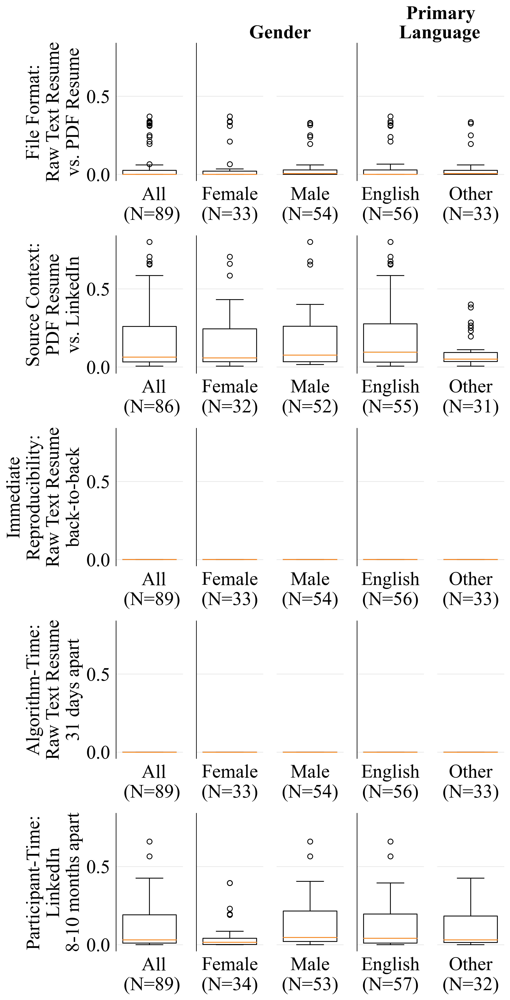

In [49]:
l1_boxplots(vendor='crystal', score_group_string='DISC',
            experiments = list(c_results.keys()),
            gender=True, race=False, country=False, lang=True)

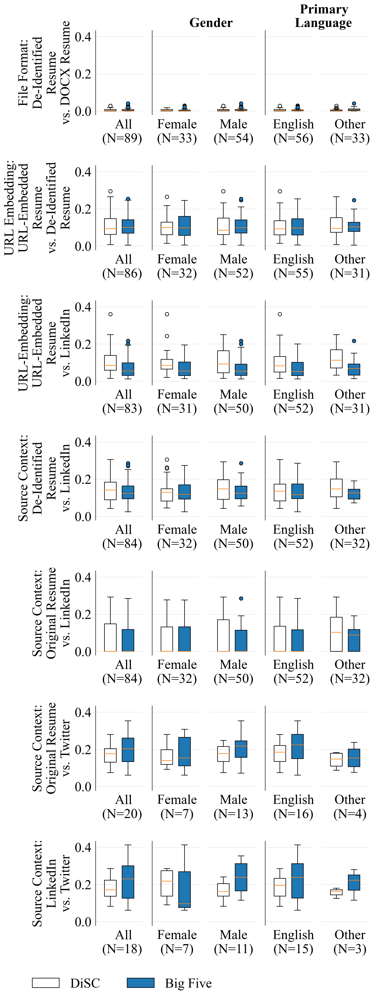

(-0.020640000000000002, 0.43344)
(array([0. , 0.2, 0.4, 0.6, 0.8, 1. ]), [Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, '')])


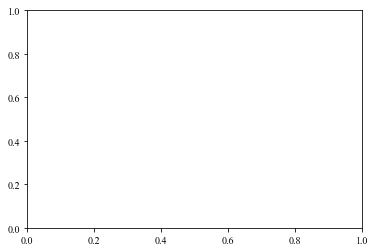

In [50]:
l1_boxplots(vendor='humantic', score_group_string='all',
           experiments = list(h_results.keys())[:7],
           gender=True, race=False, country=False, lang=True,
           legend_bbox = (0.2, 0.06), print_y_axis=True)

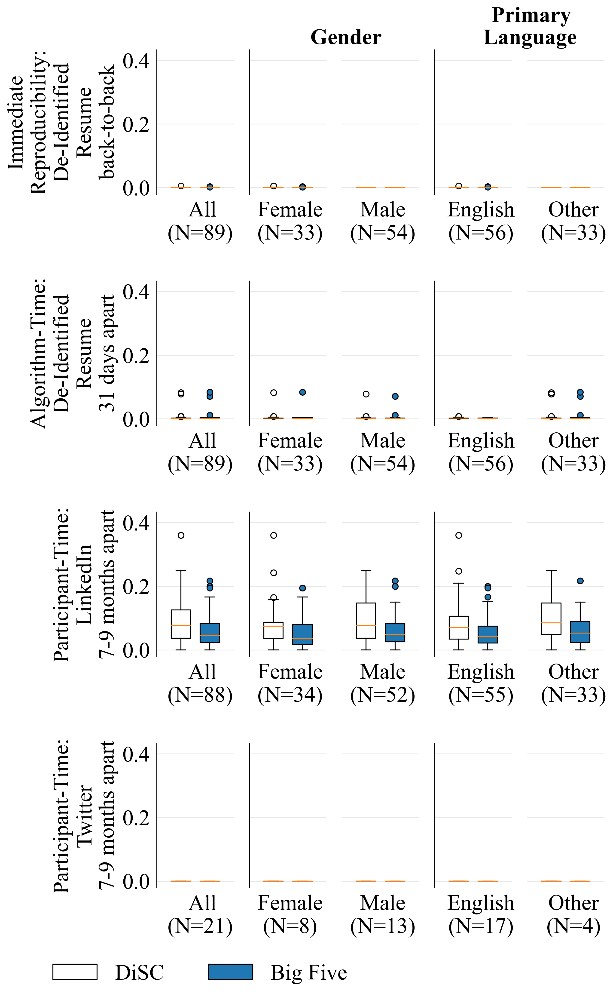

In [51]:
l1_boxplots(vendor='humantic', score_group_string='all',
            experiments = list(h_results.keys())[7:],
            gender=True, race=False, country=False, lang=True,
            legend_bbox = (0.2, 0.02),
            ylim = (-0.020640000000000002, 0.43344),
            yticks = [0, 0.2, 0.4])

## Individual facet boxplots

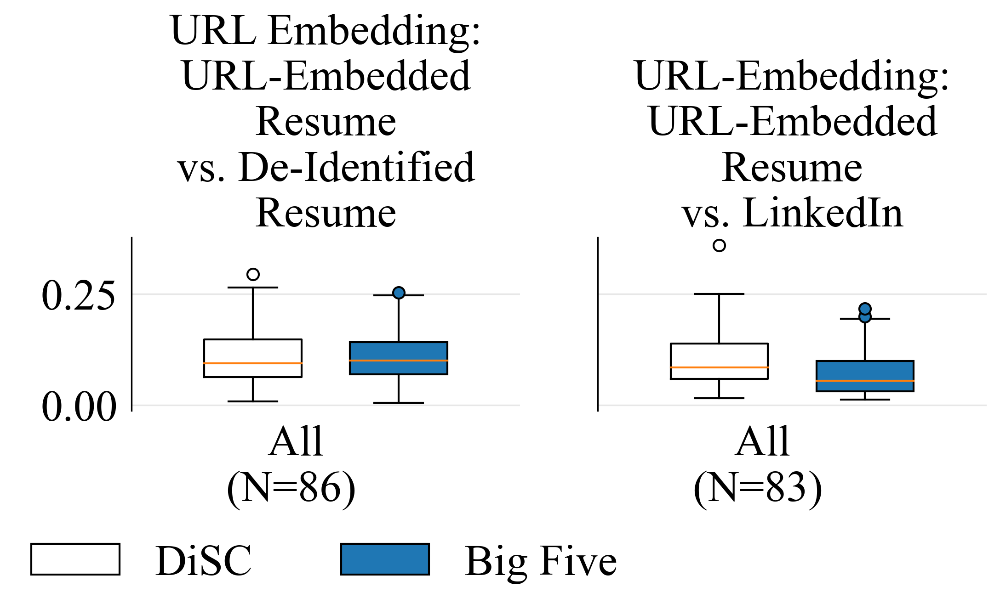

In [52]:
l1_boxplots(vendor='humantic', score_group_string='all',
           experiments = ['URL Embedding: URL-Embedded Resume vs. De-Identified Resume', 
                          'URL-Embedding: URL-Embedded Resume vs. LinkedIn'],
            gender=False, race=False, country=False, lang=False,
           legend_bbox = (0.3, -0.8), horiz=True)

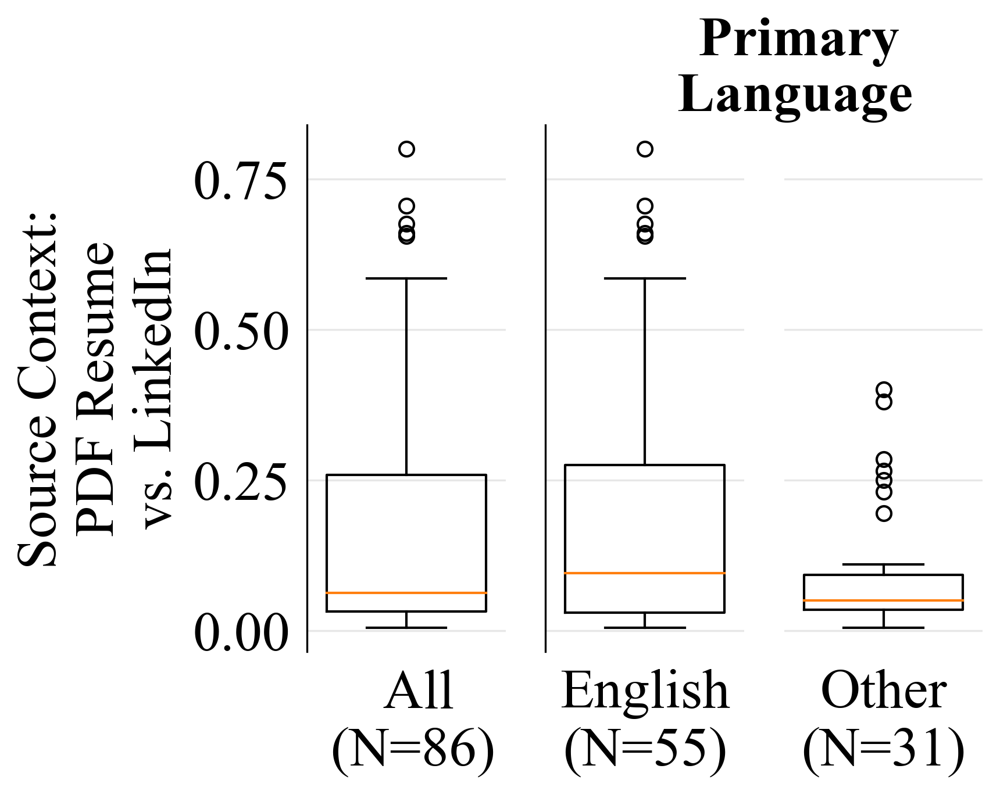

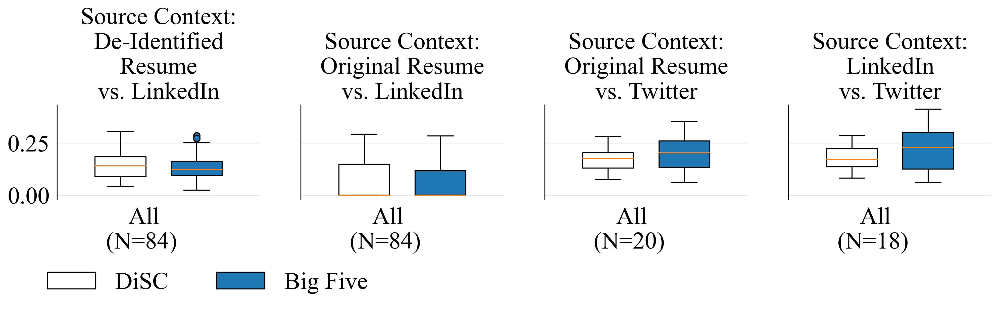

In [53]:
l1_boxplots(vendor='crystal', score_group_string='DISC', 
           experiments = [x for x in c_results.keys() if 'Source Context' in x],
               gender=False, race=False, country=False, lang=True)

l1_boxplots(vendor='humantic', score_group_string='all', 
           experiments = [x for x in h_results.keys() if ('Source Context' in x) & ('URL' not in x)],
               gender=False, race=False, country=False, lang=False,
               legend_bbox = (0.25, -0.8),
           horiz=True)

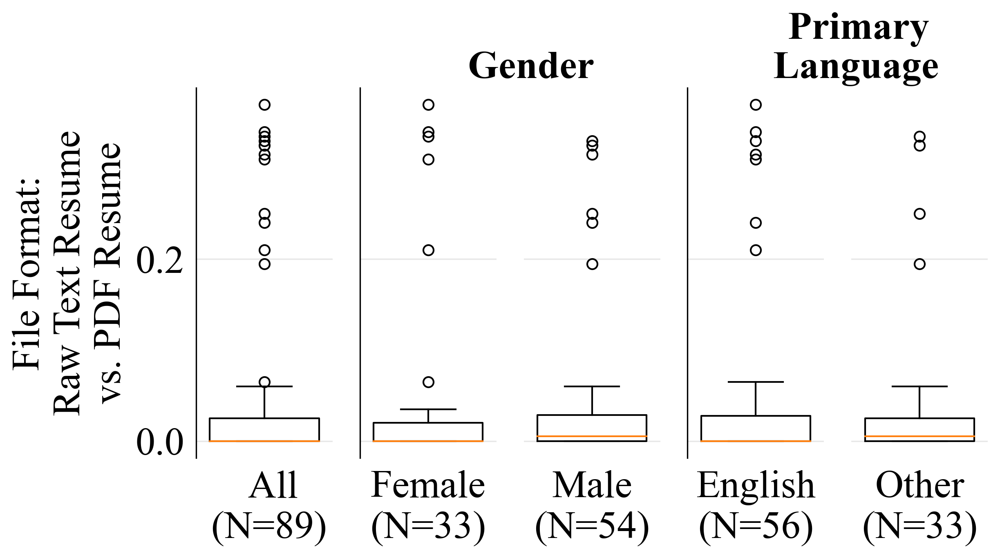

In [54]:
l1_boxplots(vendor='crystal', score_group_string='DISC',
           experiments = [x for x in c_results.keys() if 'File Format' in x],
            gender=True, race=False, country=False, lang=True,
           legend_bbox = (0.3, -0.8))

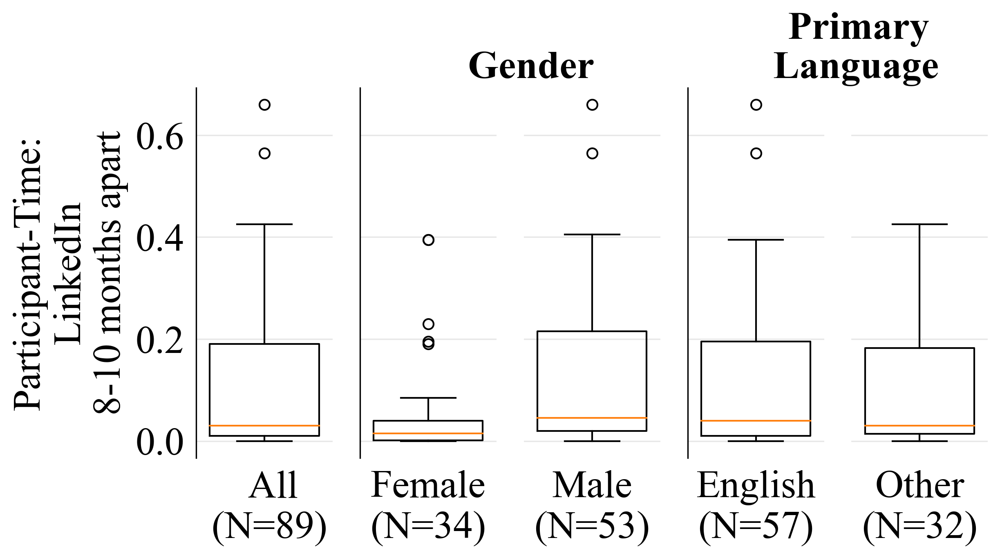

In [55]:
l1_boxplots(vendor='crystal', score_group_string='DISC', 
           experiments = [x for x in c_results.keys() if 'Participant-Time' in x],
               gender=True, race=False, country=False, lang=True)